In [1]:
# This is the import cell
import sys
import os
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.lines import Line2D
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from mpl_toolkits.axes_grid1.inset_locator import (inset_axes, InsetPosition,
                                                  mark_inset)
import matplotlib.ticker as ticker
from collections import OrderedDict
from scipy import stats
from PIL import Image
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import pylab as plot
first = True
pd.set_option('display.max_columns', None)
pd.set_option("display.max_rows", 10)



# Here are my rc parameters for matplotlibf
fsize = 20
mpl.rc('font', serif='Helvetica Neue')
#mpl.rc('font', serif='Times New Roman')
mpl.rcParams.update({'font.size': fsize})
mpl.rcParams['figure.figsize'] = 3.2, 2.8
mpl.rcParams['figure.dpi'] = 500
mpl.rcParams['xtick.direction'] = 'in'
mpl.rcParams['ytick.direction'] = 'in'
mpl.rcParams['lines.linewidth'] = 1.5
mpl.rcParams['axes.linewidth'] = 1.5
# Set x tick params
mpl.rcParams['xtick.major.size'] = 4.5
mpl.rcParams['xtick.major.width'] = 1.5
mpl.rcParams['xtick.minor.size'] = 3.
mpl.rcParams['xtick.minor.width'] = 1.25
# Set y tick params
mpl.rcParams['ytick.major.size'] = 4.5
mpl.rcParams['ytick.major.width'] = 1.5
mpl.rcParams['ytick.minor.size'] = 3.
mpl.rcParams['ytick.minor.width'] = 1.25
mpl.rcParams['legend.fontsize']= 20.
mpl.rcParams['mathtext.fontset'] = 'stix'
mpl.rcParams["font.family"] = "Times New Roman"
# Load LaTeX and amsmath
# mpl.rc('text', usetex=True)
# mpl.rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]

In [2]:
# Get the current path
if first:
    parent = os.getcwd()
print(parent)
# Grab file names from data folder
dens = os.listdir('./dif_box_sizes_txt/domain')

try:
    dens.remove('.DS_Store')
except:
    print(".DS_Store not in directory")

# Grab file names from data folder
pres = os.listdir('./dif_box_sizes_txt/neighbor')

try:
    pres.remove('.DS_Store')
except:
    print(".DS_Store not in directory")
    
# Grab file names from data folder
pres3 = os.listdir('./dif_box_sizes_txt/PhaseComp')

try:
    pres3.remove('.DS_Store')
except:
    print(".DS_Store not in directory")
    
# Grab file names from data folder
pres6 = os.listdir('./dif_box_sizes_txt/PhaseComp_bins')

try:
    pres6.remove('.DS_Store')
except:
    print(".DS_Store not in directory")

C:\Users\Nick\Desktop\jupyter_analysis_updated
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory


In [3]:
# Some functions to get the relevant data from the filenames
def checkFile(fname, string):
    for i in range(len(fname)):
        if fname[i] == string[0]:
#             print"{} matches {}".format(fname[i], string[0])
            for j in range(1, len(string)):
                if (i + j) > (len(fname) - 1):
                    break
                elif fname[i + j] == string[j]:
#                     print"{} matches {}".format(fname[i+j], string[j])
                    if j == (len(string) - 1):
#                         print"Final match!"
                        return True
                else:
                    break
    return False
    
def txtValue(fname, string):
    out = ""
    index = 0
    for i in range(len(fname)):
        if fname[i] == string[0]:
            for j in range(1, len(string)):
                if (i + j) > (len(fname) - 1):
                    break
                elif fname[i + j] == string[j]:
                    if j == (len(string) - 1):
                        # Last index of search string
                        index = i + j
                else:
                    break
                        
    # First index of value
    index += 1
    mybool = True
    while mybool:
        if fname[index].isdigit():
            out = out + fname[index]
            index += 1
        elif fname[index] == ".":    
            if fname[index+1].isdigit():
                out = out + fname[index]
                index += 1
            else:
                mybool = False
        else:
            mybool = False
    return float(out)

# Sorting functions
def multiSort(arr1, arr2, arr3, arr4):
    """Sort an array the slow (but certain) way, returns original indices in sorted order"""
    # Doing this for PeR, PeS, xS in this case
    cpy1 = np.copy(arr1)
    cpy2 = np.copy(arr2)
    cpy3 = np.copy(arr3)
    cpy4 = np.copy(arr4)
    ind = np.arange(0, len(arr1))
    for i in range(len(cpy1)):
        for j in range(len(cpy1)):
            # Sort by first variable
            if cpy1[i] > cpy1[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
                
            # If first variable is equal, resort to second variable
            elif cpy1[i] == cpy1[j] and cpy2[i] > cpy2[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
                
            elif cpy1[i] == cpy1[j] and cpy2[i] == cpy2[j] and cpy3[i] > cpy3[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
            elif cpy1[i] == cpy1[j] and cpy2[i] == cpy2[j] and cpy3[i] == cpy3[j] and cpy4[i] > cpy4[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
    return ind

def indSort(arr1, arr2):
    """Take sorted index array, use to sort array"""
    # arr1 is array to sort
    # arr2 is index array
    cpy = np.copy(arr1)
    for i in range(len(arr1)):
        arr1[i] = cpy[arr2[i]]

In [4]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "pNum", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in dens:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("pNum")],
                       storeVals[chkStrings.index("cluster")])
    indSort(dens, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_dens = []
os.chdir(parent)
os.chdir('./dif_box_sizes_txt/domain')
for i in dens:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_dens.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_dens[0])

,tauB,sizeBin_x,sizeBin_y,clust_size,A_pop,A_avg_size,A_std_size,A_num,A_first_size,A_second_size,A_third_size,A_fourth_size,A_fifth_size,A_one_num,A_two_num,A_three_num,A_fourth_num,B_pop,B_avg_size,B_std_size,B_num,B_first,B_second,B_third,B_fourth,B_fifth,B_one_num,B_two_num,B_three_num,B_fourth_num
0,0.0,5.053686,5.053686,42434,21381,22.794243,319.120943,938,9059,3244,1219,897,645,500,126,73,41,21316,21.553084,248.488044,989,5883,4492,1700,1542,813,515,154,66,54
1,0.6,5.053686,5.053686,40206,21148,12.210162,214.537816,1732,8549,2010,1224,787,550,949,280,127,70,21348,17.327922,284.859434,1232,7082,6679,1700,1542,289,764,197,89,45
2,1.2,5.053686,5.053686,35869,19015,10.947035,184.581172,1737,7360,1961,564,541,531,960,233,157,75,19560,14.329670,364.705382,1365,13365,1698,354,235,202,881,233,79,43
3,1.8,5.053686,5.053686,32645,16512,11.702339,148.007530,1411,4273,3448,553,369,367,684,237,124,73,17818,14.450933,390.235794,1233,13697,464,274,225,208,745,224,71,74
4,2.4,5.053686,5.053686,32078,16543,8.042295,122.535912,2057,5447,539,405,396,381,1297,285,126,61,18289,9.340654,315.917444,1958,13977,437,100,95,45,1321,335,119,57
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26,15.6,5.053686,5.053686,16130,5173,4.063629,16.720235,1273,290,268,216,206,103,746,202,103,59,11689,20.328696,436.834496,575,10486,23,19,15,14,354,97,37,29
27,16.2,5.053686,5.053686,17428,5333,4.064787,16.500912,1312,420,242,154,133,118,772,213,85,56,12277,19.123053,429.820729,642,10901,58,27,24,17,398,118,44,22
28,16.8,5.053686,5.053686,16964,5260,3.910781,22.388182,1345,755,162,141,108,106,806,216,78,52,11671,14.848601,339.005924,786,9511,152,60,52,48,460,137,65,41
29,17.4,5.053686,5.053686,6834,4559,3.332602,8.949651,1368,192,172,72,64,63,795,235,95,42,8167,6.607605,141.387749,1236,4971,117,116,55,42,726,221,93,69


In [5]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'pNum', 'phi', 'tauPer_dt']
params = pd.DataFrame(columns=headers)
for i in range(0, len(all_dens)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("pNum")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params = params.append(df, ignore_index = True)
display(params)

C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\2388653896.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params = params.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\2388653896.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params = params.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\2388653896.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params = params.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\2388653896.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params = params.append(df, ignore_index = True)


,pe,peA,peB,xA,pNum,phi,tauPer_dt
0,0,0,500,50.0,50000.0,40.0,0.000001
1,0,0,300,50.0,100000.0,40.0,0.000001
2,0,0,500,50.0,100000.0,40.0,0.000001
3,0,0,200,50.0,100000.0,40.0,0.000001
4,0,0,500,50.0,150000.0,40.0,0.000001
...,...,...,...,...,...,...,...
35,0,50,500,50.0,200000.0,50.0,0.000001
36,0,50,500,50.0,50000.0,65.0,0.000001
37,0,50,500,50.0,100000.0,65.0,0.000001
38,0,50,500,50.0,150000.0,65.0,0.000001


In [6]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_dens)):
    # Ger rid of NaN in favor of 0
    all_dens[i].fillna(0, inplace=True)

headers=list(all_dens[0])
display(all_dens[0])
print(all_dens[0][headers[1]][0])
print(all_dens[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,A_pop,A_avg_size,A_std_size,A_num,A_first_size,A_second_size,A_third_size,A_fourth_size,A_fifth_size,A_one_num,A_two_num,A_three_num,A_fourth_num,B_pop,B_avg_size,B_std_size,B_num,B_first,B_second,B_third,B_fourth,B_fifth,B_one_num,B_two_num,B_three_num,B_fourth_num
0,0.0,5.053686,5.053686,42434,21381,22.794243,319.120943,938,9059,3244,1219,897,645,500,126,73,41,21316,21.553084,248.488044,989,5883,4492,1700,1542,813,515,154,66,54
1,0.6,5.053686,5.053686,40206,21148,12.210162,214.537816,1732,8549,2010,1224,787,550,949,280,127,70,21348,17.327922,284.859434,1232,7082,6679,1700,1542,289,764,197,89,45
2,1.2,5.053686,5.053686,35869,19015,10.947035,184.581172,1737,7360,1961,564,541,531,960,233,157,75,19560,14.329670,364.705382,1365,13365,1698,354,235,202,881,233,79,43
3,1.8,5.053686,5.053686,32645,16512,11.702339,148.007530,1411,4273,3448,553,369,367,684,237,124,73,17818,14.450933,390.235794,1233,13697,464,274,225,208,745,224,71,74
4,2.4,5.053686,5.053686,32078,16543,8.042295,122.535912,2057,5447,539,405,396,381,1297,285,126,61,18289,9.340654,315.917444,1958,13977,437,100,95,45,1321,335,119,57
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26,15.6,5.053686,5.053686,16130,5173,4.063629,16.720235,1273,290,268,216,206,103,746,202,103,59,11689,20.328696,436.834496,575,10486,23,19,15,14,354,97,37,29
27,16.2,5.053686,5.053686,17428,5333,4.064787,16.500912,1312,420,242,154,133,118,772,213,85,56,12277,19.123053,429.820729,642,10901,58,27,24,17,398,118,44,22
28,16.8,5.053686,5.053686,16964,5260,3.910781,22.388182,1345,755,162,141,108,106,806,216,78,52,11671,14.848601,339.005924,786,9511,152,60,52,48,460,137,65,41
29,17.4,5.053686,5.053686,6834,4559,3.332602,8.949651,1368,192,172,72,64,63,795,235,95,42,8167,6.607605,141.387749,1236,4971,117,116,55,42,726,221,93,69


5.053686
5.053686


In [7]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "pNum", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("pNum")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres = []
os.chdir(parent)
os.chdir('./dif_box_sizes_txt/neighbor')
for i in pres:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres[-1])

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk_all-all_mean,bulk_all-all_std,bulk_all-A_mean,bulk_all-A_std,bulk_all-B_mean,bulk_all-B_std,bulk_A-A_mean,bulk_A-A_std,bulk_A-B_mean,bulk_A-B_std,bulk_B-B_mean,bulk_B-B_std,int_all-all_mean,int_all-all_std,int_all-A_mean,int_all-A_std,int_all-B_mean,int_all-B_std,int_A-A_mean,int_A-A_std,int_A-B_mean,int_A-B_std,int_B-B_mean,int_B-B_std,dense_all-all_mean,dense_all-all_std,dense_all-A_mean,dense_all-A_std,dense_all-B_mean,dense_all-B_std,dense_A-A_mean,dense_A-A_std,dense_A-B_mean,dense_A-B_std,dense_B-B_mean,dense_B-B_std
0,0.0,5.016227,5.016227,185981,6.000000,0.000000,6.000000,0.000000,6.000000,0.000000,2.989809,1.229012,3.001154,1.217721,2.998846,1.217721,5.875130,0.675762,5.872040,0.687694,5.878176,0.663775,2.916906,1.259531,2.914648,1.259551,2.963528,1.261270,5.957355,0.399324,5.956464,0.405682,5.958240,0.392905,2.965006,1.239961,2.971501,1.232904,2.986739,1.232936
1,0.6,5.016227,5.016227,183238,6.000791,0.033712,6.000754,0.033855,6.000827,0.033568,2.988065,1.226607,3.001082,1.218579,2.999744,1.218820,5.627537,1.096027,5.473655,1.320366,5.770343,0.809834,2.756158,1.317209,2.523154,1.402823,3.247189,1.449539,5.895576,0.606331,5.856005,0.731391,5.934221,0.448598,2.924379,1.256412,2.862970,1.292842,3.071251,1.294609
2,1.2,5.016227,5.016227,177740,6.000583,0.054664,6.000584,0.053763,6.000582,0.055548,2.990554,1.225376,2.999127,1.218692,3.001456,1.218775,4.946780,1.846033,4.567033,2.061513,5.320282,1.516030,2.360226,1.458422,2.177067,1.453871,3.143215,1.710524,5.729479,1.044567,5.633651,1.217095,5.824687,0.827805,2.829215,1.318068,2.786578,1.333143,3.038108,1.364445
3,1.8,5.016227,5.016227,171770,6.000438,0.074781,6.000590,0.070986,6.000287,0.078383,2.992993,1.225040,2.998958,1.220203,3.001328,1.220172,5.065724,1.666155,4.653411,1.913190,5.440714,1.294859,2.437897,1.413544,2.018530,1.450734,3.422184,1.738370,5.763508,0.934440,5.671033,1.111116,5.853620,0.710320,2.857202,1.295891,2.741983,1.355062,3.111637,1.387412
4,2.4,5.016227,5.016227,167707,6.000893,0.083645,6.001309,0.083606,6.000477,0.083681,2.993711,1.225335,2.999188,1.220155,3.001289,1.219842,5.042748,1.676959,4.593362,1.920062,5.429092,1.318155,2.387903,1.405208,1.895153,1.443327,3.533939,1.783248,5.733813,0.986662,5.630255,1.166824,5.832895,0.763036,2.834054,1.302833,2.675384,1.384109,3.157511,1.429356
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
994,596.4,5.016227,5.016227,120064,6.004043,0.085067,6.003876,0.077770,6.004143,0.089166,2.700914,1.477810,1.984283,1.415020,4.019860,1.415982,5.203485,1.456231,4.425971,1.785995,5.601293,1.051678,2.222358,1.458006,1.130551,1.231895,4.470742,1.714851,5.722931,0.946235,5.486505,1.264372,5.857356,0.667566,2.544003,1.488398,1.673208,1.412258,4.184148,1.546943
995,597.0,5.016227,5.016227,120549,6.003923,0.083523,6.004009,0.079696,6.003872,0.085721,2.695034,1.475372,1.971691,1.415752,4.032181,1.417192,5.216079,1.457628,4.428019,1.806162,5.618975,1.031155,2.221044,1.457272,1.125622,1.235071,4.493352,1.707832,5.721935,0.952679,5.475011,1.285721,5.861273,0.658110,2.535934,1.486272,1.658234,1.412041,4.203039,1.547428
996,597.6,5.016227,5.016227,120729,6.002831,0.082073,6.003578,0.075535,6.002395,0.085648,2.683353,1.478948,1.933519,1.420115,4.068876,1.421365,5.261395,1.397545,4.528732,1.740803,5.635784,0.994074,2.316570,1.492994,1.130446,1.244906,4.505339,1.690760,5.748395,0.893634,5.525180,1.209763,5.872749,0.620419,2.564379,1.493423,1.649524,1.413866,4.223225,1.536329
997,598.2,5.016227,5.016227,119657,6.002568,0.083533,6.003299,0.082805,6.002141,0.083953,2.680256,1.481196,1.939689,1.415289,4.062452,1.416368,5.265029,1.403612,4.512096,1.767358,5.641854,0.983436,2.254008,1.481402,1.129976,1.236435,4.511878,1.682349,5.747430,0.899540,5.520546,1.225834,5.873077,0.617108,2.542265,1.494629,1.649629,1.408502,4.223448,1.532248


In [8]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'pNum', 'phi', 'tauPer_dt']
params2 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("pNum")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params2 = params2.append(df, ignore_index = True)
display(params2)

C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\2997566370.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params2 = params2.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\2997566370.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params2 = params2.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\2997566370.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params2 = params2.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\2997566370.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params2 = params2.append(df, ignore_index 

,pe,peA,peB,xA,pNum,phi,tauPer_dt
0,0,0,500,50.0,50000.0,40.0,0.000001
1,0,0,300,50.0,100000.0,40.0,0.000001
2,0,0,500,50.0,100000.0,40.0,0.000001
3,0,0,200,50.0,100000.0,40.0,0.000001
4,0,0,500,50.0,150000.0,40.0,0.000001
...,...,...,...,...,...,...,...
35,0,50,500,50.0,200000.0,50.0,0.000001
36,0,50,500,50.0,50000.0,65.0,0.000001
37,0,50,500,50.0,100000.0,65.0,0.000001
38,0,50,500,50.0,150000.0,65.0,0.000001


In [9]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres)):
    # Ger rid of NaN in favor of 0
    all_pres[i].fillna(0, inplace=True)

headers=list(all_pres[0])
display(all_pres[0])
print(all_pres[0][headers[1]][0])
print(all_pres[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk_all-all_mean,bulk_all-all_std,bulk_all-A_mean,bulk_all-A_std,bulk_all-B_mean,bulk_all-B_std,bulk_A-A_mean,bulk_A-A_std,bulk_A-B_mean,bulk_A-B_std,bulk_B-B_mean,bulk_B-B_std,int_all-all_mean,int_all-all_std,int_all-A_mean,int_all-A_std,int_all-B_mean,int_all-B_std,int_A-A_mean,int_A-A_std,int_A-B_mean,int_A-B_std,int_B-B_mean,int_B-B_std,dense_all-all_mean,dense_all-all_std,dense_all-A_mean,dense_all-A_std,dense_all-B_mean,dense_all-B_std,dense_A-A_mean,dense_A-A_std,dense_A-B_mean,dense_A-B_std,dense_B-B_mean,dense_B-B_std
0,0.0,5.053686,5.053686,42434,6.000000,0.000000,6.000000,0.000000,6.000000,0.000000,3.005884,1.224052,2.959060,1.247729,3.040940,1.247729,5.860995,0.712216,5.859608,0.711042,5.862398,0.713398,2.942560,1.259626,2.951422,1.259406,2.910977,1.258381,5.912215,0.569946,5.910945,0.570331,5.913488,0.569557,2.965716,1.247108,2.954258,1.255089,2.959231,1.256007
1,0.6,5.053686,5.053686,40206,6.000340,0.023788,6.000568,0.028203,6.000113,0.018388,3.011936,1.233358,2.964946,1.244379,3.035167,1.244149,5.332864,1.508700,5.083212,1.763719,5.580139,1.151832,2.597673,1.359764,2.460511,1.455943,3.119629,1.513064,5.610074,1.199698,5.464321,1.422351,5.754504,0.904906,2.769776,1.324560,2.669942,1.394404,3.084562,1.408281
2,1.2,5.053686,5.053686,35869,6.000165,0.069893,5.999119,0.074201,6.001204,0.065314,3.006718,1.226568,2.972754,1.248885,3.028450,1.247499,4.966804,1.738083,4.635574,1.916286,5.288026,1.476418,2.433009,1.361929,2.135641,1.489826,3.152385,1.720149,5.446150,1.373841,5.272227,1.556578,5.616723,1.141709,2.700879,1.331608,2.521458,1.445535,3.095265,1.521925
3,1.8,5.053686,5.053686,32645,6.002865,0.088810,6.002937,0.084411,6.002792,0.092994,3.025038,1.224689,2.972777,1.244824,3.030015,1.244311,4.995468,1.652719,4.660696,1.815496,5.294070,1.427867,2.475713,1.360481,1.947739,1.497621,3.346331,1.821042,5.404219,1.367875,5.224121,1.534362,5.572360,1.166798,2.706300,1.333060,2.350236,1.490373,3.222125,1.626613
4,2.4,5.053686,5.053686,32078,6.002992,0.080171,6.003239,0.078146,6.002741,0.082176,3.048759,1.218027,2.999452,1.250982,3.003289,1.251926,4.878120,1.758864,4.521907,1.867385,5.187393,1.595657,2.463518,1.411474,1.785815,1.481772,3.401578,1.913218,5.233175,1.546769,5.015714,1.677606,5.431573,1.387479,2.658610,1.377972,2.149275,1.521767,3.282298,1.751241
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
994,596.4,5.053686,5.053686,126,1.995800,1.259342,1.841320,1.273758,2.150280,1.225437,0.766240,0.804336,1.075080,0.850837,1.075200,0.992303,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
995,597.0,5.053686,5.053686,94,1.994400,1.261257,1.850520,1.273333,2.138280,1.232379,0.781280,0.815893,1.069240,0.853022,1.069040,0.993798,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
996,597.6,5.053686,5.053686,96,2.005520,1.267742,1.857560,1.284053,2.153480,1.233598,0.778400,0.817566,1.079160,0.856559,1.074320,0.994101,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
997,598.2,5.053686,5.053686,111,1.998640,1.263360,1.852360,1.280782,2.144920,1.228397,0.776400,0.817657,1.075960,0.856942,1.068960,0.990982,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


5.053686
5.053686


In [10]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "pNum", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres3:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("pNum")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres3, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new2 = []
os.chdir(parent)
os.chdir('./dif_box_sizes_txt/PhaseComp')
for i in pres3:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new2.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new2[-1])
print(storeVals)

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk_all,bulk_A,bulk_B,largest_bulk_all,largest_bulk_A,largest_bulk_B,int_all,int_A,int_B,largest_int_all,largest_int_A,largest_int_B,gas_all,gas_A,gas_B
0,0.0,5.016227,5.016227,185981,122835,61331,61504,122835,61331,61504,63706,31627,32079,63706,31627,32079,13459,7042,6417
1,0.6,5.016227,5.016227,183238,132794,66274,66520,132794,66274,66520,52126,25090,27036,52126,25090,27036,15080,8636,6444
2,1.2,5.016227,5.016227,177740,137194,68494,68700,137194,68494,68700,47520,23563,23957,104,47,57,15286,7943,7343
3,1.8,5.016227,5.016227,171770,132323,66080,66243,132323,66080,66243,44930,21400,23530,109,64,45,22747,12520,10227
4,2.4,5.016227,5.016227,167707,125478,62646,62832,125478,62646,62832,48494,22418,26076,103,71,32,26028,14936,11092
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
994,596.4,5.016227,5.016227,120064,80384,30182,50202,80384,30182,50202,43502,14724,28778,43502,14724,28778,76114,55094,21020
995,597.0,5.016227,5.016227,120549,79525,29682,49843,79525,29682,49843,44331,14997,29334,44331,14997,29334,76144,55321,20823
996,597.6,5.016227,5.016227,120729,81257,29904,51353,81257,29904,51353,42453,14357,28096,42453,14357,28096,76290,55739,20551
997,598.2,5.016227,5.016227,119657,80608,29705,50903,80608,29705,50903,42633,14220,28413,42633,14220,28413,76759,56075,20684


[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0], [500.0, 300.0, 500.0, 200.0, 500.0, 500.0, 500.0, 300.0, 500.0, 200.0, 500.0, 500.0, 500.0, 300.0, 500.0, 200.0, 500.0, 500.0, 500.0, 300.0, 500.0, 200.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0], [50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0], [50000.0, 100000.0, 100000.0, 100000.0, 150000.0, 20000

In [11]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'pNum', 'phi', 'tauPer_dt']
params4 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new2)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("pNum")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params4 = params4.append(df, ignore_index = True)
display(params4)

C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\1986856036.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params4 = params4.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\1986856036.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params4 = params4.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\1986856036.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params4 = params4.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\1986856036.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params4 = params4.append(df, ignore_index 

,pe,peA,peB,xA,pNum,phi,tauPer_dt
0,0,0,500,50.0,50000.0,40.0,0.000001
1,0,0,300,50.0,100000.0,40.0,0.000001
2,0,0,500,50.0,100000.0,40.0,0.000001
3,0,0,200,50.0,100000.0,40.0,0.000001
4,0,0,500,50.0,150000.0,40.0,0.000001
...,...,...,...,...,...,...,...
35,0,50,500,50.0,200000.0,50.0,0.000001
36,0,50,500,50.0,50000.0,65.0,0.000001
37,0,50,500,50.0,100000.0,65.0,0.000001
38,0,50,500,50.0,150000.0,65.0,0.000001


In [12]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new2)):
    # Ger rid of NaN in favor of 0
    all_pres_new2[i].fillna(0, inplace=True)

headers=list(all_pres_new2[0])
display(all_pres_new2[0])
print(all_pres_new2[0][headers[1]][0])
print(all_pres_new2[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk_all,bulk_A,bulk_B,largest_bulk_all,largest_bulk_A,largest_bulk_B,int_all,int_A,int_B,largest_int_all,largest_int_A,largest_int_B,gas_all,gas_A,gas_B
0,0.0,5.053686,5.053686,42434,15732,7818,7914,15732,7818,7914,26963,13562,13401,26963,13562,13401,7305,3620,3685
1,0.6,5.053686,5.053686,40206,17669,8797,8872,17669,8797,8872,24875,12378,12497,104,50,54,7456,3825,3631
2,1.2,5.053686,5.053686,35869,18219,9080,9139,18219,9080,9139,21057,10367,10690,143,54,89,10724,5553,5171
3,1.8,5.053686,5.053686,32645,14312,7149,7163,14312,7149,7163,20961,9882,11079,118,43,75,14727,7969,6758
4,2.4,5.053686,5.053686,32078,11031,5558,5473,11031,5558,5473,23917,11115,12802,101,74,27,15052,8327,6725
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26,15.6,5.053686,5.053686,16130,1944,416,1528,1944,416,1528,14601,4515,10086,14601,4515,10086,33455,20069,13386
27,16.2,5.053686,5.053686,17428,1017,264,753,1017,264,753,16827,5215,11612,103,37,66,32156,19521,12635
28,16.8,5.053686,5.053686,16964,180,44,136,180,44,136,16569,5088,11481,115,53,62,33251,19868,13383
29,17.4,5.053686,5.053686,6834,0,0,0,0,0,0,12379,4398,7981,205,108,97,37621,20602,17019


5.053686
5.053686


In [13]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "pNum", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres6:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("pNum")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres6, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new5 = []
os.chdir(parent)
os.chdir('./dif_box_sizes_txt/PhaseComp_bins')
for i in pres6:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new5.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new5[-1])
print(storeVals)

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk,largest_int,gas,int
0,0.0,5.016227,5.016227,185981,2666,1694,5244,1694
1,0.6,5.016227,5.016227,183238,2550,1352,5702,1352
2,1.2,5.016227,5.016227,177740,2818,32,4691,2095
3,1.8,5.016227,5.016227,171770,2764,18,5221,1619
4,2.4,5.016227,5.016227,167707,2611,14,5247,1746
...,...,...,...,...,...,...,...,...
994,596.4,5.016227,5.016227,120064,1606,1299,6699,1299
995,597.0,5.016227,5.016227,120549,1588,1323,6693,1323
996,597.6,5.016227,5.016227,120729,1627,1243,6734,1243
997,598.2,5.016227,5.016227,119657,1625,1250,6729,1250


[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0], [500.0, 300.0, 500.0, 200.0, 500.0, 500.0, 500.0, 300.0, 500.0, 200.0, 500.0, 500.0, 500.0, 300.0, 500.0, 200.0, 500.0, 500.0, 500.0, 300.0, 500.0, 200.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0, 500.0], [50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0], [50000.0, 100000.0, 100000.0, 100000.0, 150000.0, 20000

In [14]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'pNum', 'phi', 'tauPer_dt']
params7 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new5)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("pNum")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params7 = params7.append(df, ignore_index = True)
display(params7)

C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\1454588813.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params7 = params7.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\1454588813.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params7 = params7.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\1454588813.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params7 = params7.append(df, ignore_index = True)
C:\Users\Nick\AppData\Local\Temp\ipykernel_24044\1454588813.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params7 = params7.append(df, ignore_index 

,pe,peA,peB,xA,pNum,phi,tauPer_dt
0,0,0,500,50.0,50000.0,40.0,0.000001
1,0,0,300,50.0,100000.0,40.0,0.000001
2,0,0,500,50.0,100000.0,40.0,0.000001
3,0,0,200,50.0,100000.0,40.0,0.000001
4,0,0,500,50.0,150000.0,40.0,0.000001
...,...,...,...,...,...,...,...
35,0,50,500,50.0,200000.0,50.0,0.000001
36,0,50,500,50.0,50000.0,65.0,0.000001
37,0,50,500,50.0,100000.0,65.0,0.000001
38,0,50,500,50.0,150000.0,65.0,0.000001


In [15]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new5)):
    # Ger rid of NaN in favor of 0
    all_pres_new5[i].fillna(0, inplace=True)

headers=list(all_pres_new5[0])
display(all_pres_new5[0])
print(all_pres_new5[0][headers[1]][0])
print(all_pres_new5[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk,largest_int,gas,int
0,0.0,5.053686,5.053686,42434,336,721,2787,721
1,0.6,5.053686,5.053686,40206,344,32,2729,771
2,1.2,5.053686,5.053686,35869,375,42,2681,788
3,1.8,5.053686,5.053686,32645,291,34,2793,760
4,2.4,5.053686,5.053686,32078,220,11,2642,982
...,...,...,...,...,...,...,...,...
26,15.6,5.053686,5.053686,16130,38,404,3402,404
27,16.2,5.053686,5.053686,17428,20,19,3329,495
28,16.8,5.053686,5.053686,16964,4,18,3332,508
29,17.4,5.053686,5.053686,6834,0,17,3380,464


5.053686
5.053686


In [16]:
# All data is loaded, now compute analytical aspects
r_cut = (2.**(1./6.))

# Get lattice spacing for particle size
def ljForce(r, eps, sigma=1.):
    div = (sigma/r)
    dU = (24. * eps / sigma) * ((2*(div**13)) - (div)**7)
    return dU

# # Lennard-Jones pressure
# def ljPress(r, eps, sigma=1.):
#     phiCP = np.pi / (2. * np.sqrt(3.))
#     div = (sigma/r)
#     dU = (24. * eps / r) * ((2.*(div**12.)) - (div)**6.)
#     # This is just pressure divided by the area of a particle
# #     return (12. * dU / (np.pi * r))
#     return (12. * dU / (np.pi * r * phiCP))

def ljPress(r, pe, eps, sigma=1.):
    phiCP = np.pi / (2. * np.sqrt(3.))
    # This is off by a factor of 1.2...
    ljF = avgCollisionForce(pe)
    return (2. *np.sqrt(3) * ljF / r)
    
def avgCollisionForce(pe, power=1.):
    '''Computed from the integral of possible angles'''
    peCritical = 40.
    if pe < peCritical:
        pe = 0
    else:
        pe -= peCritical
    magnitude = 6.
    # A vector sum of the six nearest neighbors
    magnitude = np.sqrt(28)
#     return (magnitude * (pe**power)) / (np.pi)
#     return (pe * (1. + (8./(np.pi**2.))))
    coeff = 1.92#2.03#3.5#2.03
    #coeff= 0.4053
    return (pe * coeff)

def fStar(pe, epsilon, sigma=1.):
    out = (avgCollisionForce(pe) * sigma) / (24.*epsilon)
    return out
    
def conForRClust(pe, eps):
    out = []
    r = 1.112
    skip = [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001, 0.0000001, 0.00000001]
    for j in skip:
        while ljForce(r, eps) < avgCollisionForce(pe):
            r -= j
        r += j
    out = r
    return out

def nonDimFLJ(r, sigma=1.):
    div = (sigma/r)
    dU = ((2*(div**13)) - (div)**7)
    return dU

def latForFStar(fstar):
    r = 1.112
    skip = [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001, 0.0000001, 0.00000001]
    for j in skip:
        while nonDimFLJ(r) < fstar:
            r -= j
        r += j
    out = r
    return out
    
def latToPhi(latIn):
    '''Read in lattice spacing, output phi'''
    phiCP = np.pi / (2. * np.sqrt(3.))
    return phiCP / (latIn**2)

# From area fraction, get lattice spacing
def phiToLat(phiIn):
    '''Read in phi, output the lattice spacing'''
    phiCP = np.pi / (2. * np.sqrt(3.))
    latCP = 1.
    return np.sqrt(phiCP / phiIn)
    
def compPhiG(pe, a, kap=4.5, sig=1.):
    num = 3. * (np.pi**2) * kap * sig
    den = 4. * pe * a
    return num / den
    
def clustFrac(phi, phiG, a, sig=1.):
    phiL = latToPhi(a)
    ApL = np.pi * (sig**2) / 4.
    Ap = np.pi * (sig**2) / 4.
    num = (phiL*phiG) - (phiL*phi)
    den = (phi*phiG) - (phi*phiL)
    ans = num / den
    return ans

def radCurve(area):
    # From area of circle get curvature
    return np.sqrt(area/np.pi)

def radCirc(circ):
    return circ / (2. * np.pi)

In [17]:



def compPeNet(xf, pes, pef):
    "Given each species activity (pes and pef) and particle fraction (xf), compute net activity (peNet)"
    peNet = (pes * (1.-xf)) + (pef * xf)
    return peNet
def avgCollisionForce(peNet):
    '''Computed from the integral of possible angles'''
    # A vector sum of the six nearest neighbors
    magnitude = np.sqrt(28)
    return (magnitude * peNet) / (np.pi)  
def ljForce(r, eps, sigma=1.):
    '''Compute the Lennard-Jones force'''
    div = (sigma/r)
    dU = (24. * eps / r) * ((2*(div**12)) - (div)**6)
    return dU

# Lennard-Jones pressure
def ljPress(r, pe, eps, sigma=1.):
    '''
    Purpose: Take epsilon (magnitude of lennard-jones force), sigma (particle diameter),
    activity (pe), and separation distance (r) of 2 particles to compute pressure from
    avg compressive active forces from neighbors
    
    Inputs: 
        r: Separation distance in simulation units
        epsilon: magnitude of lennard-jones potential
        pe: activity (peclet number)
        sigma: particle diameter (default=1.0)
    
    Output: Analytical virial pressure (see monodisperse paper for derivation)
    '''
    #Area fraction at HCP
    phiCP = np.pi / (2. * np.sqrt(3.))
    
    # LJ force
    ljF = avgCollisionForce(pe)
    
    return (2. *np.sqrt(3) * ljF / r)

def getLat(peNet, eps):
    '''Get the lattice spacing for any pe'''
    if peNet == 0:
        return 2.**(1./6.)
    out = []
    r = 1.112
    skip = [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001, 0.0000001, 0.00000001]
    for j in skip:
        while ljForce(r, eps) < avgCollisionForce(peNet):
            r -= j
        r += j
    return r  
def latToPhi(latIn):
    '''Read in lattice spacing, output phi'''
    phiCP = np.pi / (2. * np.sqrt(3.))
    return phiCP / (latIn**2)

#Calculate gas phase area fraction
def compPhiG(pe, a, kap=4.5, sig=1.):
    '''
    Purpose: Compute analytical area fraction of the gas phase at steady state
    given activity and lattice spacing
    
    Inputs: 
        pe: net activity (peclet number)
        a: lattice spacing 
        kap: fitting parameter (default=4.5, shown by Redner)
        sig: particle diameter (default=1.0)
    
    Output: Area fraction of the gas phase at steady state
    '''
    num = 3. * (np.pi**2) * kap * sig
    den = 4. * pe * a
    if den>0:
        return num / den
    else:
        return 0
# Calculate dense phase area fraction from lattice spacing
def latToPhi(latIn):
    '''
    Purpose: Compute analytical area fraction of the dense phase given the lattice
    spacing.
    
    Inputs: 
        latIn: lattice spacing
    
    Output: dense phase area fraction
    '''
    phiCP = np.pi / (2. * np.sqrt(3.))
    return phiCP / (latIn**2)
def areaType(Nx, latx):
    Ax = Nx * np.pi * 0.25 * (latx**2)
    return Ax

In [18]:
avg_align_arr = np.array([])
avg_magnitude_arr = np.array([])
avg_net_flux_x_arr = np.array([])
avg_net_flux_y_arr = np.array([])
avg_net_flux_r_arr = np.array([])
avg_total_x_arr = np.array([])
avg_total_y_arr = np.array([])
avg_total_r_arr = np.array([])
avg_com_flux_x_arr = np.array([])
avg_com_flux_y_arr = np.array([])
avg_com_flux_r_arr = np.array([])
avg_dif_x_arr = np.array([])
avg_dif_y_arr = np.array([])
avg_dif_r_arr = np.array([])
interpart_peA = np.array([])
interpart_peB = np.array([])
avg_no_desorb_x_arr = np.array([])
avg_no_desorb_y_arr = np.array([])
avg_no_desorb_r_arr = np.array([])
dot_prod = np.array([])
dif_x = np.array([])
dif_y = np.array([])
dif_r = np.array([])

interpart_peA=np.array([])
interpart_peB=np.array([])
interpart_peNet=np.array([])
interpart_xA=np.array([])
interpart_eps=np.array([])
interpart_pnum=np.array([])
interpart_phi=np.array([])
interpart_pNum=np.array([])

interpart_press=np.array([])
interpart_allA_press=np.array([])
interpart_allB_press=np.array([])
interpart_AA_press=np.array([])
interpart_AB_press=np.array([])
interpart_BA_press=np.array([])
interpart_BB_press=np.array([])
interpart_press_expand=np.array([])

dense_interpart_press=np.array([])
dense_interpart_allA_press=np.array([])
dense_interpart_allB_press=np.array([])
dense_interpart_AA_press=np.array([])
dense_interpart_AB_press=np.array([])
dense_interpart_BA_press=np.array([])
dense_interpart_BB_press=np.array([])
dense_interpart_press_expand=np.array([])

gas_interpart_press=np.array([])
gas_interpart_allA_press=np.array([])
gas_interpart_allB_press=np.array([])
gas_interpart_AA_press=np.array([])
gas_interpart_AB_press=np.array([])
gas_interpart_BA_press=np.array([])
gas_interpart_BB_press=np.array([])
gas_interpart_press_expand=np.array([])

int_interpart_press=np.array([])
int_interpart_allA_press=np.array([])
int_interpart_allB_press=np.array([])
int_interpart_AA_press=np.array([])
int_interpart_AB_press=np.array([])
int_interpart_BA_press=np.array([])
int_interpart_BB_press=np.array([])
int_interpart_press_expand=np.array([])

system_interpart_press=np.array([])
system_interpart_allA_press=np.array([])
system_interpart_allB_press=np.array([])
system_interpart_AA_press=np.array([])
system_interpart_AB_press=np.array([])
system_interpart_BA_press=np.array([])
system_interpart_BB_press=np.array([])
system_interpart_press_expand=np.array([])

avg_bulk_nA = np.array([])
avg_bulk_nB = np.array([])
avg_bulk_n = np.array([])
avg_dense_nA = np.array([])
avg_dense_nB = np.array([])
avg_dense_n = np.array([])
avg_int_n = np.array([])
avg_int_nA = np.array([])
avg_int_nB = np.array([])
avg_gas_nA = np.array([])
avg_gas_nB = np.array([])
avg_gas_n = np.array([])

avg_bulk_NA = np.array([])
avg_bulk_NB = np.array([])
avg_bulk_N = np.array([])
avg_int_N = np.array([])
avg_int_NA = np.array([])
avg_int_NB = np.array([])
avg_gas_NA = np.array([])
avg_gas_NB = np.array([])
avg_gas_N = np.array([])
avg_dense_NA = np.array([])
avg_dense_NB = np.array([])
avg_dense_N = np.array([])

avg_bulk_area = np.array([])
avg_int_area = np.array([])
avg_gas_area = np.array([])


A_first_num = np.array([])
A_second_num = np.array([])
A_third_num = np.array([])
A_fourth_num = np.array([])
A_first_size = np.array([])
A_second_size = np.array([])
A_third_size = np.array([])
A_fourth_size = np.array([])
A_fifth_size = np.array([])
A_num = np.array([])
A_std_size = np.array([])
A_avg_size = np.array([])
A_pop = np.array([])

B_first_num = np.array([])
B_second_num = np.array([])
B_third_num = np.array([])
B_fourth_num = np.array([])
B_first_size = np.array([])
B_second_size = np.array([])
B_third_size = np.array([])
B_fourth_size = np.array([])
B_fifth_size = np.array([])
B_num = np.array([])
B_std_size = np.array([])
B_avg_size = np.array([])
B_pop = np.array([])

bulk_allall_mean = np.array([])
bulk_allall_std = np.array([])
bulk_allA_mean = np.array([])
bulk_allA_std = np.array([])
bulk_allB_mean = np.array([])
bulk_allB_std = np.array([])
bulk_AA_mean = np.array([])
bulk_AA_std = np.array([])
bulk_AB_mean = np.array([])
bulk_AB_std = np.array([])
bulk_BB_mean = np.array([])
bulk_BB_std = np.array([])



int_allall_mean = np.array([])
int_allall_std = np.array([])
int_allA_mean = np.array([])
int_allA_std = np.array([])
int_allB_mean = np.array([])
int_allB_std = np.array([])
int_AA_mean = np.array([])
int_AA_std = np.array([])
int_AB_mean = np.array([])
int_AB_std = np.array([])
int_BB_mean = np.array([])
int_BB_std = np.array([])

dense_allall_mean = np.array([])
dense_allall_std = np.array([])
dense_allA_mean = np.array([])
dense_allA_std = np.array([])
dense_allB_mean = np.array([])
dense_allB_std = np.array([])
dense_AA_mean = np.array([])
dense_AA_std = np.array([])
dense_AB_mean = np.array([])
dense_AB_std = np.array([])
dense_BB_mean = np.array([])
dense_BB_std = np.array([])

for i in range(0, len(all_dens)):  
    for k in range(0, len(all_pres)):
        if all_pres[k].empty:
            continue

        if (params2['peA'][k]==params['peA'][i]) & (params2['peB'][k]==params['peB'][i]) & (params2['xA'][k]==params['xA'][i]) & (params2['pNum'][k]==params['pNum'][i]) & (params2['phi'][k]==params['phi'][i]):


            for q in range(0, len(all_pres_new2)):

                if all_pres_new2[q].empty:
                    continue
                if (params4['peA'][q]==params['peA'][i]) & (params4['peB'][q]==params['peB'][i]) & (params4['xA'][q]==params['xA'][i]) & (params4['pNum'][q]==params['pNum'][i]) & (params4['phi'][q]==params['phi'][i]):

                    for r in range(0, len(all_pres_new5)):
                        if all_pres_new5[r].empty:
                            continue
                        if (params7['peA'][r]==params['peA'][i]) & (params7['peB'][r]==params['peB'][i]) & (params7['xA'][r]==params['xA'][i]) & (params7['pNum'][r]==params['pNum'][i]) & (params7['phi'][r]==params['phi'][i]):
                                #if (params7['peA'][r]==50) & (params7['peB'][r]==500):
                                print(params['peA'][i])
                                print(params['peB'][i])
                                print(params['xA'][i])
                                print(params['phi'][i])
                                print(params['pNum'][i])
                                
                                

                                time_i = all_dens[i]['tauB']
                                time_k = all_pres[k]['tauB']
                                time_q = all_pres_new2[q]['tauB']
                                time_r = all_pres_new5[r]['tauB']
                                
                                B_first_num_arr = np.array([])
                                B_second_num_arr = np.array([])
                                B_third_num_arr = np.array([])
                                B_fourth_num_arr = np.array([])
                                B_first_size_arr = np.array([])
                                B_second_size_arr = np.array([])
                                B_third_size_arr = np.array([])
                                B_fourth_size_arr = np.array([])
                                B_fifth_size_arr = np.array([])
                                B_num_arr = np.array([])
                                B_std_size_arr = np.array([])
                                B_avg_size_arr = np.array([])
                                B_pop_arr = np.array([])
                                
                                A_first_num_arr = np.array([])
                                A_second_num_arr = np.array([])
                                A_third_num_arr = np.array([])
                                A_fourth_num_arr = np.array([])
                                A_first_size_arr = np.array([])
                                A_second_size_arr = np.array([])
                                A_third_size_arr = np.array([])
                                A_fourth_size_arr = np.array([])
                                A_fifth_size_arr = np.array([])
                                A_num_arr = np.array([])
                                A_std_size_arr = np.array([])
                                A_avg_size_arr = np.array([])
                                A_pop_arr = np.array([])


                                #Instantiate arrays for reading in number density .txt file
                                bulk_nA_arr = np.array([])
                                bulk_nB_arr = np.array([])
                                bulk_n_arr = np.array([])
                                int_n_arr = np.array([])
                                int_nA_arr = np.array([])
                                int_nB_arr = np.array([])
                                gas_nA_arr = np.array([])
                                gas_n_arr = np.array([])
                                gas_nB_arr = np.array([])
                                dense_nA_arr = np.array([])
                                dense_nB_arr = np.array([])
                                dense_n_arr = np.array([])
                                bulk_area_arr = np.array([])
                                int_area_arr = np.array([])
                                gas_area_arr = np.array([])



                                bulk_NA_arr = np.array([])
                                bulk_NB_arr = np.array([])
                                bulk_N_arr = np.array([])
                                int_N_arr = np.array([])
                                int_NA_arr = np.array([])
                                int_NB_arr = np.array([])
                                gas_NA_arr = np.array([])
                                gas_N_arr = np.array([])
                                gas_NB_arr = np.array([])
                                dense_NA_arr = np.array([])
                                dense_N_arr = np.array([])
                                dense_NB_arr = np.array([])
                                
                                bulk_allall_mean_arr = np.array([])
                                bulk_allall_std_arr = np.array([])
                                bulk_allA_mean_arr = np.array([])
                                bulk_allA_std_arr = np.array([])
                                bulk_allB_mean_arr = np.array([])
                                bulk_allB_std_arr = np.array([])
                                bulk_AA_mean_arr = np.array([])
                                bulk_AA_std_arr = np.array([])
                                bulk_AB_mean_arr = np.array([])
                                bulk_AB_std_arr = np.array([])
                                bulk_BB_mean_arr = np.array([])
                                bulk_BB_std_arr = np.array([])



                                int_allall_mean_arr = np.array([])
                                int_allall_std_arr = np.array([])
                                int_allA_mean_arr = np.array([])
                                int_allA_std_arr = np.array([])
                                int_allB_mean_arr = np.array([])
                                int_allB_std_arr = np.array([])
                                int_AA_mean_arr = np.array([])
                                int_AA_std_arr = np.array([])
                                int_AB_mean_arr = np.array([])
                                int_AB_std_arr = np.array([])
                                int_BB_mean_arr = np.array([])
                                int_BB_std_arr = np.array([])

                                dense_allall_mean_arr = np.array([])
                                dense_allall_std_arr = np.array([])
                                dense_allA_mean_arr = np.array([])
                                dense_allA_std_arr = np.array([])
                                dense_allB_mean_arr = np.array([])
                                dense_allB_std_arr = np.array([])
                                dense_AA_mean_arr = np.array([])
                                dense_AA_std_arr = np.array([])
                                dense_AB_mean_arr = np.array([])
                                dense_AB_std_arr = np.array([])
                                dense_BB_mean_arr = np.array([])
                                dense_BB_std_arr = np.array([])


                                time_dens = np.array([])
                                time_dom = np.array([])
                                time_neigh = np.array([])

                                for j in range(0, len(time_i)):

                                    time = time_i[j]
                                    if time >=300:

                                        A_first_num_arr = np.append(A_first_num_arr, all_dens[i]['A_one_num'][j])
                                        A_second_num_arr = np.append(A_second_num_arr, all_dens[i]['A_two_num'][j])
                                        A_third_num_arr = np.append(A_third_num_arr, all_dens[i]['A_three_num'][j])
                                        A_fourth_num_arr = np.append(A_fourth_num_arr, all_dens[i]['A_fourth_num'][j])
                                        A_first_size_arr = np.append(A_first_size_arr, all_dens[i]['A_first_size'][j])
                                        A_second_size_arr = np.append(A_second_size_arr, all_dens[i]['A_second_size'][j])
                                        A_third_size_arr = np.append(A_third_size_arr, all_dens[i]['A_third_size'][j])
                                        A_fourth_size_arr = np.append(A_fourth_size_arr, all_dens[i]['A_fourth_size'][j])
                                        A_fifth_size_arr = np.append(A_fifth_size_arr, all_dens[i]['A_fifth_size'][j])
                                        A_num_arr = np.append(A_num_arr, all_dens[i]['A_num'][j])
                                        A_std_size_arr = np.append(A_std_size_arr, all_dens[i]['A_std_size'][j])
                                        A_avg_size_arr = np.append(A_avg_size_arr, all_dens[i]['A_avg_size'][j])
                                        A_pop_arr = np.append(A_pop_arr, all_dens[i]['A_pop'][j])

                                        B_first_num_arr = np.append(B_first_num_arr, all_dens[i]['B_one_num'][j])
                                        B_second_num_arr = np.append(B_second_num_arr, all_dens[i]['B_two_num'][j])
                                        B_third_num_arr = np.append(B_third_num_arr, all_dens[i]['B_three_num'][j])
                                        B_fourth_num_arr = np.append(B_fourth_num_arr, all_dens[i]['B_fourth_num'][j])
                                        B_first_size_arr = np.append(B_first_size_arr, all_dens[i]['B_first'][j])
                                        B_second_size_arr = np.append(B_second_size_arr, all_dens[i]['B_second'][j])
                                        B_third_size_arr = np.append(B_third_size_arr, all_dens[i]['B_third'][j])
                                        B_fourth_size_arr = np.append(B_fourth_size_arr, all_dens[i]['B_fourth'][j])
                                        B_fifth_size_arr = np.append(B_fifth_size_arr, all_dens[i]['B_fifth'][j])
                                        B_num_arr = np.append(B_num_arr, all_dens[i]['B_num'][j])
                                        B_std_size_arr = np.append(B_std_size_arr, all_dens[i]['B_std_size'][j])
                                        B_avg_size_arr = np.append(B_avg_size_arr, all_dens[i]['B_avg_size'][j])
                                        B_pop_arr = np.append(B_pop_arr, all_dens[i]['B_pop'][j])
                                        
                                        time_dom = np.append(time_dom, time)
                                        time_id_k = np.where(time_k==time)[0]

                                        if len(time_id_k)>0:
                                            
                                            time_neigh = np.append(time_neigh, time)
                                            
                                            bulk_allall_mean_arr = np.append(bulk_allall_mean_arr, all_pres[k]['bulk_all-all_mean'][time_id_k])
                                            bulk_allall_std_arr = np.append(bulk_allall_std_arr, all_pres[k]['bulk_all-all_std'][time_id_k])
                                            bulk_allA_mean_arr = np.append(bulk_allA_mean_arr, all_pres[k]['bulk_all-A_mean'][time_id_k])
                                            bulk_allA_std_arr = np.append(bulk_allA_std_arr, all_pres[k]['bulk_all-A_std'][time_id_k])
                                            bulk_allB_mean_arr = np.append(bulk_allB_mean_arr, all_pres[k]['bulk_all-B_mean'][time_id_k])
                                            bulk_allB_std_arr = np.append(bulk_allB_std_arr, all_pres[k]['bulk_all-B_std'][time_id_k])
                                            bulk_AA_mean_arr = np.append(bulk_AA_mean_arr, all_pres[k]['bulk_A-A_mean'][time_id_k])
                                            bulk_AA_std_arr = np.append(bulk_AA_std_arr, all_pres[k]['bulk_A-A_std'][time_id_k])
                                            bulk_AB_mean_arr = np.append(bulk_AB_mean_arr, all_pres[k]['bulk_A-B_mean'][time_id_k])
                                            bulk_AB_std_arr = np.append(bulk_AB_std_arr, all_pres[k]['bulk_A-B_std'][time_id_k])
                                            bulk_BB_mean_arr = np.append(bulk_BB_mean_arr, all_pres[k]['bulk_B-B_mean'][time_id_k])
                                            bulk_BB_std_arr = np.append(bulk_BB_std_arr, all_pres[k]['bulk_B-B_std'][time_id_k])

                                            
                                            
                                            int_allall_mean_arr = np.append(int_allall_mean_arr, all_pres[k]['int_all-all_mean'][time_id_k])
                                            int_allall_std_arr = np.append(int_allall_std_arr, all_pres[k]['int_all-all_std'][time_id_k])
                                            int_allA_mean_arr = np.append(int_allA_mean_arr, all_pres[k]['int_all-A_mean'][time_id_k])
                                            int_allA_std_arr = np.append(int_allA_std_arr, all_pres[k]['int_all-A_std'][time_id_k])
                                            int_allB_mean_arr = np.append(int_allB_mean_arr, all_pres[k]['int_all-B_mean'][time_id_k])
                                            int_allB_std_arr = np.append(int_allB_std_arr, all_pres[k]['int_all-B_std'][time_id_k])
                                            int_AA_mean_arr = np.append(int_AA_mean_arr, all_pres[k]['int_A-A_mean'][time_id_k])
                                            int_AA_std_arr = np.append(int_AA_std_arr, all_pres[k]['int_A-A_std'][time_id_k])
                                            int_AB_mean_arr = np.append(int_AB_mean_arr, all_pres[k]['int_A-B_mean'][time_id_k])
                                            int_AB_std_arr = np.append(int_AB_std_arr, all_pres[k]['int_A-B_std'][time_id_k])
                                            int_BB_mean_arr = np.append(int_BB_mean_arr, all_pres[k]['int_B-B_mean'][time_id_k])
                                            int_BB_std_arr = np.append(int_BB_std_arr, all_pres[k]['int_B-B_std'][time_id_k])
                                            
                                            dense_allall_mean_arr = np.append(dense_allall_mean_arr, all_pres[k]['dense_all-all_mean'][time_id_k])
                                            dense_allall_std_arr = np.append(dense_allall_std_arr, all_pres[k]['dense_all-all_std'][time_id_k])
                                            dense_allA_mean_arr = np.append(dense_allA_mean_arr, all_pres[k]['dense_all-A_mean'][time_id_k])
                                            dense_allA_std_arr = np.append(dense_allA_std_arr, all_pres[k]['dense_all-A_std'][time_id_k])
                                            dense_allB_mean_arr = np.append(dense_allB_mean_arr, all_pres[k]['dense_all-B_mean'][time_id_k])
                                            dense_allB_std_arr = np.append(dense_allB_std_arr, all_pres[k]['dense_all-B_std'][time_id_k])
                                            dense_AA_mean_arr = np.append(dense_AA_mean_arr, all_pres[k]['dense_A-A_mean'][time_id_k])
                                            dense_AA_std_arr = np.append(dense_AA_std_arr, all_pres[k]['dense_A-A_std'][time_id_k])
                                            dense_AB_mean_arr = np.append(dense_AB_mean_arr, all_pres[k]['dense_A-B_mean'][time_id_k])
                                            dense_AB_std_arr = np.append(dense_AB_std_arr, all_pres[k]['dense_A-B_std'][time_id_k])
                                            dense_BB_mean_arr = np.append(dense_BB_mean_arr, all_pres[k]['dense_B-B_mean'][time_id_k])
                                            dense_BB_std_arr = np.append(dense_BB_std_arr, all_pres[k]['dense_B-B_std'][time_id_k])
                                            
                                        #Read values and set variables from number density .txt files
                                        time_id_q = np.where(time_q==time)[0]
                                        time_id_r = np.where(time_r==time)[0]

                                        if (len(time_id_q)>0) & len(time_id_r)>0:
                                            time_dens = np.append(time_dens, time)
                                            bin_size = all_pres_new5[r]['sizeBin_x'][time_id_r]
                                            bin_area = bin_size**2
                                            if (all_pres_new5[r]['bulk'][time_id_r].values[0])>0:
                                                bulk_NA_arr = np.append(bulk_NA_arr, all_pres_new2[q]['bulk_A'][time_id_q].values[0])
                                                bulk_NB_arr = np.append(bulk_NB_arr, all_pres_new2[q]['bulk_B'][time_id_q].values[0])
                                                bulk_N_arr = np.append(bulk_N_arr, all_pres_new2[q]['bulk_all'][time_id_q].values[0])

                                                bulk_area_arr = np.append(bulk_area_arr, (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))


                                                bulk_nA_arr = np.append(bulk_nA_arr, all_pres_new2[q]['bulk_A'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))
                                                bulk_nB_arr = np.append(bulk_nB_arr, all_pres_new2[q]['bulk_B'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))
                                                bulk_n_arr = np.append(bulk_n_arr, (all_pres_new2[q]['bulk_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))
                                                fast_frac_val = (bulk_nB_arr[-1]/bulk_n_arr[-1])
                                                slow_frac_val = (bulk_nA_arr[-1]/bulk_n_arr[-1])

                                            else:

                                                bulk_NA_arr = np.append(bulk_NA_arr, 0)
                                                bulk_NB_arr = np.append(bulk_NB_arr, 0)
                                                bulk_N_arr = np.append(bulk_N_arr, 0)

                                                bulk_area_arr = np.append(bulk_area_arr, 0)


                                                bulk_nA_arr = np.append(bulk_nA_arr, 0.0)
                                                bulk_nB_arr = np.append(bulk_nB_arr, 0.0)
                                                bulk_n_arr = np.append(bulk_n_arr, 0.0)
                                                fast_frac_val = 0.0
                                                slow_frac_val = 0.0
                                            if (all_pres_new5[r]['int'][time_id_r].values[0])>0:

                                                int_NA_arr = np.append(int_NA_arr, all_pres_new2[q]['int_A'][time_id_q].values[0])
                                                int_NB_arr = np.append(int_NB_arr, all_pres_new2[q]['int_B'][time_id_q].values[0])
                                                int_N_arr = np.append(int_N_arr, all_pres_new2[q]['int_all'][time_id_q].values[0])

                                                int_area_arr = np.append(int_area_arr, (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))

                                                int_n_arr = np.append(int_n_arr, (all_pres_new2[q]['int_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))
                                                int_nA_arr = np.append(int_nA_arr, all_pres_new2[q]['int_A'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))
                                                int_nB_arr = np.append(int_nB_arr, all_pres_new2[q]['int_B'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))
                                            else:
                                                int_NA_arr = np.append(int_NA_arr, 0)
                                                int_NB_arr = np.append(int_NB_arr, 0)
                                                int_N_arr = np.append(int_N_arr, 0)

                                                int_area_arr = np.append(int_area_arr, 0)


                                                int_n_arr = np.append(int_n_arr, 0.0)
                                                int_nA_arr = np.append(int_nA_arr, 0.0)
                                                int_nB_arr = np.append(int_nB_arr, 0.0)
                                            if (all_pres_new5[r]['gas'][time_id_r].values[0])>0:
                                                gas_NA_arr = np.append(gas_NA_arr, all_pres_new2[q]['gas_A'][time_id_q].values[0])
                                                gas_NB_arr = np.append(gas_NB_arr, all_pres_new2[q]['gas_B'][time_id_q].values[0])
                                                gas_N_arr = np.append(gas_N_arr, all_pres_new2[q]['gas_all'][time_id_q].values[0])

                                                gas_area_arr = np.append(gas_area_arr, (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))

                                                gas_n_arr = np.append(gas_n_arr, (all_pres_new2[q]['gas_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))
                                                gas_nA_arr = np.append(gas_nA_arr, all_pres_new2[q]['gas_A'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))
                                                gas_nB_arr = np.append(gas_nB_arr, all_pres_new2[q]['gas_B'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))
                                            else:
                                                gas_NA_arr = np.append(gas_NA_arr, 0)
                                                gas_NB_arr = np.append(gas_NB_arr, 0)
                                                gas_N_arr = np.append(gas_N_arr, 0)

                                                gas_area_arr = np.append(gas_area_arr, 0)

                                                gas_n_arr = np.append(gas_n_arr, 0.0)
                                                gas_nA_arr = np.append(gas_nA_arr, 0.0)
                                                gas_nB_arr = np.append(gas_nB_arr, 0.0)
                                            if (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])>0:
                                                dense_n_arr = np.append(dense_n_arr, (all_pres_new2[q]['int_all'][time_id_q].values[0]+all_pres_new2[q]['bulk_all'][time_id_q].values[0]) / (bin_area * (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])))
                                                dense_nA_arr = np.append(dense_nA_arr, (all_pres_new2[q]['int_A'][time_id_q].values[0]+all_pres_new2[q]['bulk_A'][time_id_q].values[0]) / (bin_area * (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])))
                                                dense_nB_arr = np.append(dense_nB_arr, (all_pres_new2[q]['int_B'][time_id_q].values[0]+all_pres_new2[q]['bulk_B'][time_id_q].values[0]) / (bin_area * (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])))

                                                dense_N_arr = np.append(dense_N_arr, (all_pres_new2[q]['int_all'][time_id_q].values[0]+all_pres_new2[q]['bulk_all'][time_id_q].values[0]))
                                                dense_NA_arr = np.append(dense_NA_arr, (all_pres_new2[q]['int_A'][time_id_q].values[0]+all_pres_new2[q]['bulk_A'][time_id_q].values[0]))
                                                dense_NB_arr = np.append(dense_NB_arr, (all_pres_new2[q]['int_B'][time_id_q].values[0]+all_pres_new2[q]['bulk_B'][time_id_q].values[0]))
                                            else:
                                                dense_n_arr = np.append(dense_n_arr, 0.0)
                                                dense_nA_arr = np.append(dense_nA_arr, 0.0)
                                                dense_nB_arr = np.append(dense_nB_arr, 0.0)

                                                dense_N_arr = np.append(dense_N_arr, 0.0)
                                                dense_NA_arr = np.append(dense_NA_arr, 0.0)
                                                dense_NB_arr = np.append(dense_NB_arr, 0.0)
                                print(len(bulk_allall_mean))
                                print(len(time_dom))
                                print(len(time_dens))
                                print(len(time_neigh))
                                if (len(time_dom)>=10) & (len(time_dens)>=10) & (len(time_neigh)>=10):
                                    
                                    
                                    A_first_num = np.append(A_first_num, np.mean(A_first_num_arr))
                                    A_second_num = np.append(A_second_num, np.mean(A_second_num_arr))
                                    A_third_num = np.append(A_third_num, np.mean(A_third_num_arr))
                                    A_fourth_num = np.append(A_fourth_num, np.mean(A_fourth_num_arr))
                                    A_first_size = np.append(A_first_size, np.mean(A_first_size_arr))
                                    A_second_size = np.append(A_second_size, np.mean(A_second_size_arr))
                                    A_third_size = np.append(A_third_size, np.mean(A_third_size_arr))
                                    A_fourth_size = np.append(A_fourth_size, np.mean(A_fourth_size_arr))
                                    A_fifth_size = np.append(A_fifth_size, np.mean(A_fifth_size_arr))
                                    A_num = np.append(A_num, np.mean(A_num_arr))
                                    A_std_size = np.append(A_std_size, np.mean(A_std_size_arr))
                                    A_avg_size = np.append(A_avg_size, np.mean(A_avg_size_arr))
                                    A_pop = np.append(A_pop, np.mean(A_pop_arr))

                                    B_first_num = np.append(B_first_num, np.mean(B_first_num_arr))
                                    B_second_num = np.append(B_second_num, np.mean(B_second_num_arr))
                                    B_third_num = np.append(B_third_num, np.mean(B_third_num_arr))
                                    B_fourth_num = np.append(B_fourth_num, np.mean(B_fourth_num_arr))
                                    B_first_size = np.append(B_first_size, np.mean(B_first_size_arr))
                                    B_second_size = np.append(B_second_size, np.mean(B_second_size_arr))
                                    B_third_size = np.append(B_third_size, np.mean(B_third_size_arr))
                                    B_fourth_size = np.append(B_fourth_size, np.mean(B_fourth_size_arr))
                                    B_fifth_size = np.append(B_fifth_size, np.mean(B_fifth_size_arr))
                                    B_num = np.append(B_num, np.mean(B_num_arr))
                                    B_std_size = np.append(B_std_size, np.mean(B_std_size_arr))
                                    B_avg_size = np.append(B_avg_size, np.mean(B_avg_size_arr))
                                    B_pop = np.append(B_pop, np.mean(B_pop_arr))

                                    interpart_peA = np.append(interpart_peA, params['peA'][i])
                                    interpart_peB = np.append(interpart_peB, params['peB'][i])
                                    interpart_xA=np.append(interpart_xA, params['xA'][i])
                                    interpart_pNum=np.append(interpart_pNum, params['pNum'][i])
                                    interpart_phi=np.append(interpart_phi, params['phi'][i])

                                    #Time-average values for sufficiently long bulk pressure .txt files
                                    """
                                    #avg_shear = np.append(avg_shear, shear_press_expand/bulk_press_vals)
                                    avg_press = (bulk_press_total/(bulk_press_vals))
                                    avg_allA_press = (bulk_allA_press_total/(bulk_press_vals))
                                    avg_allB_press = (bulk_allB_press_total/(bulk_press_vals))
                                    avg_AA_press = (bulk_AA_press_total/(bulk_press_vals))
                                    avg_AB_press = (bulk_AB_press_total/(bulk_press_vals))
                                    avg_BB_press = (bulk_BB_press_total/(bulk_press_vals))

                                    avg_dense_press = (dense_press_total/(bulk_press_vals))
                                    avg_dense_allA_press = (dense_allA_press_total/(bulk_press_vals))
                                    avg_dense_allB_press = (dense_allB_press_total/(bulk_press_vals))
                                    avg_dense_AA_press = (dense_AA_press_total/(bulk_press_vals))
                                    avg_dense_AB_press = (dense_AB_press_total/(bulk_press_vals))
                                    avg_dense_BB_press = (dense_BB_press_total/(bulk_press_vals))

                                    avg_int_press = (int_press_total/(bulk_press_vals))
                                    avg_int_allA_press = (int_allA_press_total/(bulk_press_vals))
                                    avg_int_allB_press = (int_allB_press_total/(bulk_press_vals))
                                    avg_int_AA_press = (int_AA_press_total/(bulk_press_vals))
                                    avg_int_AB_press = (int_AB_press_total/(bulk_press_vals))
                                    avg_int_BB_press = (int_BB_press_total/(bulk_press_vals))

                                    avg_gas_press = (gas_press_total/(bulk_press_vals))
                                    avg_gas_allA_press = (gas_allA_press_total/(bulk_press_vals))
                                    avg_gas_allB_press = (gas_allB_press_total/(bulk_press_vals))
                                    avg_gas_AA_press = (gas_AA_press_total/(bulk_press_vals))
                                    avg_gas_AB_press = (gas_AB_press_total/(bulk_press_vals))
                                    avg_gas_BB_press = (gas_BB_press_total/(bulk_press_vals))

                                    avg_system_press = (system_press_total/(bulk_press_vals))
                                    avg_system_allA_press = (system_allA_press_total/(bulk_press_vals))
                                    avg_system_allB_press = (system_allB_press_total/(bulk_press_vals))
                                    avg_system_AA_press = (system_AA_press_total/(bulk_press_vals))
                                    avg_system_AB_press = (system_AB_press_total/(bulk_press_vals))
                                    avg_system_BB_press = (system_BB_press_total/(bulk_press_vals))

                                    #avg_press_expand = (bulk_press_total_expand/bulk_press_vals)
                                    interpart_press=np.append(interpart_press, avg_press)
                                    interpart_allA_press=np.append(interpart_allA_press, avg_allA_press)
                                    interpart_allB_press=np.append(interpart_allB_press, avg_allB_press)
                                    interpart_AA_press=np.append(interpart_AA_press, avg_AA_press)
                                    interpart_AB_press=np.append(interpart_AB_press, avg_AB_press)
                                    interpart_BB_press=np.append(interpart_BB_press, avg_BB_press)

                                    dense_interpart_press=np.append(dense_interpart_press, avg_dense_press)
                                    dense_interpart_allA_press=np.append(dense_interpart_allA_press, avg_dense_allA_press)
                                    dense_interpart_allB_press=np.append(dense_interpart_allB_press, avg_dense_allB_press)
                                    dense_interpart_AA_press=np.append(dense_interpart_AA_press, avg_dense_AA_press)
                                    dense_interpart_AB_press=np.append(dense_interpart_AB_press, avg_dense_AB_press)
                                    dense_interpart_BB_press=np.append(dense_interpart_BB_press, avg_dense_BB_press)

                                    int_interpart_press=np.append(int_interpart_press, avg_int_press)
                                    int_interpart_allA_press=np.append(int_interpart_allA_press, avg_int_allA_press)
                                    int_interpart_allB_press=np.append(int_interpart_allB_press, avg_int_allB_press)
                                    int_interpart_AA_press=np.append(int_interpart_AA_press, avg_int_AA_press)
                                    int_interpart_AB_press=np.append(int_interpart_AB_press, avg_int_AB_press)
                                    int_interpart_BB_press=np.append(int_interpart_BB_press, avg_int_BB_press)

                                    gas_interpart_press=np.append(gas_interpart_press, avg_gas_press)
                                    gas_interpart_allA_press=np.append(gas_interpart_allA_press, avg_gas_allA_press)
                                    gas_interpart_allB_press=np.append(gas_interpart_allB_press, avg_gas_allB_press)
                                    gas_interpart_AA_press=np.append(gas_interpart_AA_press, avg_gas_AA_press)
                                    gas_interpart_AB_press=np.append(gas_interpart_AB_press, avg_gas_AB_press)
                                    gas_interpart_BB_press=np.append(gas_interpart_BB_press, avg_gas_BB_press)

                                    system_interpart_press=np.append(system_interpart_press, avg_system_press)
                                    system_interpart_allA_press=np.append(system_interpart_allA_press, avg_system_allA_press)
                                    system_interpart_allB_press=np.append(system_interpart_allB_press, avg_system_allB_press)
                                    system_interpart_AA_press=np.append(system_interpart_AA_press, avg_system_AA_press)
                                    system_interpart_AB_press=np.append(system_interpart_AB_press, avg_system_AB_press)
                                    system_interpart_BB_press=np.append(system_interpart_BB_press, avg_system_BB_press)

                                    """
                                
                                    bulk_allall_mean = np.append(bulk_allall_mean, np.mean(bulk_allall_mean_arr))
                                    bulk_allall_std = np.append(bulk_allall_std, np.mean(bulk_allall_std_arr))
                                    bulk_allA_mean = np.append(bulk_allA_mean, np.mean(bulk_allA_mean_arr))
                                    bulk_allA_std = np.append(bulk_allA_std, np.mean(bulk_allA_std_arr))
                                    bulk_allB_mean = np.append(bulk_allB_mean, np.mean(bulk_allB_mean_arr))
                                    bulk_allB_std = np.append(bulk_allB_std, np.mean(bulk_allB_std_arr))
                                    bulk_AA_mean = np.append(bulk_AA_mean, np.mean(bulk_AA_mean_arr))
                                    bulk_AA_std = np.append(bulk_AA_std, np.mean(bulk_AA_std_arr))
                                    bulk_AB_mean = np.append(bulk_AB_mean, np.mean(bulk_AB_mean_arr))
                                    bulk_AB_std = np.append(bulk_AB_std, np.mean(bulk_AB_std_arr))
                                    bulk_BB_mean = np.append(bulk_BB_mean, np.mean(bulk_BB_mean_arr))
                                    bulk_BB_std = np.append(bulk_BB_std, np.mean(bulk_BB_std_arr))



                                    int_allall_mean = np.append(int_allall_mean, np.mean(int_allall_mean_arr))
                                    int_allall_std = np.append(int_allall_std, np.mean(int_allall_std_arr))
                                    int_allA_mean = np.append(int_allA_mean, np.mean(int_allA_mean_arr))
                                    int_allA_std = np.append(int_allA_std, np.mean(int_allA_std_arr))
                                    int_allB_mean = np.append(int_allB_mean, np.mean(int_allB_mean_arr))
                                    int_allB_std = np.append(int_allB_std, np.mean(int_allB_std_arr))
                                    int_AA_mean = np.append(int_AA_mean, np.mean(int_AA_mean_arr))
                                    int_AA_std = np.append(int_AA_std, np.mean(int_AA_std_arr))
                                    int_AB_mean = np.append(int_AB_mean, np.mean(int_AB_mean_arr))
                                    int_AB_std = np.append(int_AB_std, np.mean(int_AB_std_arr))
                                    int_BB_mean = np.append(int_BB_mean, np.mean(int_BB_mean_arr))
                                    int_BB_std = np.append(int_BB_std, np.mean(int_BB_std_arr))

                                    dense_allall_mean = np.append(dense_allall_mean, np.mean(dense_allall_mean_arr))
                                    dense_allall_std = np.append(dense_allall_std, np.mean(dense_allall_std_arr))
                                    dense_allA_mean = np.append(dense_allA_mean, np.mean(dense_allA_mean_arr))
                                    dense_allA_std = np.append(dense_allA_std, np.mean(dense_allA_std_arr))
                                    dense_allB_mean = np.append(dense_allB_mean, np.mean(dense_allB_mean_arr))
                                    dense_allB_std = np.append(dense_allB_std, np.mean(dense_allB_std_arr))
                                    dense_AA_mean = np.append(dense_AA_mean, np.mean(dense_AA_mean_arr))
                                    dense_AA_std = np.append(dense_AA_std, np.mean(dense_AA_std_arr))
                                    dense_AB_mean = np.append(dense_AB_mean, np.mean(dense_AB_mean_arr))
                                    dense_AB_std = np.append(dense_AB_std, np.mean(dense_AB_std_arr))
                                    dense_BB_mean = np.append(dense_BB_mean, np.mean(dense_BB_mean_arr))
                                    dense_BB_std = np.append(dense_BB_std, np.mean(dense_BB_std_arr))
                                
                                    #Time-average values for sufficiently long phase composition .txt files
                                    avg_bulk_nA = np.append(avg_bulk_nA, np.mean(bulk_nA_arr))
                                    avg_bulk_n = np.append(avg_bulk_n, np.mean(bulk_n_arr))
                                    avg_bulk_nB = np.append(avg_bulk_nB, np.mean(bulk_nB_arr))

                                    avg_bulk_NA = np.append(avg_bulk_NA, np.mean(bulk_NA_arr))
                                    avg_bulk_N = np.append(avg_bulk_N, np.mean(bulk_N_arr))
                                    avg_bulk_NB = np.append(avg_bulk_NB, np.mean(bulk_NB_arr))

                                    avg_int_n = np.append(avg_int_n, np.mean(int_n_arr))
                                    avg_int_nA = np.append(avg_int_nA, np.mean(int_nA_arr))
                                    avg_int_nB = np.append(avg_int_nB, np.mean(int_nB_arr))

                                    avg_int_N = np.append(avg_int_N, np.mean(int_N_arr))
                                    avg_int_NA = np.append(avg_int_NA, np.mean(int_NA_arr))
                                    avg_int_NB = np.append(avg_int_NB, np.mean(int_NB_arr))

                                    avg_gas_n = np.append(avg_gas_n, np.mean(gas_n_arr))
                                    avg_gas_nA = np.append(avg_gas_nA, np.mean(gas_nA_arr))
                                    avg_gas_nB = np.append(avg_gas_nB, np.mean(gas_nB_arr))

                                    avg_gas_N = np.append(avg_gas_N, np.mean(gas_N_arr))
                                    avg_gas_NA = np.append(avg_gas_NA, np.mean(gas_NA_arr))
                                    avg_gas_NB = np.append(avg_gas_NB, np.mean(gas_NB_arr))

                                    avg_bulk_area = np.append(avg_bulk_area, np.mean(bulk_area_arr))
                                    avg_int_area = np.append(avg_int_area, np.mean(int_area_arr))

                                    avg_gas_area = np.append(avg_gas_area, np.mean(gas_area_arr))

                                    avg_dense_nA = np.append(avg_dense_nA, np.mean(dense_nA_arr))
                                    avg_dense_n = np.append(avg_dense_n, np.mean(dense_n_arr))
                                    avg_dense_nB = np.append(avg_dense_nB, np.mean(dense_nB_arr))
                                    
                                    print(len(bulk_allall_mean))




0
500
50.0
40.0
50000.0
0
0
0
0
0
300
50.0
40.0
100000.0
0
74
74
74
1
0
500
50.0
40.0
100000.0
1
499
499
499
2
0
200
50.0
40.0
100000.0
2
0
0
0
0
500
50.0
40.0
150000.0
2
499
364
203
3
0
500
50.0
40.0
200000.0
3
499
499
83
4
0
500
50.0
45.0
50000.0
4
0
0
0
0
300
50.0
45.0
100000.0
4
499
499
499
5
0
500
50.0
45.0
100000.0
5
499
499
499
6
0
200
50.0
45.0
100000.0
6
0
0
0
0
500
50.0
45.0
150000.0
6
499
499
482
7
0
500
50.0
45.0
200000.0
7
499
319
82
8
0
500
50.0
50.0
50000.0
8
0
0
0
0
300
50.0
50.0
100000.0
8
499
499
499
9
0
500
50.0
50.0
100000.0
9
499
499
499
10
0
200
50.0
50.0
100000.0
10
499
448
252
11
0
500
50.0
50.0
150000.0
11
499
499
445
12
0
500
50.0
50.0
200000.0
12
499
499
80
13
0
500
50.0
65.0
50000.0
13
499
499
499
14
0
300
50.0
65.0
100000.0
14
499
499
499
15
0
500
50.0
65.0
100000.0
15
499
499
499
16
0
200
50.0
65.0
100000.0
16
499
499
489
17
0
500
50.0
65.0
150000.0
17
499
499
499
18
0
500
50.0
65.0
200000.0
18
499
499
346
19
50
500
50.0
40.0
50000.0
19
0
0
0
50
500
50.0
4

[1.39683189 1.59729785 1.66467953 1.70064344 1.43135271 1.61686227
 1.67476683 1.70126476 1.47249025 1.62037617 1.17292062 1.67705925
 1.71657725 1.53205575 1.49313117 1.6214138  1.30533319 1.66816345
 1.70040673 1.56724417 1.63035919 1.6695846  1.45610571 1.5825604
 1.64130481 1.68632827 1.4723197  1.59822573 1.64873903 1.67991219
 1.4879837  1.58755222 1.6408727  1.68169975]


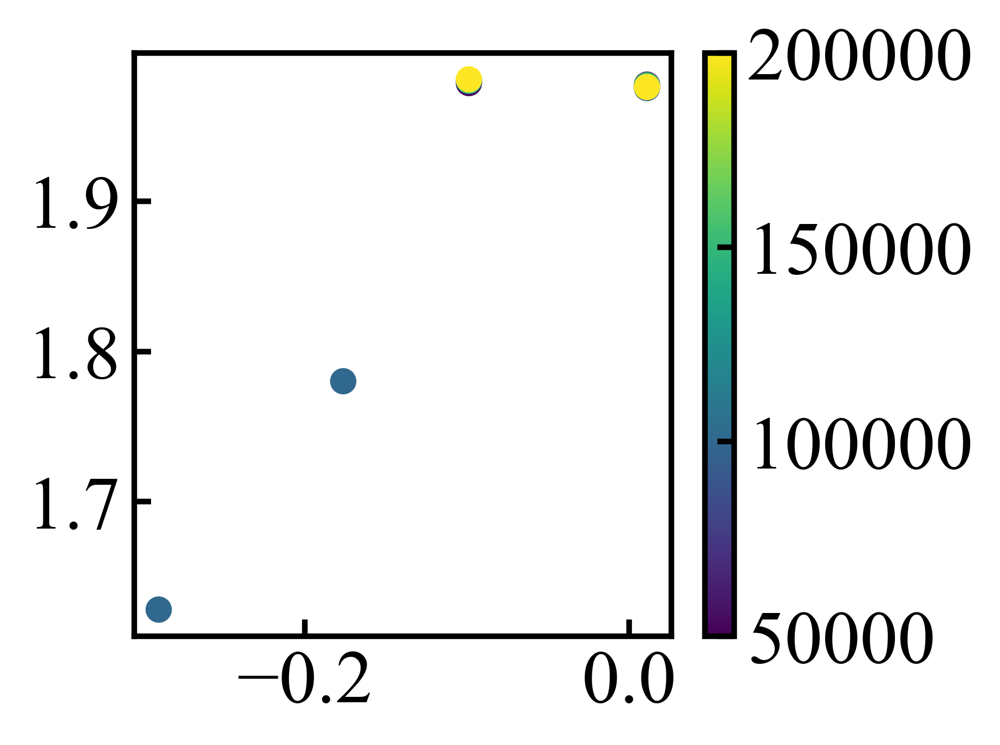

34


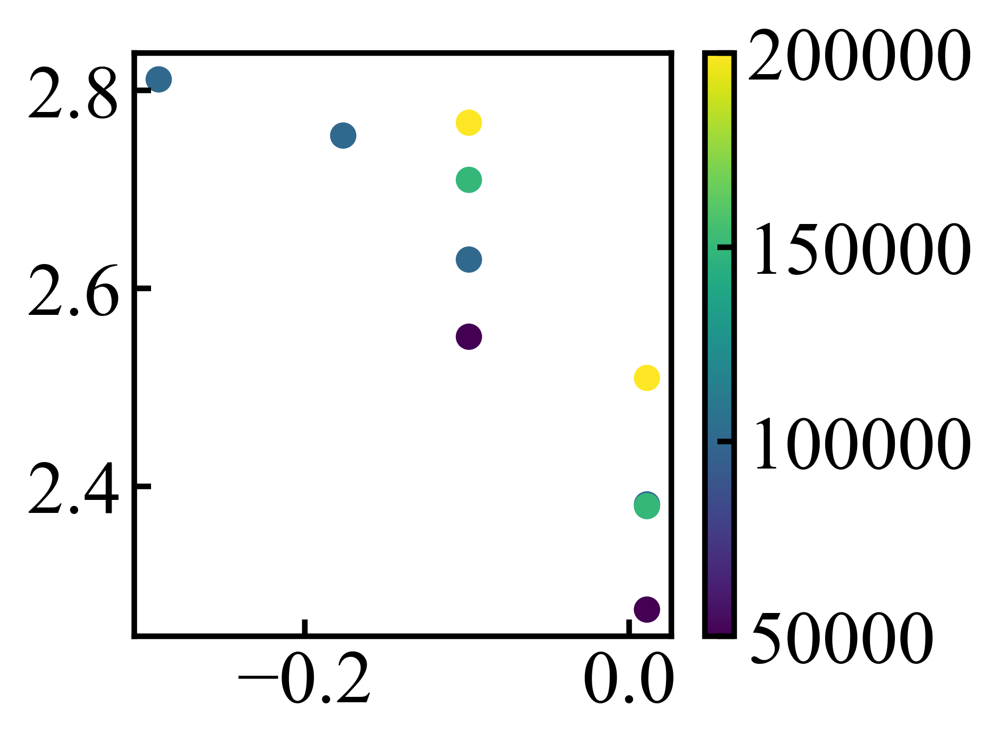

34


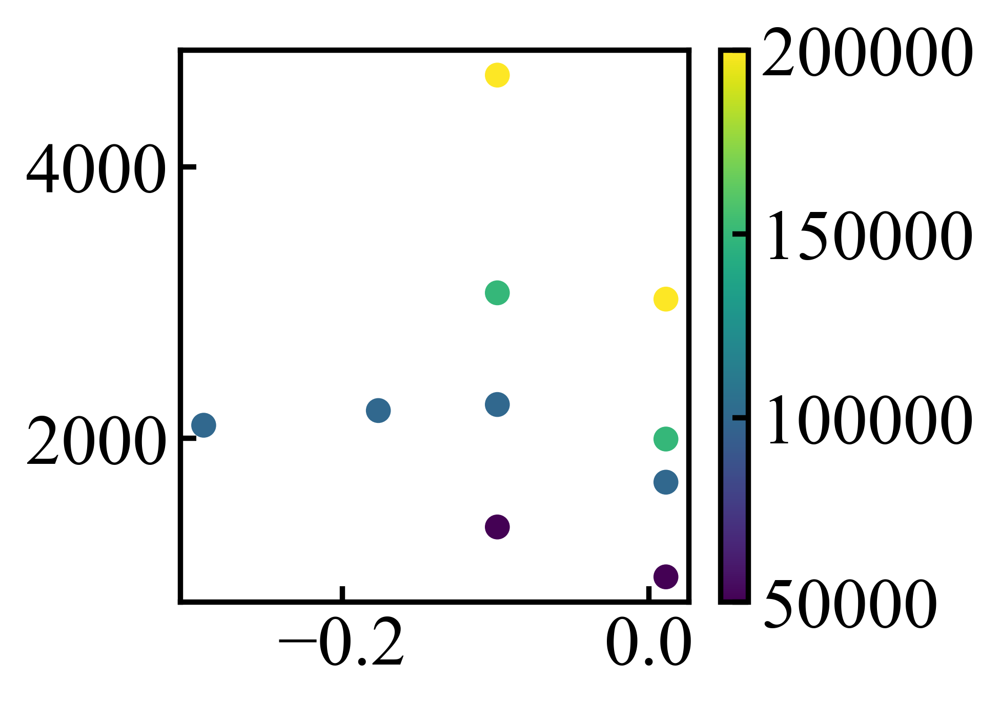

34


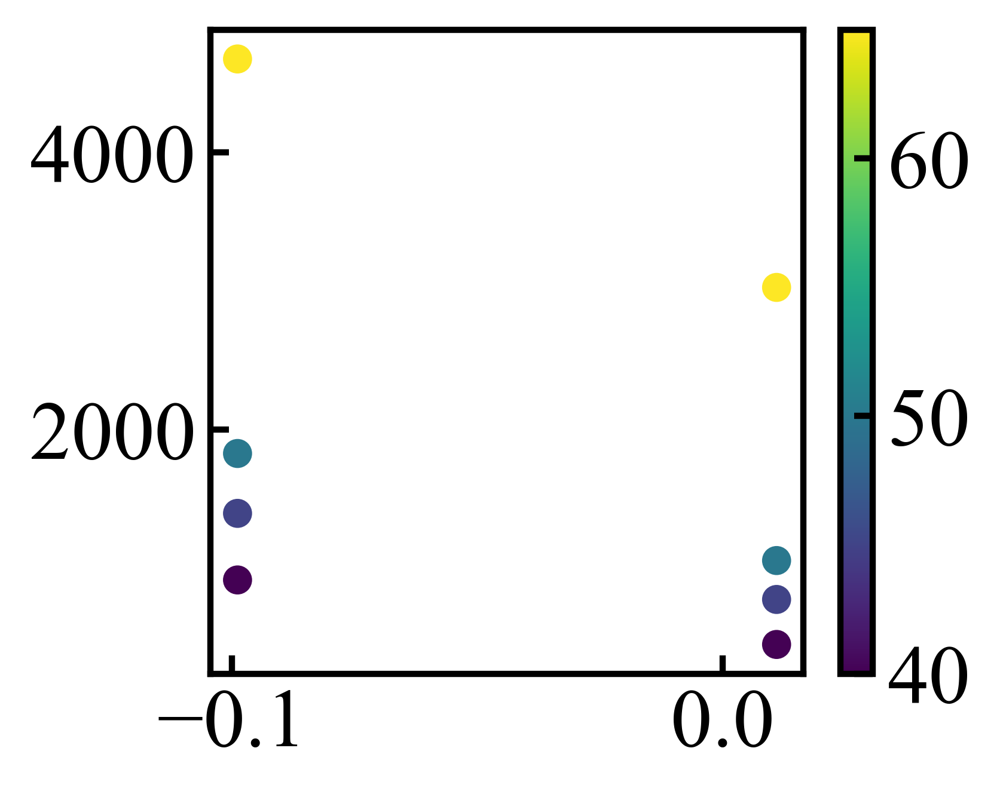

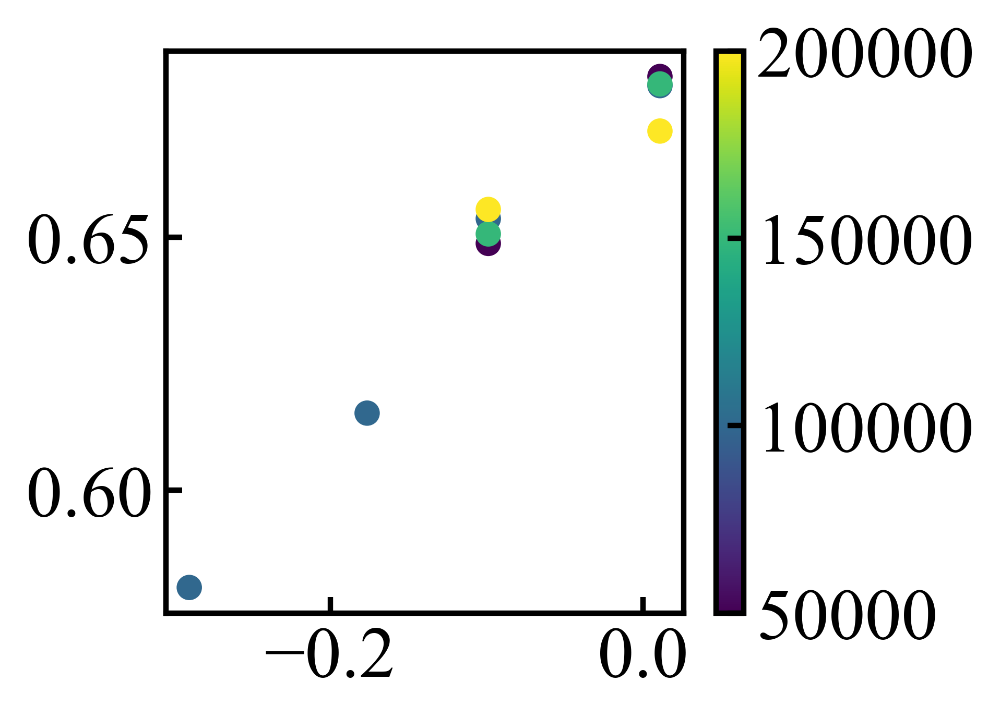

In [19]:
print(avg_dense_n)

test_id = np.where(interpart_phi==65)[0]
plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45),avg_bulk_n[test_id], c=interpart_pNum[test_id])
plt.colorbar()
plt.show()
print(len(bulk_allall_mean))
test_id = np.where(interpart_phi==65)[0]
plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45),bulk_AA_mean[test_id], c=interpart_pNum[test_id])
plt.colorbar()
plt.show()

print(len(bulk_allall_mean))
test_id = np.where(interpart_phi==65)[0]
plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45),A_first_size[test_id], c=interpart_pNum[test_id])
plt.colorbar()
plt.show()

print(len(bulk_allall_mean))
test_id = np.where(interpart_pNum==200000)[0]
plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45),A_first_size[test_id], c=interpart_phi[test_id])
plt.colorbar()
plt.show()


test_id = np.where(interpart_phi==65)[0]
plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45),avg_bulk_nB[test_id]/avg_bulk_n[test_id], c=interpart_pNum[test_id])
plt.colorbar()
plt.show()

In [19]:
avg_align_arr = np.array([])
avg_magnitude_arr = np.array([])
avg_net_flux_x_arr = np.array([])
avg_net_flux_y_arr = np.array([])
avg_net_flux_r_arr = np.array([])
avg_total_x_arr = np.array([])
avg_total_y_arr = np.array([])
avg_total_r_arr = np.array([])
avg_com_flux_x_arr = np.array([])
avg_com_flux_y_arr = np.array([])
avg_com_flux_r_arr = np.array([])
avg_dif_x_arr = np.array([])
avg_dif_y_arr = np.array([])
avg_dif_r_arr = np.array([])
interpart_peA = np.array([])
interpart_peB = np.array([])
avg_no_desorb_x_arr = np.array([])
avg_no_desorb_y_arr = np.array([])
avg_no_desorb_r_arr = np.array([])
dot_prod = np.array([])
dif_x = np.array([])
dif_y = np.array([])
dif_r = np.array([])

interpart_peA=np.array([])
interpart_peB=np.array([])
interpart_peNet=np.array([])
interpart_xA=np.array([])
interpart_eps=np.array([])
interpart_pNum=np.array([])
interpart_phi=np.array([])




avg_gas_to_clust_all_arr = np.array([])
avg_gas_to_clust_A_arr = np.array([])
avg_gas_to_clust_B_arr = np.array([])
avg_clust_to_gas_all_arr = np.array([])
avg_clust_to_gas_A_arr = np.array([])
avg_clust_to_gas_B_arr = np.array([])
avg_clust_size_arr = np.array([])           

std_gas_to_clust_all_arr = np.array([])
std_gas_to_clust_A_arr = np.array([])
std_gas_to_clust_B_arr = np.array([])
std_clust_to_gas_all_arr = np.array([])
std_clust_to_gas_A_arr = np.array([])
std_clust_to_gas_B_arr = np.array([])
std_clust_size_arr = np.array([])  

avg_bulk_nA = np.array([])
avg_bulk_nB = np.array([])
avg_bulk_n = np.array([])
avg_dense_nA = np.array([])
avg_dense_nB = np.array([])
avg_dense_n = np.array([])
avg_int_n = np.array([])
avg_int_nA = np.array([])
avg_int_nB = np.array([])
avg_gas_nA = np.array([])
avg_gas_nB = np.array([])
avg_gas_n = np.array([])

avg_bulk_NA = np.array([])
avg_bulk_NB = np.array([])
avg_bulk_N = np.array([])
avg_int_N = np.array([])
avg_int_NA = np.array([])
avg_int_NB = np.array([])
avg_gas_NA = np.array([])
avg_gas_NB = np.array([])
avg_gas_N = np.array([])
avg_dense_NA = np.array([])
avg_dense_NB = np.array([])
avg_dense_N = np.array([])

avg_bulk_area = np.array([])
avg_int_area = np.array([])
avg_gas_area = np.array([])
                            
for i in range(0, len(all_dens)):  
    
    for k in range(0, len(all_pres)):
        if all_pres[k].empty:
            continue
        
        if (params2['peA'][k]==params['peA'][i]) & (params2['pNum'][k]==params['pNum'][i]) & (params2['phi'][k]==params['phi'][i]) & (params2['peB'][k]==params['peB'][i]) & (params2['xA'][k]==params['xA'][i]):
            for q in range(0, len(all_pres_new2)):

                if all_pres_new2[q].empty:
                    continue
                if (params4['peA'][q]==params['peA'][i]) & (params4['pNum'][q]==params['pNum'][i]) & (params4['phi'][q]==params['phi'][i]) & (params4['peB'][q]==params['peB'][i]) & (params4['xA'][q]==params['xA'][i]):

                    for r in range(0, len(all_pres_new5)):
                        if all_pres_new5[r].empty:
                            continue
                        if (params7['peA'][r]==params['peA'][i]) & (params7['pNum'][r]==params['pNum'][i]) & (params7['phi'][r]==params['phi'][i]) & (params7['peB'][r]==params['peB'][i]) & (params7['xA'][r]==params['xA'][i]):
                                
                                #if (params7['peA'][r]==50) & (params7['peB'][r]==500) & (params7['phi'][r]==65):
                                print(params['peA'][i])
                                print(params['peB'][i])
                                print(params['pNum'][i])
                                print(params['phi'][i])

                                time_i = all_dens[i]['tauB']
                                time_k = all_pres[k]['tauB']
                                time_q = all_pres_new2[q]['tauB']
                                time_r = all_pres_new5[r]['tauB']

                                align_arr = np.array([])
                                magnitude_arr = np.array([])
                                net_flux_x_arr = np.array([])
                                net_flux_y_arr = np.array([])
                                net_flux_r_arr = np.array([])
                                total_x_arr = np.array([])
                                total_y_arr = np.array([])
                                total_r_arr = np.array([])
                                total_theta_arr = np.array([])
                                dif_x_arr = np.array([])
                                dif_y_arr = np.array([])
                                dif_r_arr = np.array([])
                                com_flux_x_arr = np.array([])
                                com_flux_y_arr = np.array([])
                                com_flux_r_arr = np.array([])
                                no_desorb_x_arr = np.array([])
                                no_desorb_y_arr = np.array([])
                                no_desorb_r_arr = np.array([])
                                
                                
                                
                                gas_to_clust_all_arr = np.array([])
                                gas_to_clust_A_arr = np.array([])
                                gas_to_clust_B_arr = np.array([])
                                clust_to_gas_all_arr = np.array([])
                                clust_to_gas_A_arr = np.array([])
                                clust_to_gas_B_arr = np.array([])
                                clust_size_arr = np.array([])      
                                
                                
                                #Instantiate arrays for reading in number density .txt file
                                bulk_nA_arr = np.array([])
                                bulk_nB_arr = np.array([])
                                bulk_n_arr = np.array([])
                                int_n_arr = np.array([])
                                int_nA_arr = np.array([])
                                int_nB_arr = np.array([])
                                gas_nA_arr = np.array([])
                                gas_n_arr = np.array([])
                                gas_nB_arr = np.array([])
                                dense_nA_arr = np.array([])
                                dense_nB_arr = np.array([])
                                dense_n_arr = np.array([])
                                bulk_area_arr = np.array([])
                                int_area_arr = np.array([])
                                gas_area_arr = np.array([])



                                bulk_NA_arr = np.array([])
                                bulk_NB_arr = np.array([])
                                bulk_N_arr = np.array([])
                                int_N_arr = np.array([])
                                int_NA_arr = np.array([])
                                int_NB_arr = np.array([])
                                gas_NA_arr = np.array([])
                                gas_N_arr = np.array([])
                                gas_NB_arr = np.array([])
                                dense_NA_arr = np.array([])
                                dense_N_arr = np.array([])
                                dense_NB_arr = np.array([])
                                
                                time_dens = np.array([])
                                
                                for j in range(0, len(time_i)):

                                    time = time_i[j]
                                    if time >=0:

                                        align_arr = np.append(align_arr, all_dens[i]['align'][j])
                                        magnitude_arr = np.append(magnitude_arr, all_dens[i]['magnitude'][j])

                                        no_desorb_x_arr = np.append(no_desorb_x_arr, all_dens[i]['no_desorb_x'][j])
                                        no_desorb_y_arr = np.append(no_desorb_y_arr, all_dens[i]['no_desorb_y'][j])
                                        no_desorb_r_arr = np.append(no_desorb_r_arr, all_dens[i]['no_desorb_r'][j])

                                        net_flux_x_arr = np.append(net_flux_x_arr, all_dens[i]['net_flux_x'][j])
                                        net_flux_y_arr = np.append(net_flux_y_arr, all_dens[i]['net_flux_y'][j])
                                        net_flux_r_arr = np.append(net_flux_r_arr, all_dens[i]['net_flux_r'][j])

                                        total_x_arr = np.append(total_x_arr, all_dens[i]['total_x'][j])
                                        total_y_arr = np.append(total_y_arr, all_dens[i]['total_y'][j])
                                        total_r_arr = np.append(total_r_arr, all_dens[i]['total_r'][j])
                                        total_theta_arr = np.append(total_theta_arr, np.arctan2(all_dens[i]['total_y'][j], all_dens[i]['total_x'][j]))

                                        com_flux_x_arr = np.append(com_flux_x_arr, all_dens[i]['com_flux_x'][j])
                                        com_flux_y_arr = np.append(com_flux_y_arr, all_dens[i]['com_flux_y'][j])
                                        com_flux_r_arr = np.append(com_flux_r_arr, all_dens[i]['com_flux_r'][j])

                                        dif_x_arr = np.append(dif_x_arr, net_flux_x_arr[-1] - total_x_arr[-1])
                                        dif_y_arr = np.append(dif_y_arr, net_flux_y_arr[-1] - total_y_arr[-1])
                                        dif_r_arr = np.append(dif_r_arr, (dif_x_arr[-1]**2 + dif_y_arr[-1]**2) ** 0.5)
                                        
                                        time_id_k = np.where(time_k==time)[0]

                                        if (len(time_id_k)>0):
                                            time_dens = np.append(time_dens, time)
                                            gas_to_clust_all_arr = np.append(gas_to_clust_all_arr, all_pres[k]['gas_to_clust_all'][j])
                                            gas_to_clust_A_arr = np.append(gas_to_clust_A_arr, all_pres[k]['gas_to_clust_A'][j])
                                            gas_to_clust_B_arr = np.append(gas_to_clust_B_arr, all_pres[k]['gas_to_clust_B'][j])
                                            clust_to_gas_all_arr = np.append(clust_to_gas_all_arr, all_pres[k]['clust_to_gas_all'][j])
                                            clust_to_gas_A_arr = np.append(clust_to_gas_A_arr, all_pres[k]['clust_to_gas_A'][j])
                                            clust_to_gas_B_arr = np.append(clust_to_gas_B_arr, all_pres[k]['clust_to_gas_B'][j])
                                            clust_size_arr = np.append(clust_size_arr, all_pres[k]['clust_size'][j])
                                        
                                        #Read values and set variables from number density .txt files
                                        time_id_q = np.where(time_q==time)[0]
                                        time_id_r = np.where(time_r==time)[0]

                                        if (len(time_id_q)>0) & len(time_id_r)>0:
                                            #time_dens = np.append(time_dens, time)
                                            bin_size = all_pres_new5[r]['sizeBin_x'][time_id_r]
                                            bin_area = bin_size**2
                                            if (all_pres_new5[r]['bulk'][time_id_r].values[0])>0:
                                                bulk_NA_arr = np.append(bulk_NA_arr, all_pres_new2[q]['bulk_A'][time_id_q].values[0])
                                                bulk_NB_arr = np.append(bulk_NB_arr, all_pres_new2[q]['bulk_B'][time_id_q].values[0])
                                                bulk_N_arr = np.append(bulk_N_arr, all_pres_new2[q]['bulk_all'][time_id_q].values[0])

                                                bulk_area_arr = np.append(bulk_area_arr, (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))


                                                bulk_nA_arr = np.append(bulk_nA_arr, all_pres_new2[q]['bulk_A'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))
                                                bulk_nB_arr = np.append(bulk_nB_arr, all_pres_new2[q]['bulk_B'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))
                                                bulk_n_arr = np.append(bulk_n_arr, (all_pres_new2[q]['bulk_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['bulk'][time_id_r].values[0]))
                                                fast_frac_val = (bulk_nB_arr[-1]/bulk_n_arr[-1])
                                                slow_frac_val = (bulk_nA_arr[-1]/bulk_n_arr[-1])

                                            else:

                                                bulk_NA_arr = np.append(bulk_NA_arr, 0)
                                                bulk_NB_arr = np.append(bulk_NB_arr, 0)
                                                bulk_N_arr = np.append(bulk_N_arr, 0)

                                                bulk_area_arr = np.append(bulk_area_arr, 0)


                                                bulk_nA_arr = np.append(bulk_nA_arr, 0.0)
                                                bulk_nB_arr = np.append(bulk_nB_arr, 0.0)
                                                bulk_n_arr = np.append(bulk_n_arr, 0.0)
                                                fast_frac_val = 0.0
                                                slow_frac_val = 0.0
                                            if (all_pres_new5[r]['int'][time_id_r].values[0])>0:

                                                int_NA_arr = np.append(int_NA_arr, all_pres_new2[q]['int_A'][time_id_q].values[0])
                                                int_NB_arr = np.append(int_NB_arr, all_pres_new2[q]['int_B'][time_id_q].values[0])
                                                int_N_arr = np.append(int_N_arr, all_pres_new2[q]['int_all'][time_id_q].values[0])

                                                int_area_arr = np.append(int_area_arr, (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))

                                                int_n_arr = np.append(int_n_arr, (all_pres_new2[q]['int_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))
                                                int_nA_arr = np.append(int_nA_arr, all_pres_new2[q]['int_A'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))
                                                int_nB_arr = np.append(int_nB_arr, all_pres_new2[q]['int_B'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['int'][time_id_r].values[0]))
                                            else:
                                                int_NA_arr = np.append(int_NA_arr, 0)
                                                int_NB_arr = np.append(int_NB_arr, 0)
                                                int_N_arr = np.append(int_N_arr, 0)

                                                int_area_arr = np.append(int_area_arr, 0)


                                                int_n_arr = np.append(int_n_arr, 0.0)
                                                int_nA_arr = np.append(int_nA_arr, 0.0)
                                                int_nB_arr = np.append(int_nB_arr, 0.0)
                                            if (all_pres_new5[r]['gas'][time_id_r].values[0])>0:
                                                gas_NA_arr = np.append(gas_NA_arr, all_pres_new2[q]['gas_A'][time_id_q].values[0])
                                                gas_NB_arr = np.append(gas_NB_arr, all_pres_new2[q]['gas_B'][time_id_q].values[0])
                                                gas_N_arr = np.append(gas_N_arr, all_pres_new2[q]['gas_all'][time_id_q].values[0])

                                                gas_area_arr = np.append(gas_area_arr, (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))

                                                gas_n_arr = np.append(gas_n_arr, (all_pres_new2[q]['gas_all'][time_id_q].values[0]) / (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))
                                                gas_nA_arr = np.append(gas_nA_arr, all_pres_new2[q]['gas_A'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))
                                                gas_nB_arr = np.append(gas_nB_arr, all_pres_new2[q]['gas_B'][time_id_q].values[0] / (bin_area * all_pres_new5[r]['gas'][time_id_r].values[0]))
                                            else:
                                                gas_NA_arr = np.append(gas_NA_arr, 0)
                                                gas_NB_arr = np.append(gas_NB_arr, 0)
                                                gas_N_arr = np.append(gas_N_arr, 0)

                                                gas_area_arr = np.append(gas_area_arr, 0)

                                                gas_n_arr = np.append(gas_n_arr, 0.0)
                                                gas_nA_arr = np.append(gas_nA_arr, 0.0)
                                                gas_nB_arr = np.append(gas_nB_arr, 0.0)
                                            if (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])>0:
                                                dense_n_arr = np.append(dense_n_arr, (all_pres_new2[q]['int_all'][time_id_q].values[0]+all_pres_new2[q]['bulk_all'][time_id_q].values[0]) / (bin_area * (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])))
                                                dense_nA_arr = np.append(dense_nA_arr, (all_pres_new2[q]['int_A'][time_id_q].values[0]+all_pres_new2[q]['bulk_A'][time_id_q].values[0]) / (bin_area * (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])))
                                                dense_nB_arr = np.append(dense_nB_arr, (all_pres_new2[q]['int_B'][time_id_q].values[0]+all_pres_new2[q]['bulk_B'][time_id_q].values[0]) / (bin_area * (all_pres_new5[r]['int'][time_id_r].values[0]+all_pres_new5[r]['bulk'][time_id_r].values[0])))

                                                dense_N_arr = np.append(dense_N_arr, (all_pres_new2[q]['int_all'][time_id_q].values[0]+all_pres_new2[q]['bulk_all'][time_id_q].values[0]))
                                                dense_NA_arr = np.append(dense_NA_arr, (all_pres_new2[q]['int_A'][time_id_q].values[0]+all_pres_new2[q]['bulk_A'][time_id_q].values[0]))
                                                dense_NB_arr = np.append(dense_NB_arr, (all_pres_new2[q]['int_B'][time_id_q].values[0]+all_pres_new2[q]['bulk_B'][time_id_q].values[0]))
                                                
                                            
                                            else:
                                                dense_n_arr = np.append(dense_n_arr, 0.0)
                                                dense_nA_arr = np.append(dense_nA_arr, 0.0)
                                                dense_nB_arr = np.append(dense_nB_arr, 0.0)

                                                dense_N_arr = np.append(dense_N_arr, 0.0)
                                                dense_NA_arr = np.append(dense_NA_arr, 0.0)
                                                dense_NB_arr = np.append(dense_NB_arr, 0.0)
                                if len(align_arr) > 10: 
                                    dot_prod = np.append(dot_prod, np.mean((net_flux_x_arr/net_flux_r_arr) * (total_x_arr/total_r_arr) + (net_flux_y_arr/net_flux_r_arr) * (total_y_arr / total_r_arr)))

                                    dot_prod_arr = (net_flux_x_arr/net_flux_r_arr) * (total_x_arr/total_r_arr) + (net_flux_y_arr/net_flux_r_arr) * (total_y_arr / total_r_arr)                                

                                    dif_x = np.append(dif_x, np.mean(np.abs(net_flux_x_arr - total_x_arr)))

                                    dif_y = np.append(dif_y, np.mean(np.abs(net_flux_y_arr - total_y_arr)))
                                    dif_r = np.append(dif_r, (dif_x[-1]**2 + dif_y[-1]**2) ** 0.5 )

                                    avg_align_arr = np.append(avg_align_arr, np.mean(align_arr))
                                    avg_magnitude_arr = np.append(avg_magnitude_arr, np.mean(magnitude_arr))
                                    avg_net_flux_x_arr = np.append(avg_net_flux_x_arr, np.mean(net_flux_x_arr))
                                    avg_net_flux_y_arr = np.append(avg_net_flux_y_arr, np.mean(net_flux_y_arr))
                                    avg_net_flux_r_arr = np.append(avg_net_flux_r_arr, np.mean(net_flux_r_arr))
                                    avg_total_x_arr = np.append(avg_total_x_arr, np.mean(total_x_arr))
                                    avg_total_y_arr = np.append(avg_total_y_arr, np.mean(total_y_arr))
                                    avg_total_r_arr = np.append(avg_total_r_arr, np.mean(total_r_arr))
                                    
                                    avg_gas_to_clust_all_arr = np.append(avg_gas_to_clust_all_arr, np.mean(gas_to_clust_all_arr))
                                    avg_gas_to_clust_A_arr = np.append(avg_gas_to_clust_A_arr, np.mean(gas_to_clust_A_arr))
                                    avg_gas_to_clust_B_arr = np.append(avg_gas_to_clust_B_arr, np.mean(gas_to_clust_B_arr))
                                    avg_clust_to_gas_all_arr = np.append(avg_clust_to_gas_all_arr, np.mean(clust_to_gas_all_arr))
                                    avg_clust_to_gas_A_arr = np.append(avg_clust_to_gas_A_arr, np.mean(clust_to_gas_A_arr))
                                    avg_clust_to_gas_B_arr = np.append(avg_clust_to_gas_B_arr, np.mean(clust_to_gas_B_arr))
                                    avg_clust_size_arr = np.append(avg_clust_size_arr, np.mean(clust_size_arr))

                                    std_gas_to_clust_all_arr = np.append(std_gas_to_clust_all_arr, np.std(gas_to_clust_all_arr))
                                    std_gas_to_clust_A_arr = np.append(std_gas_to_clust_A_arr, np.std(gas_to_clust_A_arr))
                                    std_gas_to_clust_B_arr = np.append(std_gas_to_clust_B_arr, np.std(gas_to_clust_B_arr))
                                    std_clust_to_gas_all_arr = np.append(std_clust_to_gas_all_arr, np.std(clust_to_gas_all_arr))
                                    std_clust_to_gas_A_arr = np.append(std_clust_to_gas_A_arr, np.std(clust_to_gas_A_arr))
                                    std_clust_to_gas_B_arr = np.append(std_clust_to_gas_B_arr, np.std(clust_to_gas_B_arr))
                                    std_clust_size_arr = np.append(std_clust_size_arr, np.std(clust_size_arr))

                                    avg_com_flux_x_arr = np.append(avg_com_flux_x_arr, np.mean(com_flux_x_arr))
                                    avg_com_flux_y_arr = np.append(avg_com_flux_y_arr, np.mean(com_flux_y_arr))
                                    avg_com_flux_r_arr = np.append(avg_com_flux_r_arr, np.mean(com_flux_r_arr))
                                    avg_dif_x_arr = np.append(avg_dif_x_arr, np.mean(dif_x_arr))
                                    avg_dif_y_arr = np.append(avg_dif_y_arr, np.mean(dif_y_arr))
                                    avg_dif_r_arr = np.append(avg_dif_r_arr, np.mean(dif_r_arr))
                                    avg_no_desorb_x_arr = np.append(avg_no_desorb_x_arr, np.mean(no_desorb_x_arr))
                                    avg_no_desorb_y_arr = np.append(avg_no_desorb_y_arr, np.mean(no_desorb_y_arr))
                                    avg_no_desorb_r_arr = np.append(avg_no_desorb_r_arr, np.mean(no_desorb_r_arr))
                                    
                                    #Time-average values for sufficiently long phase composition .txt files
                                    avg_bulk_nA = np.append(avg_bulk_nA, np.mean(bulk_nA_arr))
                                    avg_bulk_n = np.append(avg_bulk_n, np.mean(bulk_n_arr))
                                    avg_bulk_nB = np.append(avg_bulk_nB, np.mean(bulk_nB_arr))

                                    avg_bulk_NA = np.append(avg_bulk_NA, np.mean(bulk_NA_arr))
                                    avg_bulk_N = np.append(avg_bulk_N, np.mean(bulk_N_arr))
                                    avg_bulk_NB = np.append(avg_bulk_NB, np.mean(bulk_NB_arr))

                                    avg_int_n = np.append(avg_int_n, np.mean(int_n_arr))
                                    avg_int_nA = np.append(avg_int_nA, np.mean(int_nA_arr))
                                    avg_int_nB = np.append(avg_int_nB, np.mean(int_nB_arr))

                                    avg_int_N = np.append(avg_int_N, np.mean(int_N_arr))
                                    avg_int_NA = np.append(avg_int_NA, np.mean(int_NA_arr))
                                    avg_int_NB = np.append(avg_int_NB, np.mean(int_NB_arr))

                                    avg_gas_n = np.append(avg_gas_n, np.mean(gas_n_arr))
                                    avg_gas_nA = np.append(avg_gas_nA, np.mean(gas_nA_arr))
                                    avg_gas_nB = np.append(avg_gas_nB, np.mean(gas_nB_arr))

                                    avg_gas_N = np.append(avg_gas_N, np.mean(gas_N_arr))
                                    avg_gas_NA = np.append(avg_gas_NA, np.mean(gas_NA_arr))
                                    avg_gas_NB = np.append(avg_gas_NB, np.mean(gas_NB_arr))

                                    avg_bulk_area = np.append(avg_bulk_area, np.mean(bulk_area_arr))
                                    avg_int_area = np.append(avg_int_area, np.mean(int_area_arr))

                                    avg_gas_area = np.append(avg_gas_area, np.mean(gas_area_arr))

                                    avg_dense_nA = np.append(avg_dense_nA, np.mean(dense_nA_arr))
                                    avg_dense_n = np.append(avg_dense_n, np.mean(dense_n_arr))
                                    avg_dense_nB = np.append(avg_dense_nB, np.mean(dense_nB_arr))
                                    
                                    interpart_peA = np.append(interpart_peA, params['peA'][i])
                                    interpart_peB = np.append(interpart_peB, params['peB'][i])
                                    interpart_xA=np.append(interpart_xA, params['xA'][i])
                                    interpart_pNum=np.append(interpart_pNum, params['pNum'][i])
                                    interpart_phi=np.append(interpart_phi, params['phi'][i])
                                    
                                    
                                    #if (len(time_i)>=55) & (len(time_dens)>=55):
                                    #from scipy.signal import savgol_filter
                                    #total_r_arr_filt = savgol_filter(total_r_arr, 51,3)
                                    #dot_prod_arr_filt = savgol_filter(dot_prod_arr, 51,3)
                                    #total_theta_arr_filt = savgol_filter(total_theta_arr, 51,3)
                                    """
                                    plt.figure(figsize=(10, 4))
                                    #plt.plot(time_i, total_r_arr_filt/np.mean(total_r_arr_filt[-100:]), c='red', label=r'$\Delta r$')
                                    #plt.plot(time_i, total_theta_arr_filt, c='blue', label=r'$\Delta \theta$')
                                    plt.plot(time_dens, clust_to_gas_all_arr/np.mean(clust_to_gas_all_arr), c='red', label=r'Desorbed')
                                    plt.plot(time_dens, gas_to_clust_all_arr/np.mean(gas_to_clust_all_arr), c='blue', label=r'Adsorbed')
                                    plt.xlabel(r'Time ($\tau_\mathrm{B}$)')
                                    plt.ylabel(r'$\Delta N$')
                                    plt.ylim([0, 5])
                                    plt.xlim([15.,200])
                                    plt.legend(loc='upper right')
                                    plt.show()
                                    """



0
500
50000.0
40.0


KeyError: 'align'

C:\Users\Nick\AppData\Local\Temp\ipykernel_19024\23083016.py:54: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values "0". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


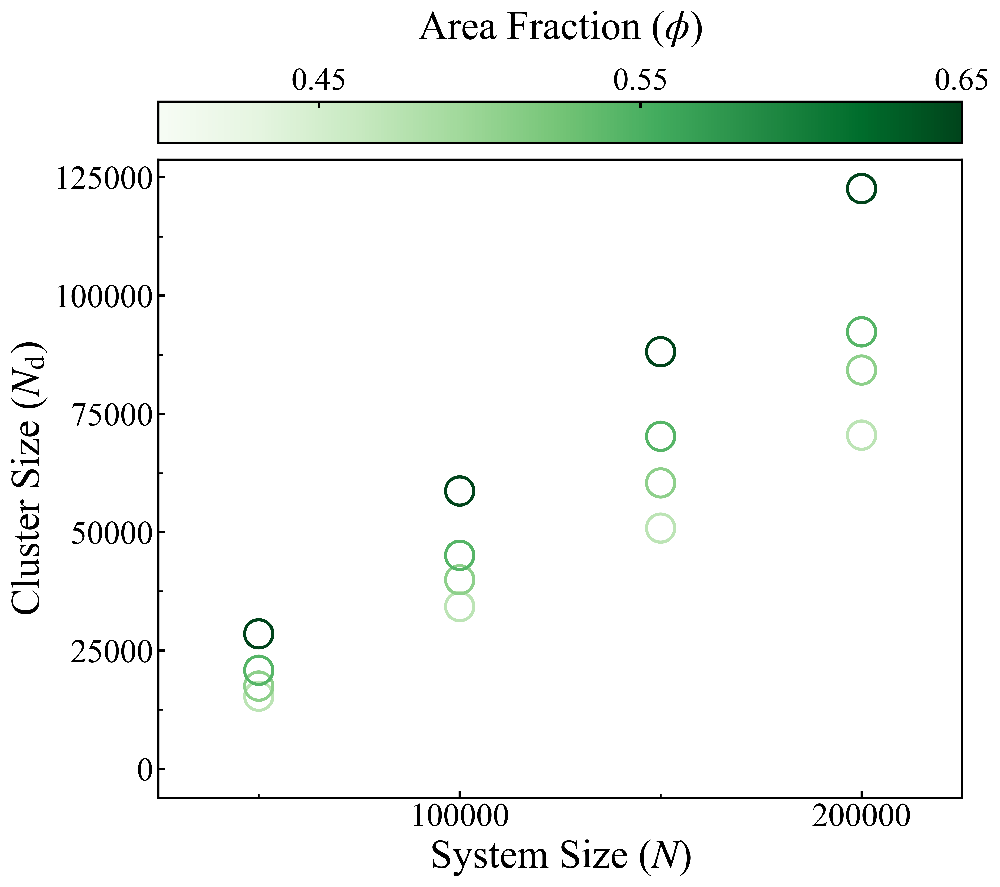

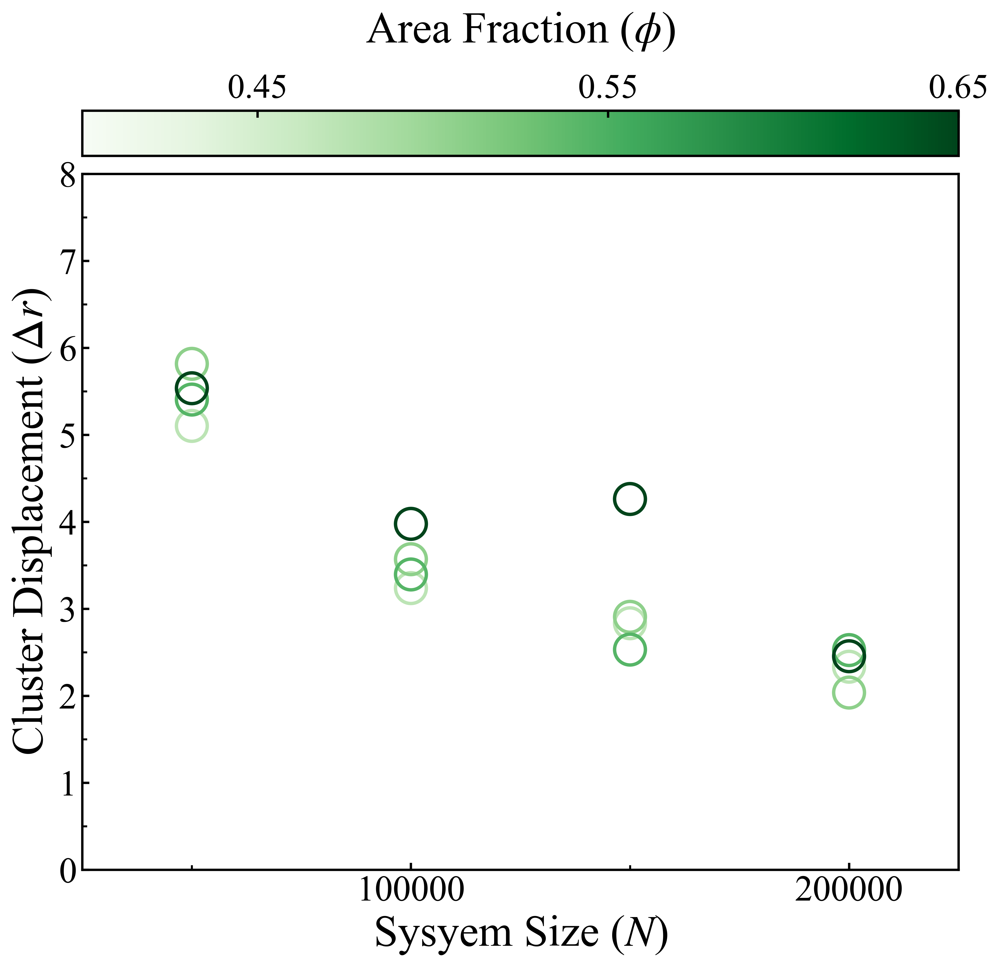

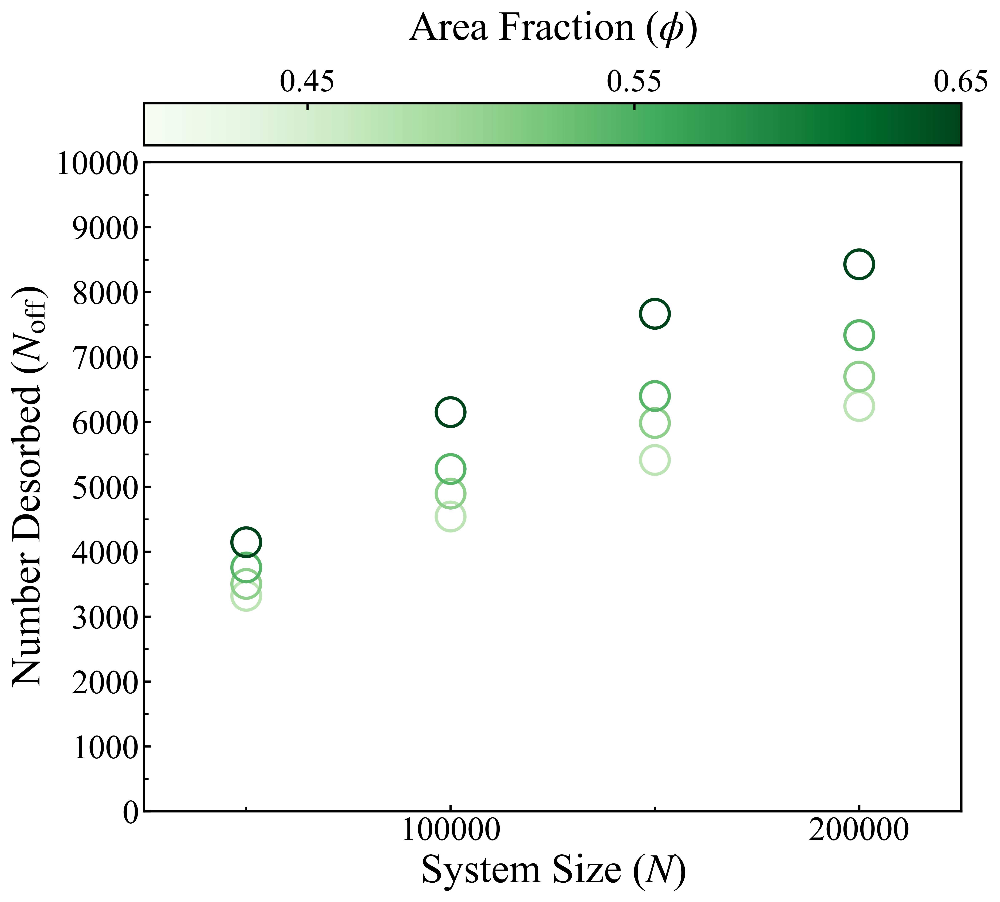

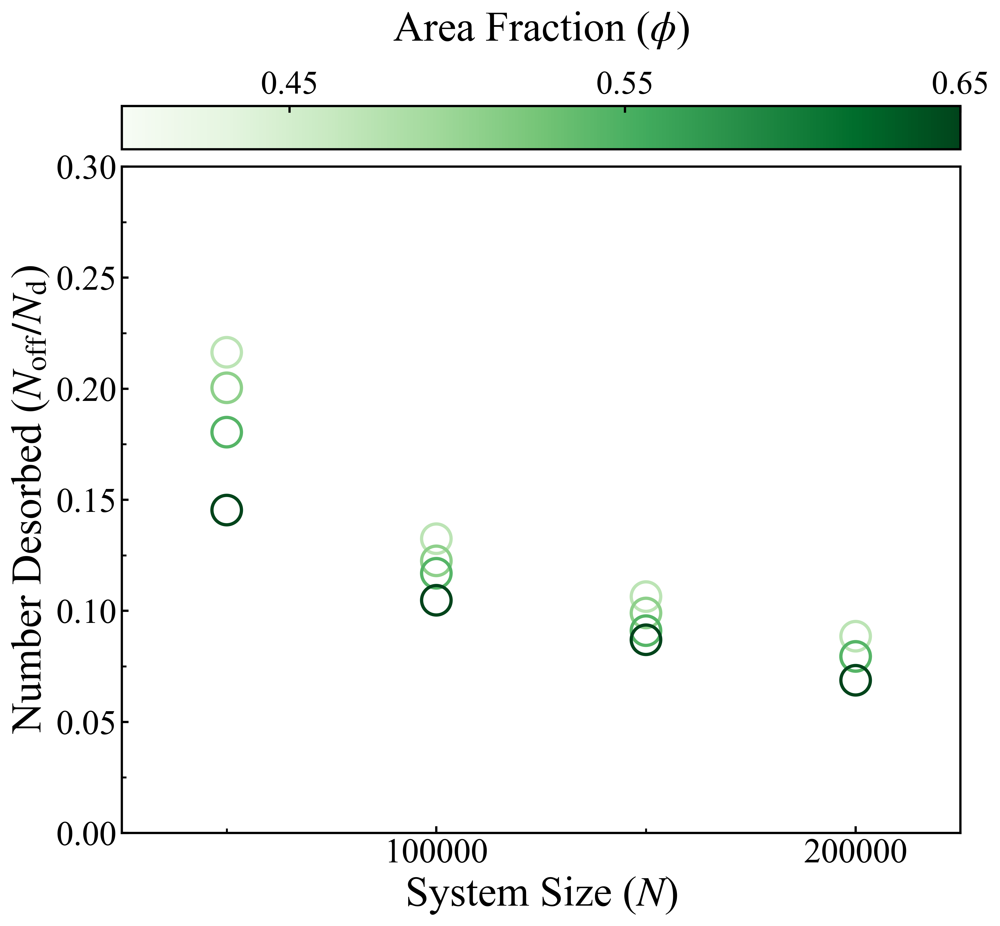

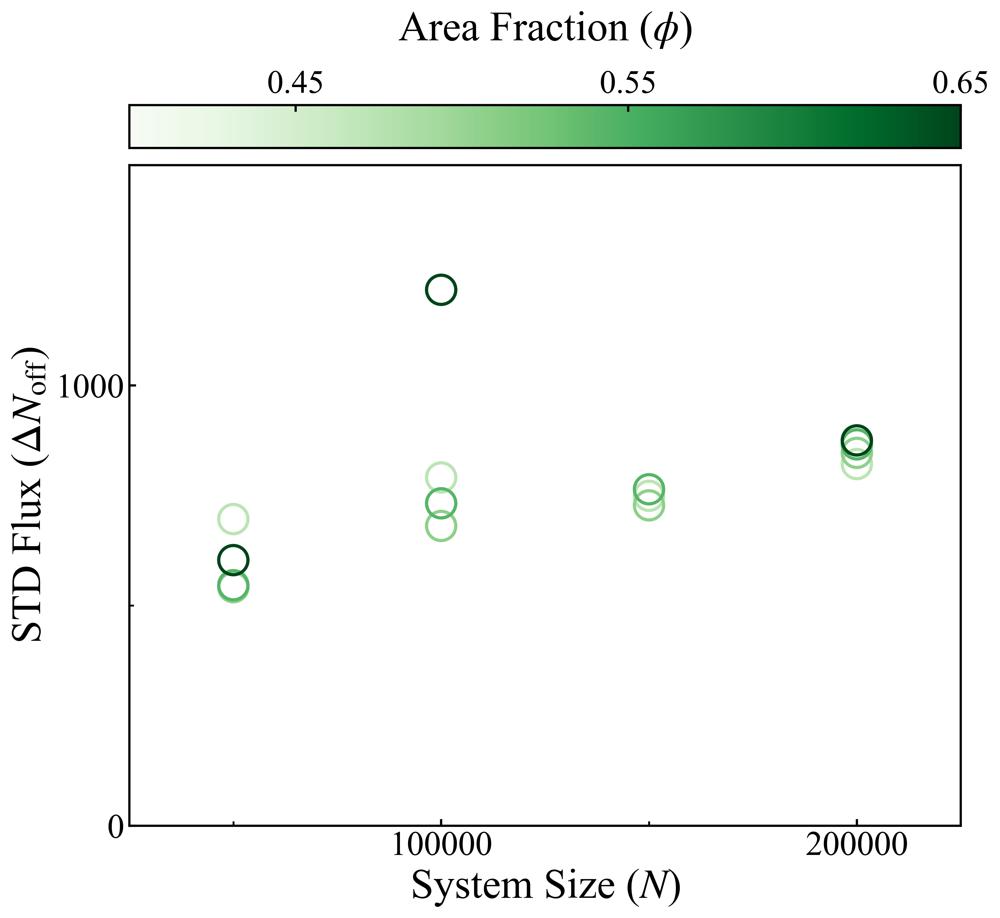

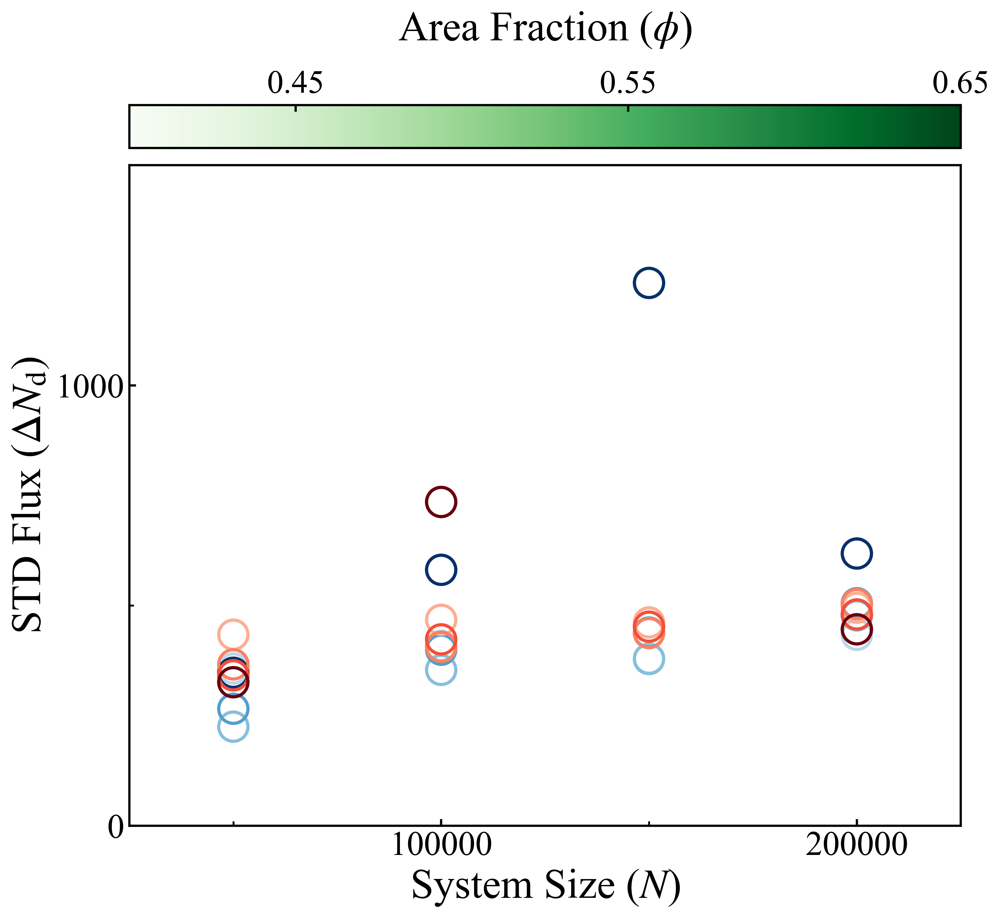

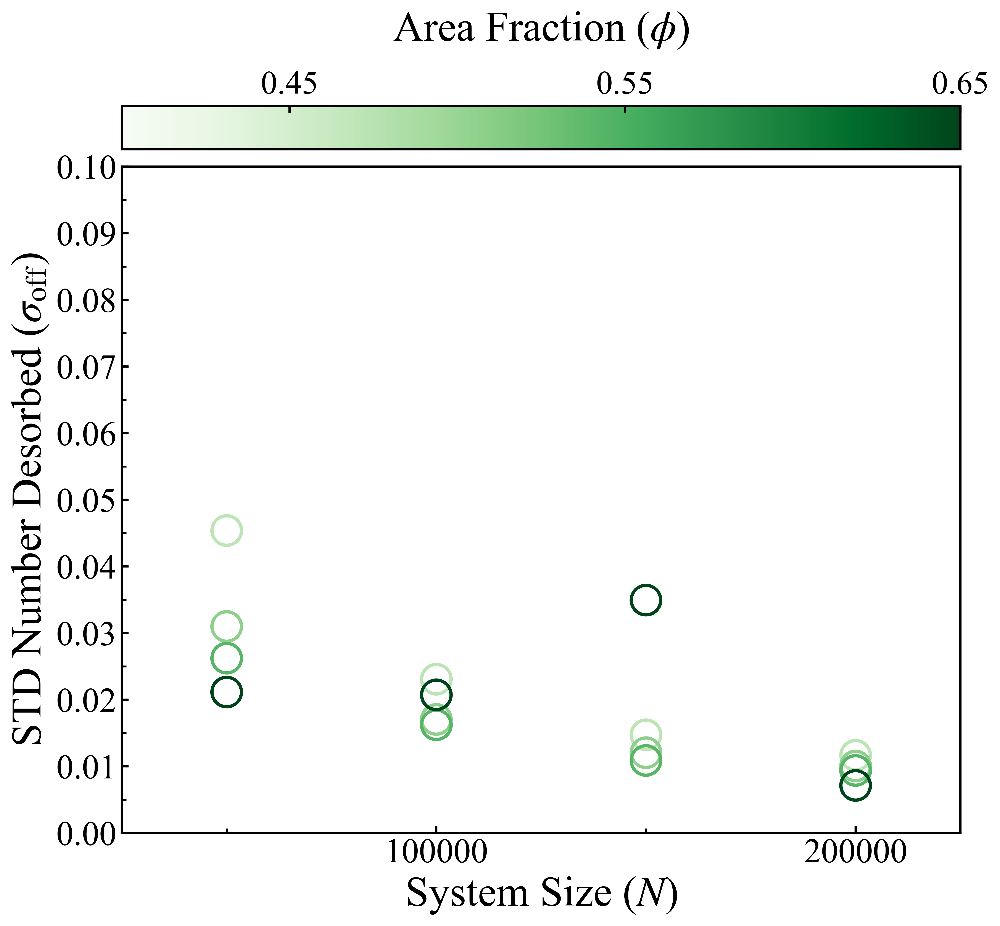

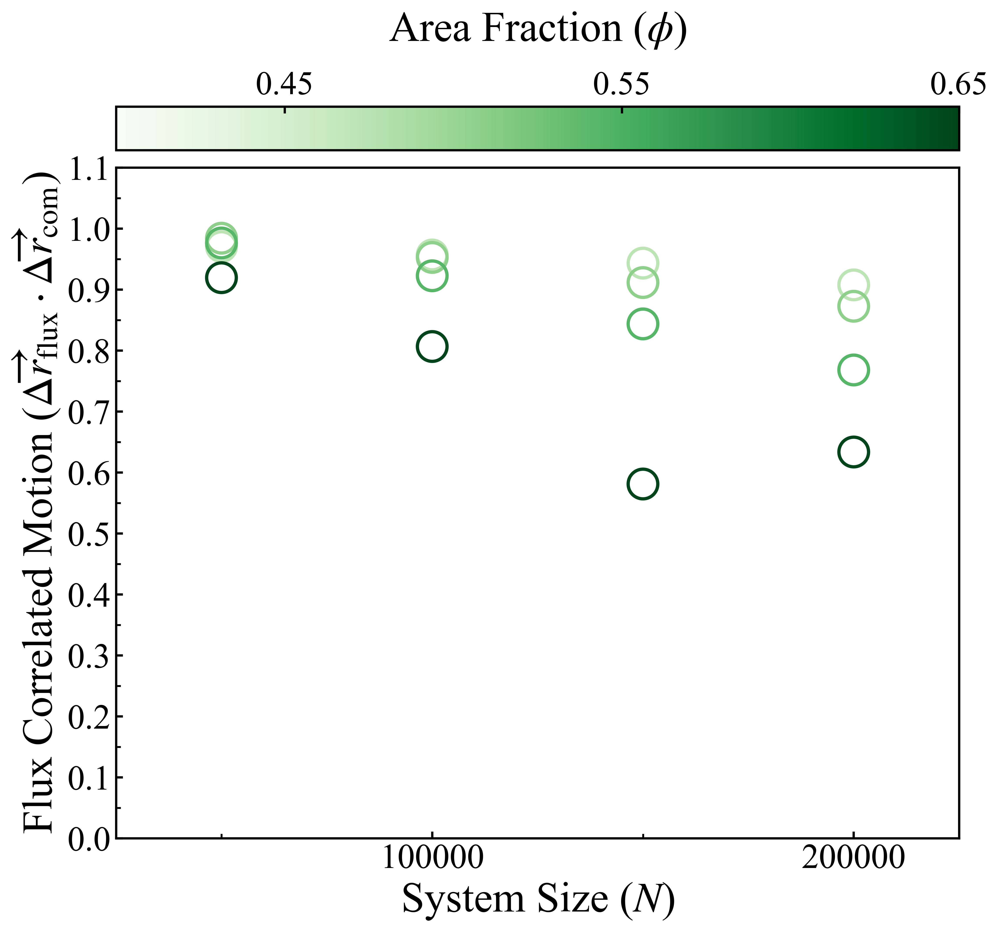

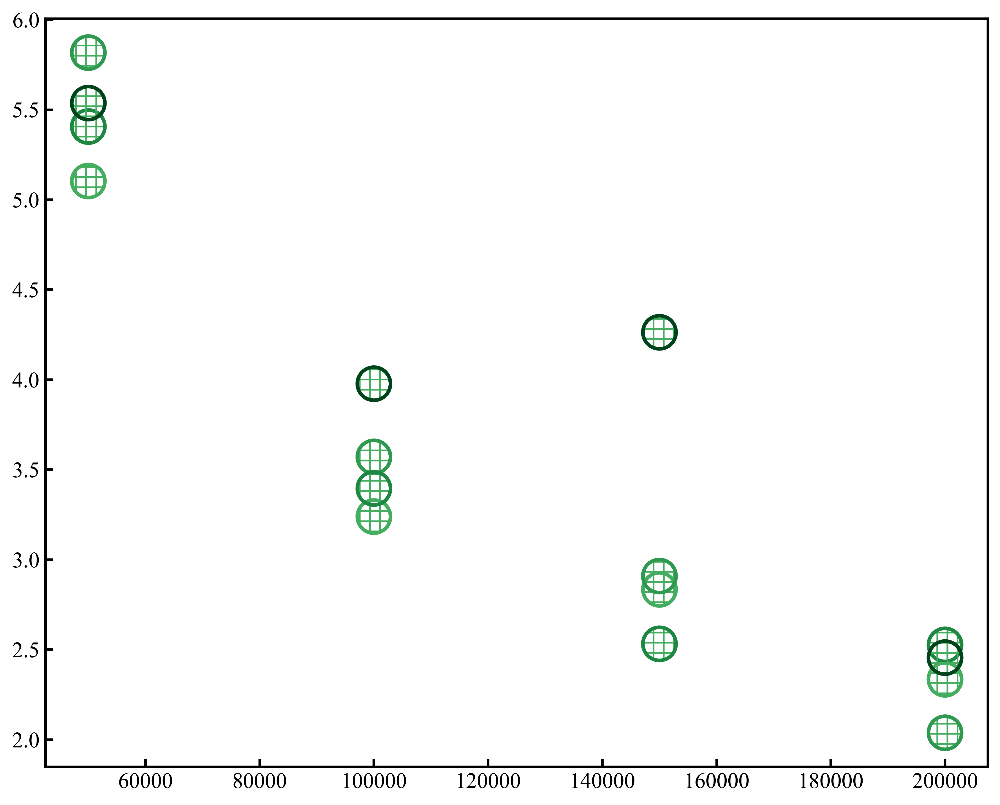

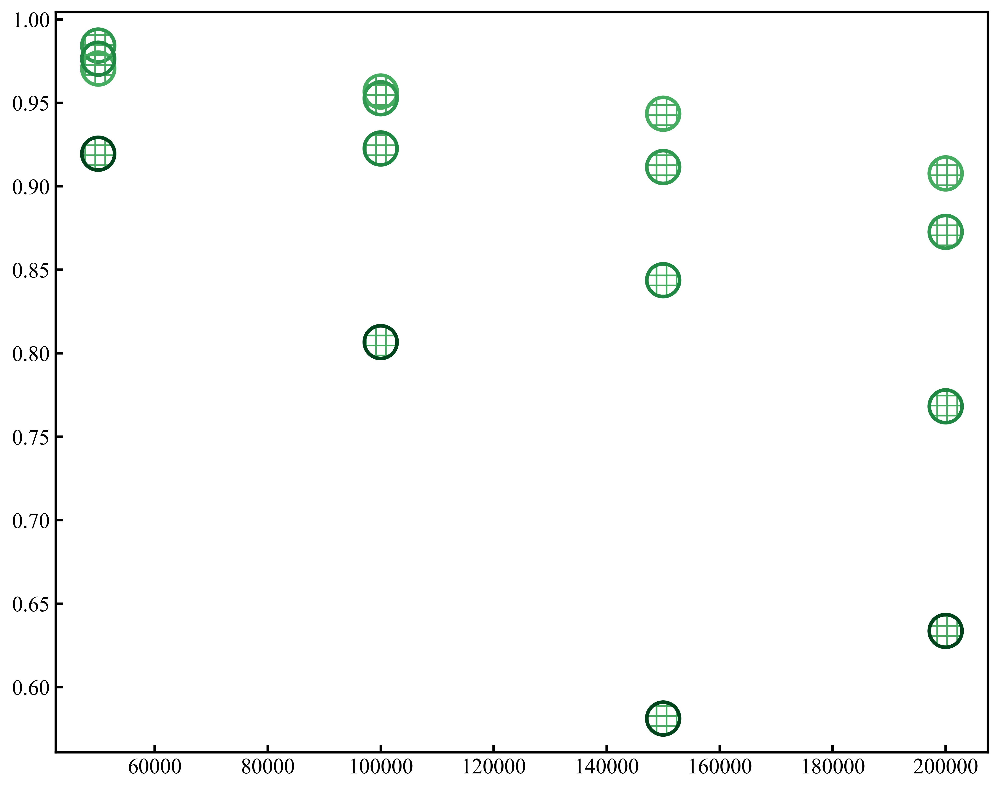

NameError: name 'stop' is not defined

In [83]:
import matplotlib


import matplotlib.patches
import matplotlib.patches as patches

msz=10
fsize=10
green = ("#77dd77")

yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")
fsize=10
mpl.rcParams.update({'font.size': 13})
mkSz = [0.1, 0.1, 0.15, 0.1, 0.1]
msz=40

fast_leg=[]
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='None',
                      markerfacecolor=green, 
                      label='Simulation', markersize=(2.8*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
                      markeredgecolor='None',
                      markerfacecolor=red, 
                      label=r'Theory', markersize=(2.8*msz * mkSz[0])))
#fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*1.2,
#                      markeredgecolor='None',
#                      markerfacecolor=red, 
#                      label=r'Theory', markersize=(2.8*msz * mkSz[0])))

where_else4 = np.where((interpart_peB>=0.0) & (interpart_xA==50))[0]

#bulk_all_lat_time_mean[xa50]
#phi_bulk_sim
#plt.scatter(interpart_peA[where_else4]*(interpart_xA[where_else4]/100) + interpart_peB[where_else4] * (1.0-(interpart_peA[where_else4]/100)), interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')

fast_arr = [50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
xa_arr = [50]

fast_leg=[]
mkSz = [0.8, 0.8]
msz=10
cmap = matplotlib.cm.get_cmap('Set2')
patterns = ['xxx', '**', '++', '\\\\\\\\', '.0.0']


far_patch = patches.Patch(fill=False, label='0.2', hatch=patterns[0])
near_patch = patches.Patch(fill=False, label='0.35', hatch =patterns[1])
mid_patch = patches.Patch(fill=False, label='0.5', hatch =patterns[2])
mid2_patch = patches.Patch(fill=False, label='0.65', hatch=patterns[3])
mid3_patch = patches.Patch(fill=False, label='0.8', hatch =patterns[4])


test = np.where(interpart_peB==200)[0]
#plt.scatter(interpart_peA[test]/interpart_peB[test], avg_total_r_arr[test])
#plt.show()

count = 0
exclude_peA = [40., 50., 50., 50., 70., 80., 10]
exclude_peB = [100., 250., 400.,  50., 300., 300., 150]
exclude_xA = [50., 50., 50., 50., 50., 50., 50]
temp_id = np.where((interpart_xA==20) & (interpart_peB==500))[0]
calc=0




fig, ax1 = plt.subplots(figsize=(10,8))

test_id = np.where((interpart_peA==50) & (interpart_peB==500))[0]
plt.scatter((interpart_pNum[test_id]), avg_clust_size_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')


ax1.plot([-5, 5], [0,0], c='black')
norm0= matplotlib.colors.Normalize(vmin=0.4, vmax=0.65)
fig.subplots_adjust(top=0.88)
cbar_ax0 = fig.add_axes([0.125, 0.9, 0.775, 0.05])
sm0 = plt.cm.ScalarMappable(norm=norm0, cmap = 'Greens')
sm0.set_array([])
clb0 = fig.colorbar(sm0, cax=cbar_ax0, ticks=[0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65], orientation='horizontal')
clb0.ax.xaxis.set_ticks_position('top')
clb0.ax.xaxis.set_label_position('top')
clb0.ax.tick_params(labelsize=22)
#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)


clb0.set_label(r'Area Fraction ($\phi$)', fontsize=28, labelpad=20, rotation=0)

ax1.set_xlim([25000,225000])
#ax1.set_ylim([-0.108,0.22])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)


from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=100000)
ax1.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=50000)
ax1.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=25000)
ax1.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=12500)
ax1.yaxis.set_minor_locator(loc)

ax1.set_xlabel(r'System Size ($N$)', fontsize=fsize*2.8)

ax1.set_ylabel(r'Cluster Size ($N_\mathrm{d}$)', fontsize=fsize*2.8)

plt.show()


fig, ax1 = plt.subplots(figsize=(10,8))

test_id = np.where((interpart_peA==50) & (interpart_peB==500))[0]
plt.scatter((interpart_pNum[test_id]), avg_total_r_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')


ax1.plot([-5, 5], [0,0], c='black')
norm0= matplotlib.colors.Normalize(vmin=0.4, vmax=0.65)
fig.subplots_adjust(top=0.88)
cbar_ax0 = fig.add_axes([0.125, 0.9, 0.775, 0.05])
sm0 = plt.cm.ScalarMappable(norm=norm0, cmap = 'Greens')
sm0.set_array([])
clb0 = fig.colorbar(sm0, cax=cbar_ax0, ticks=[0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65], orientation='horizontal')
clb0.ax.xaxis.set_ticks_position('top')
clb0.ax.xaxis.set_label_position('top')
clb0.ax.tick_params(labelsize=22)
#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)


clb0.set_label(r'Area Fraction ($\phi$)', fontsize=28, labelpad=20, rotation=0)

ax1.set_xlim([25000,225000])
ax1.set_ylim([0,8])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)


from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=100000)
ax1.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=50000)
ax1.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=1)
ax1.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.5)
ax1.yaxis.set_minor_locator(loc)

ax1.set_ylabel(r'Cluster Displacement ($\Delta r$)', fontsize=fsize*2.8)

ax1.set_xlabel(r'Sysyem Size ($N$)', fontsize=fsize*2.8)

plt.show()

fig, ax1 = plt.subplots(figsize=(10,8))

test_id = np.where((interpart_peA==50) & (interpart_peB==500))[0]
plt.scatter((interpart_pNum[test_id]), avg_clust_to_gas_all_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')


ax1.plot([-5, 5], [0,0], c='black')
norm0= matplotlib.colors.Normalize(vmin=0.4, vmax=0.65)
fig.subplots_adjust(top=0.88)
cbar_ax0 = fig.add_axes([0.125, 0.9, 0.775, 0.05])
sm0 = plt.cm.ScalarMappable(norm=norm0, cmap = 'Greens')
sm0.set_array([])
clb0 = fig.colorbar(sm0, cax=cbar_ax0, ticks=[0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65], orientation='horizontal')
clb0.ax.xaxis.set_ticks_position('top')
clb0.ax.xaxis.set_label_position('top')
clb0.ax.tick_params(labelsize=22)
#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)


clb0.set_label(r'Area Fraction ($\phi$)', fontsize=28, labelpad=20, rotation=0)

ax1.set_xlim([25000,225000])
ax1.set_ylim([0,10000])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)


from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=100000)
ax1.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=50000)
ax1.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=1000)
ax1.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=500)
ax1.yaxis.set_minor_locator(loc)

ax1.set_ylabel(r'Number Desorbed ($N_\mathrm{off}$)', fontsize=fsize*2.8)

ax1.set_xlabel(r'System Size ($N$)', fontsize=fsize*2.8)

plt.show()

fig, ax1 = plt.subplots(figsize=(10,8))

test_id = np.where((interpart_peA==50) & (interpart_peB==500))[0]
plt.scatter((interpart_pNum[test_id]), avg_clust_to_gas_all_arr[test_id]/avg_clust_size_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')


ax1.plot([-5, 5], [0,0], c='black')
norm0= matplotlib.colors.Normalize(vmin=0.4, vmax=0.65)
fig.subplots_adjust(top=0.88)
cbar_ax0 = fig.add_axes([0.125, 0.9, 0.775, 0.05])
sm0 = plt.cm.ScalarMappable(norm=norm0, cmap = 'Greens')
sm0.set_array([])
clb0 = fig.colorbar(sm0, cax=cbar_ax0, ticks=[0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65], orientation='horizontal')
clb0.ax.xaxis.set_ticks_position('top')
clb0.ax.xaxis.set_label_position('top')
clb0.ax.tick_params(labelsize=22)
#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)


clb0.set_label(r'Area Fraction ($\phi$)', fontsize=28, labelpad=20, rotation=0)

ax1.set_xlim([25000,225000])
ax1.set_ylim([0,0.3])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)


from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=100000)
ax1.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=50000)
ax1.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=0.05)
ax1.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.025)
ax1.yaxis.set_minor_locator(loc)

ax1.set_ylabel(r'Number Desorbed ($N_\mathrm{off}/N_\mathrm{d}$)', fontsize=fsize*2.8)

ax1.set_xlabel(r'System Size ($N$)', fontsize=fsize*2.8)

plt.show()

fig, ax1 = plt.subplots(figsize=(10,8))

test_id = np.where((interpart_peA==50) & (interpart_peB==500))[0]
plt.scatter((interpart_pNum[test_id]), std_clust_to_gas_all_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter((interpart_pNum[test_id]), std_clust_to_gas_A_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Blues((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter((interpart_pNum[test_id]), std_clust_to_gas_B_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Reds((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')


ax1.plot([-5, 5], [0,0], c='black')
norm0= matplotlib.colors.Normalize(vmin=0.4, vmax=0.65)
fig.subplots_adjust(top=0.88)
cbar_ax0 = fig.add_axes([0.125, 0.9, 0.775, 0.05])
sm0 = plt.cm.ScalarMappable(norm=norm0, cmap = 'Greens')
sm0.set_array([])
clb0 = fig.colorbar(sm0, cax=cbar_ax0, ticks=[0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65], orientation='horizontal')
clb0.ax.xaxis.set_ticks_position('top')
clb0.ax.xaxis.set_label_position('top')
clb0.ax.tick_params(labelsize=22)
#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)


clb0.set_label(r'Area Fraction ($\phi$)', fontsize=28, labelpad=20, rotation=0)

ax1.set_xlim([25000,225000])
ax1.set_ylim([0,1500])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)


from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=100000)
ax1.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=50000)
ax1.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=1000)
ax1.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=500)
ax1.yaxis.set_minor_locator(loc)

ax1.set_ylabel(r'STD Flux ($\Delta N_\mathrm{off}$)', fontsize=fsize*2.8)

ax1.set_xlabel(r'System Size ($N$)', fontsize=fsize*2.8)

plt.show()

fig, ax1 = plt.subplots(figsize=(10,8))

test_id = np.where((interpart_peA==50) & (interpart_peB==500))[0]
#plt.scatter((interpart_pNum[test_id]), std_clust_to_gas_all_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
plt.scatter((interpart_pNum[test_id]), std_clust_to_gas_A_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Blues((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
plt.scatter((interpart_pNum[test_id]), std_clust_to_gas_B_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Reds((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')


ax1.plot([-5, 5], [0,0], c='black')
norm0= matplotlib.colors.Normalize(vmin=0.4, vmax=0.65)
fig.subplots_adjust(top=0.88)
cbar_ax0 = fig.add_axes([0.125, 0.9, 0.775, 0.05])
sm0 = plt.cm.ScalarMappable(norm=norm0, cmap = 'Greens')
sm0.set_array([])
clb0 = fig.colorbar(sm0, cax=cbar_ax0, ticks=[0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65], orientation='horizontal')
clb0.ax.xaxis.set_ticks_position('top')
clb0.ax.xaxis.set_label_position('top')
clb0.ax.tick_params(labelsize=22)
#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)


clb0.set_label(r'Area Fraction ($\phi$)', fontsize=28, labelpad=20, rotation=0)

ax1.set_xlim([25000,225000])
ax1.set_ylim([0,1500])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)


from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=100000)
ax1.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=50000)
ax1.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=1000)
ax1.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=500)
ax1.yaxis.set_minor_locator(loc)

ax1.set_ylabel(r'STD Flux ($\Delta N_\mathrm{d}$)', fontsize=fsize*2.8)

ax1.set_xlabel(r'System Size ($N$)', fontsize=fsize*2.8)

plt.show()

fig, ax1 = plt.subplots(figsize=(10,8))

test_id = np.where((interpart_peA==50) & (interpart_peB==500))[0]
plt.scatter((interpart_pNum[test_id]), std_clust_to_gas_all_arr[test_id]/avg_clust_size_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter((interpart_pNum[test_id]), std_clust_to_gas_A_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Blues((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter((interpart_pNum[test_id]), std_clust_to_gas_B_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Reds((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')


ax1.plot([-5, 5], [0,0], c='black')
norm0= matplotlib.colors.Normalize(vmin=0.4, vmax=0.65)
fig.subplots_adjust(top=0.88)
cbar_ax0 = fig.add_axes([0.125, 0.9, 0.775, 0.05])
sm0 = plt.cm.ScalarMappable(norm=norm0, cmap = 'Greens')
sm0.set_array([])
clb0 = fig.colorbar(sm0, cax=cbar_ax0, ticks=[0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65], orientation='horizontal')
clb0.ax.xaxis.set_ticks_position('top')
clb0.ax.xaxis.set_label_position('top')
clb0.ax.tick_params(labelsize=22)
#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)


clb0.set_label(r'Area Fraction ($\phi$)', fontsize=28, labelpad=20, rotation=0)

ax1.set_xlim([25000,225000])
ax1.set_ylim([0,0.1])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)


from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=100000)
ax1.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=50000)
ax1.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=0.01)
ax1.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.005)
ax1.yaxis.set_minor_locator(loc)

ax1.set_ylabel(r'STD Number Desorbed ($\sigma_\mathrm{off}$)', fontsize=fsize*2.8)

ax1.set_xlabel(r'System Size ($N$)', fontsize=fsize*2.8)

plt.show()

fig, ax1 = plt.subplots(figsize=(10,8))

test_id = np.where((interpart_peA==50) & (interpart_peB==500))[0]
plt.scatter((interpart_pNum[test_id]), dot_prod[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens((interpart_phi[test_id]-30)/35), facecolor='None', linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')


ax1.plot([-5, 5], [0,0], c='black')
norm0= matplotlib.colors.Normalize(vmin=0.4, vmax=0.65)
fig.subplots_adjust(top=0.88)
cbar_ax0 = fig.add_axes([0.125, 0.9, 0.775, 0.05])
sm0 = plt.cm.ScalarMappable(norm=norm0, cmap = 'Greens')
sm0.set_array([])
clb0 = fig.colorbar(sm0, cax=cbar_ax0, ticks=[0.05, 0.15, 0.25, 0.35, 0.45, 0.55, 0.65], orientation='horizontal')
clb0.ax.xaxis.set_ticks_position('top')
clb0.ax.xaxis.set_label_position('top')
clb0.ax.tick_params(labelsize=22)
#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)


clb0.set_label(r'Area Fraction ($\phi$)', fontsize=28, labelpad=20, rotation=0)

ax1.set_xlim([25000,225000])
ax1.set_ylim([0,1.1])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)


from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=100000)
ax1.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=50000)
ax1.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=0.1)
ax1.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.05)
ax1.yaxis.set_minor_locator(loc)

ax1.set_ylabel(r'Flux Correlated Motion ($\Delta \overrightarrow{r}_\mathrm{flux} \cdot \Delta \overrightarrow{r}_\mathrm{com}$)', fontsize=fsize*2.8)

ax1.set_xlabel(r'System Size ($N$)', fontsize=fsize*2.8)

plt.show()

fig, ax1 = plt.subplots(figsize=(10,8))

test_id = np.where(interpart_peA==50)[0]
plt.scatter((interpart_pNum[test_id]), avg_total_r_arr[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens(interpart_phi[test_id]/65), facecolor='None', hatch=patterns[2], linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
plt.show()

fig, ax1 = plt.subplots(figsize=(10,8))
plt.scatter((interpart_pNum[test_id]), dot_prod[test_id], zorder = 1, edgecolor=matplotlib.cm.Greens(interpart_phi[test_id]/65), facecolor='None', hatch=patterns[2], linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
plt.show()

stop
plt.scatter((interpart_peA-45)/(interpart_peB-45), avg_total_r_arr, zorder = 1, edgecolor=matplotlib.cm.Greens(interpart_peB/500), facecolor='None', hatch=patterns[2], linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
plt.show()
plt.scatter((interpart_peA-45)/(interpart_peB-45), dot_prod, zorder = 1, edgecolor=matplotlib.cm.Greens(interpart_peB/500), facecolor='None', hatch=patterns[2], linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
plt.show()
stop



fig, ax1 = plt.subplots(2, figsize=(10,16))

for j in xa_arr:
    temp_id = np.where((interpart_xA==100-j))[0]
    for i in range(0, len(temp_id)):
        
    #if interpart_peB[temp_id][i]==500:
        test_peA = np.where((exclude_peA == interpart_peA[temp_id][i]) & (exclude_peB == interpart_peB[temp_id][i]) & (exclude_xA == interpart_xA[temp_id][i]))[0]
        if (len(test_peA)==0):
            mono_id = np.where((interpart_xA==100-j) & (interpart_peA==interpart_peB[temp_id][i]) & (interpart_peB==interpart_peB[temp_id][i]))[0]
            if len(mono_id)==1:
                ax1[0].scatter((interpart_peA[temp_id][i]-45)/(interpart_peB[temp_id][i]-45), avg_total_r_arr[temp_id][i]/avg_total_r_arr[mono_id], zorder = 1, edgecolor=matplotlib.cm.Greens(interpart_peB[temp_id][i]/500), facecolor='None', hatch=patterns[2], linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
            #ax1[0].scatter((interpart_peA[temp_id][i]-45)/(interpart_peB[temp_id][i]-45), ((avg_bulk_NA[temp_id][i])/(avg_bulk_N[temp_id][i]))-(1.0-j/100), zorder = 1, edgecolor=matplotlib.cm.Blues(interpart_peB[temp_id][i]/500), facecolor='None', hatch=patterns[2], linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
    count += 1
fast_arr = [50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
xa_arr = [50]
temp_id = np.where((interpart_xA==50))[0]
test=np.where(((interpart_peA[temp_id]-45)/(interpart_peB[temp_id])<=0.2) & ((interpart_peA[temp_id]-45)/(interpart_peB[temp_id])>=-0.2))[0]
"""
norm= matplotlib.colors.Normalize(vmin=0.0, vmax=500)
fig.subplots_adjust(right=0.88)
cbar_ax = fig.add_axes([0.9, 0.5075, 0.04, 0.3725])
sm = plt.cm.ScalarMappable(norm=norm, cmap = 'binary')
sm.set_array([])
clb = fig.colorbar(sm, cax=cbar_ax)#ticks=[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0], ax=ax2)

clb.ax.set_title(r'$\mathrm{Pe}_\mathrm{F}$', fontsize=23)
clb.ax.tick_params(labelsize=20)
"""
count = 0

for j in pnum_arr:
    temp_id = np.where((interpart_xA==100-j))[0]
    for i in range(0, len(temp_id)):
        
        #if interpart_peB[temp_id][i]==500:
        test_peA = np.where((exclude_peA == interpart_peA[temp_id][i]) & (exclude_peB == interpart_peB[temp_id][i]) & (exclude_xA == interpart_xA[temp_id][i]))[0]
        if (len(test_peA)==0):
            mono_id = np.where((interpart_xA==100-j) & (interpart_peA==interpart_peB[temp_id][i]) & (interpart_peB==interpart_peB[temp_id][i]))[0]
            if len(mono_id)==1:
                ax1[1].scatter((interpart_peA[temp_id][i]-45)/(interpart_peB[temp_id][i]-45), dot_prod[temp_id][i]/dot_prod[mono_id], zorder = 1, edgecolor=matplotlib.cm.Greens(interpart_peB[temp_id][i]/500), facecolor='None', hatch=patterns[2], linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
            #ax1[0].scatter((interpart_peA[temp_id][i]-45)/(interpart_peB[temp_id][i]-45), ((avg_bulk_NA[temp_id][i])/(avg_bulk_N[temp_id][i]))-(1.0-j/100), zorder = 1, edgecolor=matplotlib.cm.Blues(interpart_peB[temp_id][i]/500), facecolor='None', hatch=patterns[2], linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
    count += 1
#im = plt.scatter((interpart_peA[where_else4])/interpart_peB[where_else4], interpart_press[where_else4] / , c=interpart_peB[where_else4], cmap='Reds', vmin=np.min(interpart_peB[where_else4]), vmax=np.max(interpart_peB[where_else4]), linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.plot([0.35,0.35], [-10000, 100000], color='black', linestyle='dotted')
import matplotlib

"""
norm= matplotlib.colors.Normalize(vmin=0.0, vmax=500)
fig.subplots_adjust(right=0.88)
cbar_ax = fig.add_axes([0.9, 0.11, 0.04, 0.3725])
sm = plt.cm.ScalarMappable(norm=norm, cmap = 'binary')
sm.set_array([])
clb = fig.colorbar(sm, cax=cbar_ax)#ticks=[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0], ax=ax2)

clb.ax.set_title(r'$\mathrm{Pe}_\mathrm{F}$', fontsize=23)
clb.ax.tick_params(labelsize=20)
"""

norm0= matplotlib.colors.Normalize(vmin=0.0, vmax=500)
fig.subplots_adjust(right=0.88)
cbar_ax0 = fig.add_axes([0.9, 0.11, 0.05, 0.77])
sm0 = plt.cm.ScalarMappable(norm=norm0, cmap = 'Greens')
sm0.set_array([])
clb0 = fig.colorbar(sm0, cax=cbar_ax0, ticks=[0.0, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500])

clb0.ax.tick_params(labelsize=22)
#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

clb0.set_label(r'Fast Activity ($\mathrm{Pe}_\mathrm{F}$)', fontsize=28, labelpad=40, rotation=-90)


ax1[0].set_xlim([-0.35,1.05])
ax1[1].set_xlim([-0.35,1.05])
ax1[0].set_ylim([0,5])
ax1[1].set_ylim([0, 5.5])
ax1[0].xaxis.set_tick_params(labelbottom=False)
ax1[1].tick_params(axis='x', labelsize=fsize*2.3)
ax1[0].tick_params(axis='y', labelsize=fsize*2.3)
ax1[1].tick_params(axis='y', labelsize=fsize*2.3)

msz = 10
fast_leg=[]

one_leg = ax1[0].legend(handles=fast_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.3,
             bbox_transform=ax1[0].transAxes, bbox_to_anchor=[0.85, 0.9],
             fontsize=fsize*2.6, frameon=False, ncol=1)
ax1[0].add_artist(one_leg)
one_leg = ax1[1].legend(handles=fast_leg, loc='center',
             columnspacing=0.08, handletextpad=-0.3,
             bbox_transform=ax1[1].transAxes, bbox_to_anchor=[0.85, 0.9],
             fontsize=fsize*2.6, frameon=False, ncol=1)
ax1[1].add_artist(one_leg)
from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=0.2)
ax1[0].xaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.1)
ax1[0].xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=0.2)
ax1[1].xaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.1)
ax1[1].xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=1)
ax1[0].yaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.5)
ax1[0].yaxis.set_minor_locator(loc)

loc = MultipleLocator(base=1.0)
ax1[1].yaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.5)
ax1[1].yaxis.set_minor_locator(loc)
#ax1[0].text(0.8,0.85, s=r'$\chi_\mathrm{F}=0.5$', fontsize=fsize*2.3, transform=ax1[0].transAxes)


ax1[1].set_xlabel(r'Activity Ratio [$(\mathrm{Pe}_\mathrm{S}-\mathrm{Pe}_\mathrm{C})/(\mathrm{Pe}_\mathrm{F}-\mathrm{Pe}_\mathrm{C})$]', fontsize=fsize*2.8)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)

#fig.subplots_adjust(left=0.1)
#y_ax = fig.add_axes([0.0, 0.1, 0.05, 0.7])
#y_ax.y_axis
ax1[0].set_ylabel(r'Cluster Velocity $(|{v}_\mathrm{c}|/|{v}_\mathrm{c}^0|)$', fontsize=fsize*2.8)
ax1[1].set_ylabel(r'Correlated Motion $[(\overrightarrow{k}_\mathrm{net}\cdot\overrightarrow{v}_\mathrm{c})/(\overrightarrow{k}_\mathrm{net}^0\cdot\overrightarrow{v}_\mathrm{c}^0)]$', fontsize=fsize*2.8)
#ax1[0].yaxis.set_label_coords(-0.06, 0.0)#ax1[1].set_ylabel(r'Bulk Fast Composition ($\chi_\mathrm{F}^\mathrm{bulk}/\chi_\mathrm{F}$)', fontsize=fsize*2.6)

one_leg = ax1[0].legend(handles=[far_patch, near_patch, mid_patch, mid2_patch, mid3_patch], loc='upper right',
             columnspacing=0.6, handletextpad=0.2,
             bbox_transform=ax1[0].transAxes, bbox_to_anchor=[1.0, 1.11],
             fontsize=fsize*2.2, frameon=False, ncol=5)

for patch_num in one_leg.get_patches():
    patch_num.set_height(28)
    patch_num.set_y(-6)
    
ax1[0].add_artist(one_leg)
ax1[0].text(0.03, 1.03, s=r'$\chi_\mathrm{F}^0=$', fontsize=fsize*2.4, transform=ax1[0].transAxes)
fig.subplots_adjust(hspace=0.02)

plt.savefig('bulk_motion.eps', format='eps', dpi=200, bbox_inches='tight')
plt.show()
plt.close()

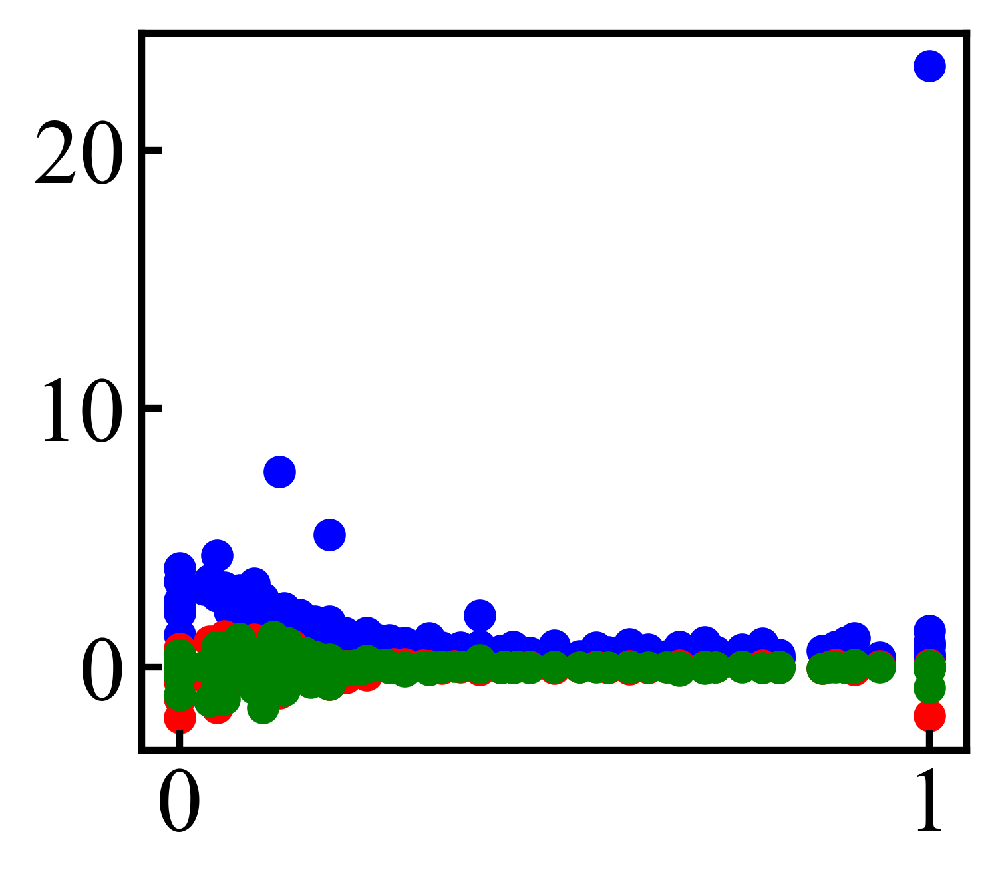

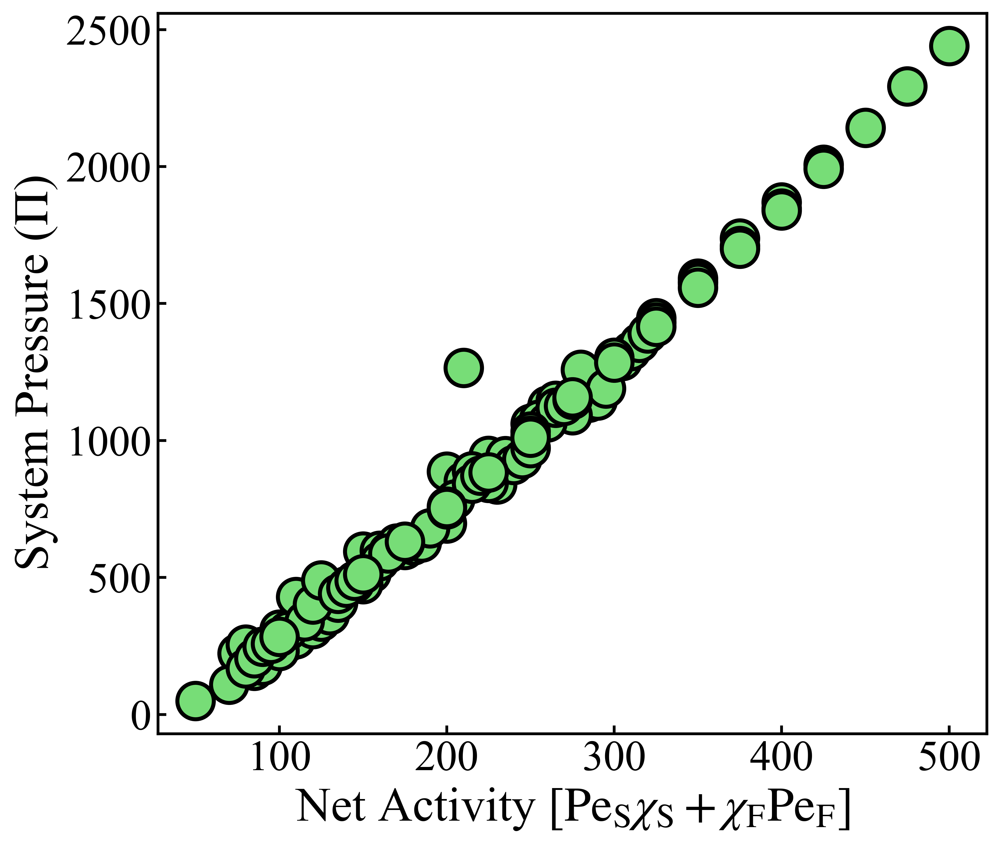

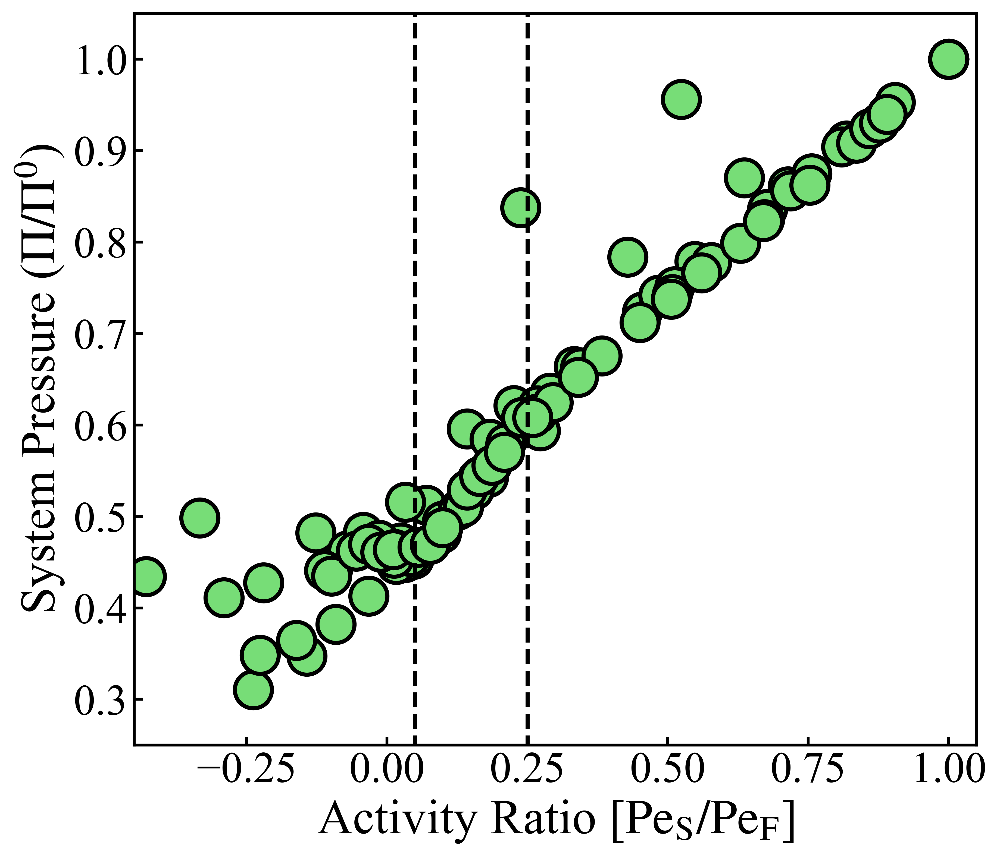

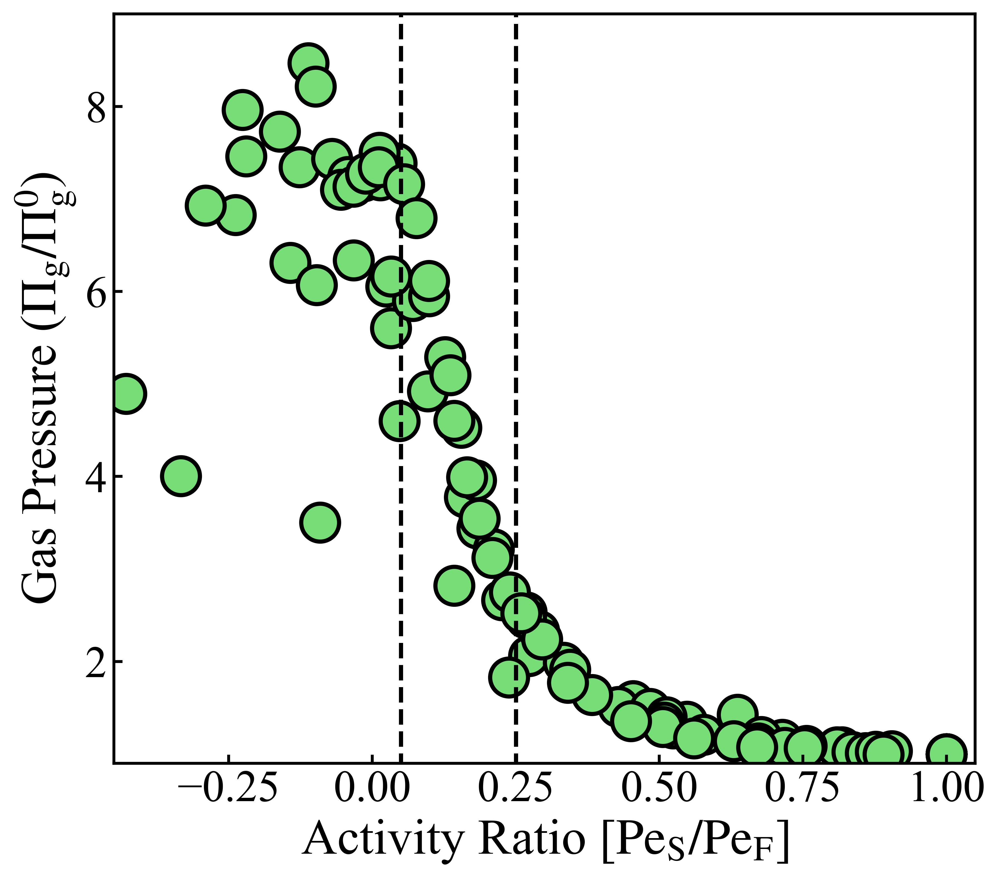

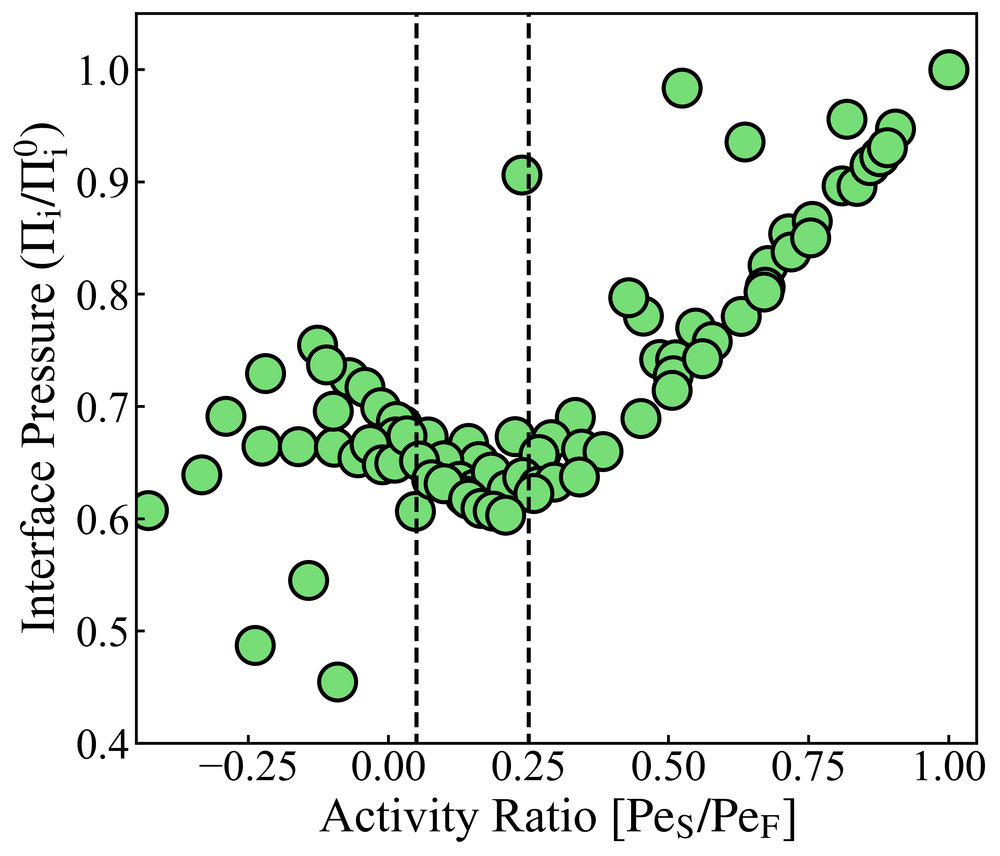

...

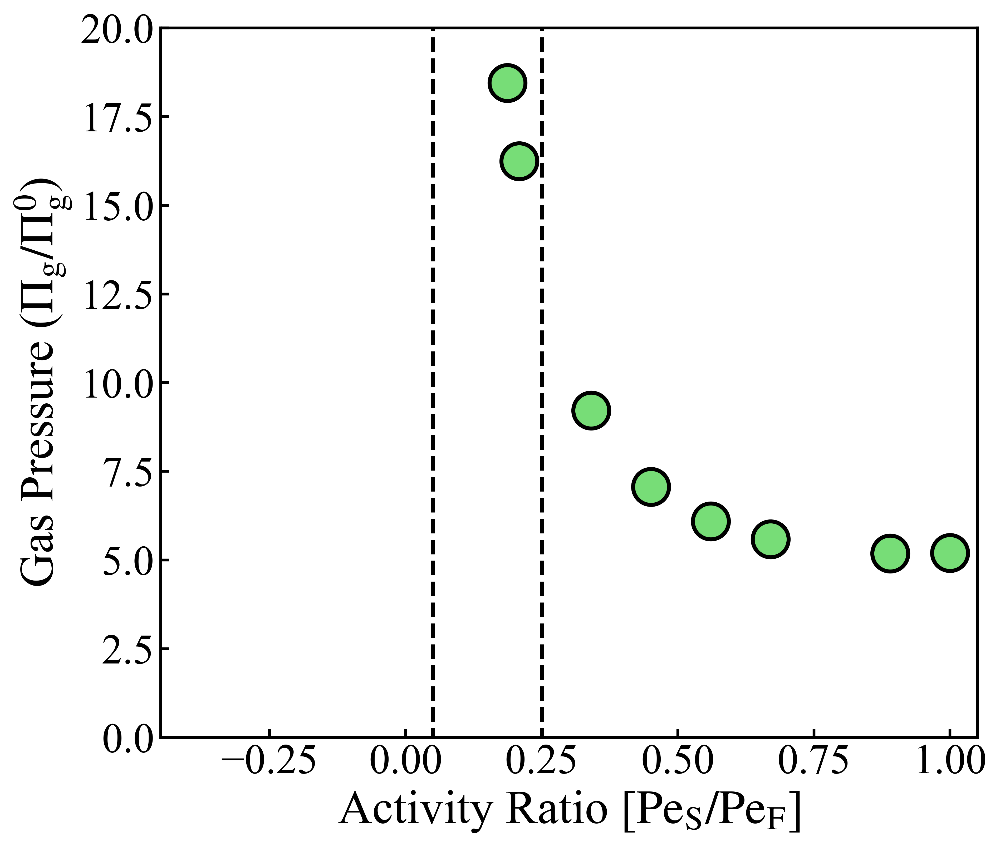

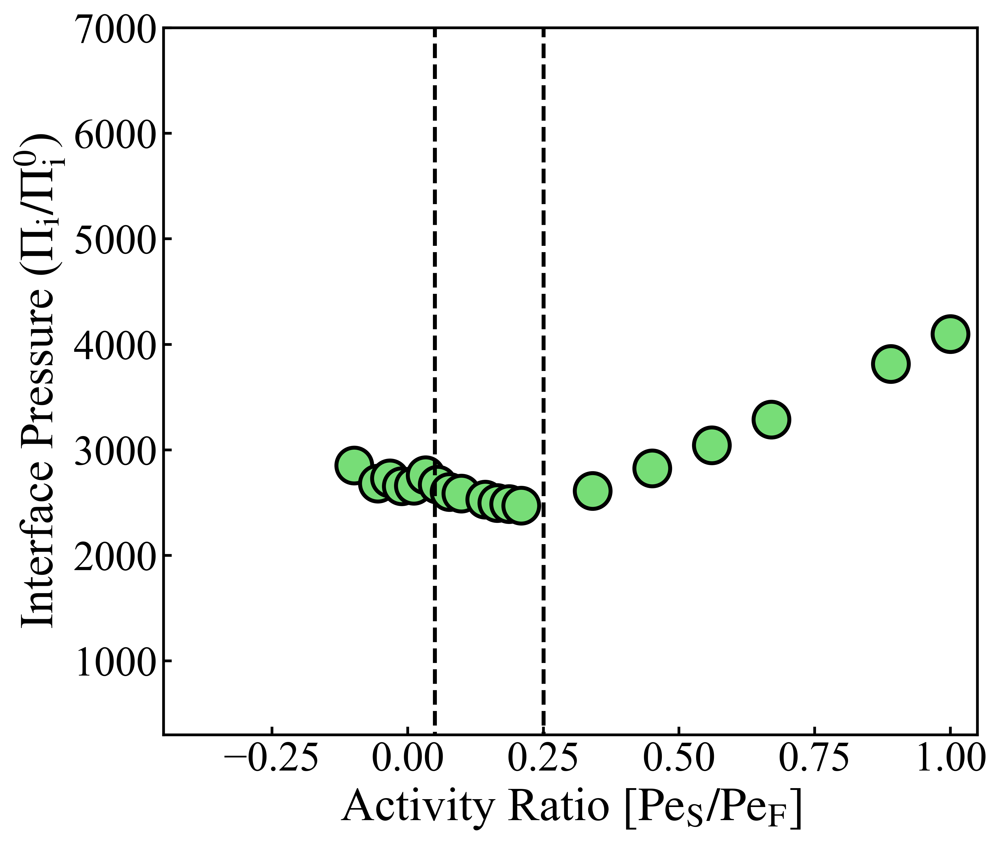

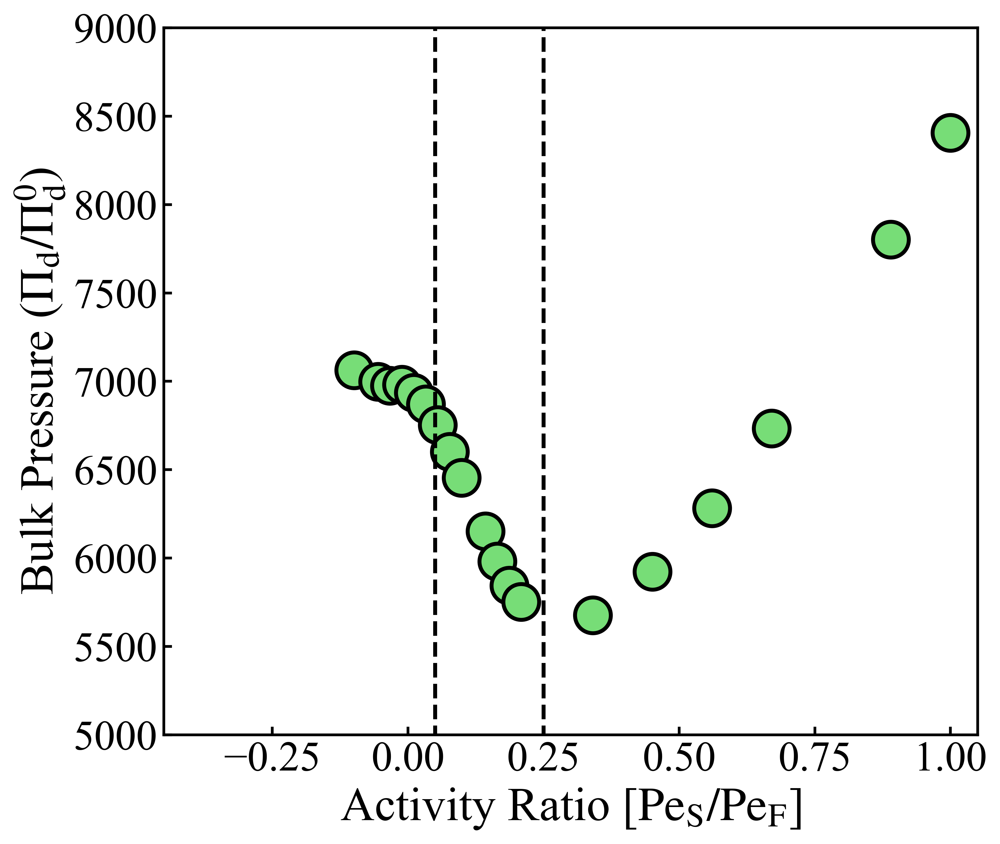

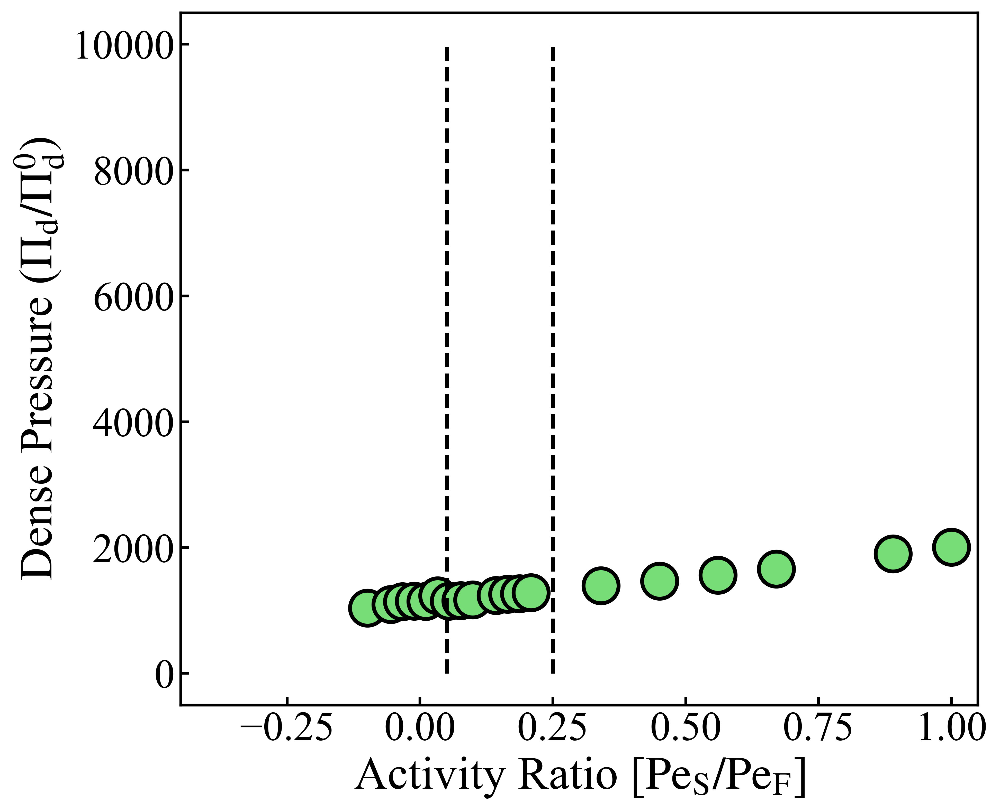

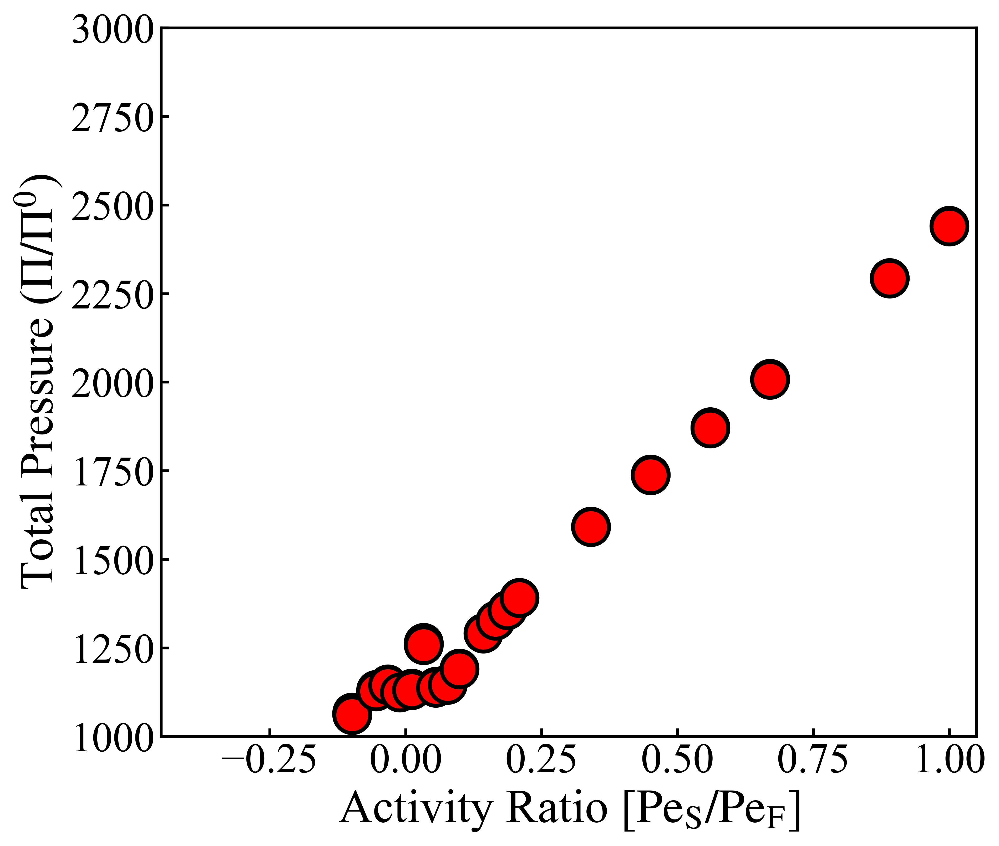

NameError: name 'stop' is not defined

In [162]:
plt.scatter(interpart_peA/interpart_peB, avg_total_r_arr, color='blue')
plt.scatter(interpart_peA/interpart_peB, avg_total_x_arr, color='red')
plt.scatter(interpart_peA/interpart_peB, avg_total_y_arr, color='green')
#plt.scatter(interpart_peA/interpart_peB, avg_no_desorb_r_arr)
#plt.scatter(interpart_peA/interpart_peB, avg_com_flux_r_arr)
#plt.ylim([-1, 1])
plt.show()
"""
fig = plt.figure(figsize=(7,8))
plt.scatter(interpart_peA/interpart_peB, dot_prod, color='blue')
#plt.scatter(interpart_peA/interpart_peB, avg_dif_r_arr)
#plt.scatter(interpart_peA/interpart_peB, avg_net_flux_r_arr, color='red')
#plt.scatter(interpart_peA/interpart_peB, avg_no_desorb_r_arr)
#plt.scatter(interpart_peA/interpart_peB, avg_com_flux_r_arr)
plt.ylim([-1.05, 1.05])
plt.ylabel(r'Flux correlated motion ($v_c \cdot k_\mathrm{net}$)')
plt.xlabel(r'Activity Ratio ($\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$)')
plt.show()
"""
fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")

plt.scatter((interpart_peA) * 0.5 + (interpart_peB) * 0.5, system_interpart_press, edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

#ax1.set_ylim([-1.05, 1.05])
#ax1.set_xlim([-0.05,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Net Activity [$\mathrm{Pe}_\mathrm{S}\chi_\mathrm{S}+\chi_\mathrm{F}\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'System Pressure ($\Pi$)', fontsize=fsize*2.6)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [0, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), system_interpart_press[test_id]/system_interpart_press[mono_id], edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )

plt.plot([0.05,0.05], [-5, 5], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
plt.plot([0.25,0.25], [-5, 5], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([0.25, 1.05])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'System Pressure ($\Pi/\Pi^0$)', fontsize=fsize*2.6)

plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [0, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), gas_interpart_press[test_id]/gas_interpart_press[mono_id], edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )
plt.plot([0.05,0.05], [-5, 10], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
plt.plot([0.25,0.25], [-5, 10], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([0.9, 9])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Gas Pressure ($\Pi_\mathrm{g}/\Pi_\mathrm{g}^0$)', fontsize=fsize*2.6)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [0, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), int_interpart_press[test_id]/int_interpart_press[mono_id], edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )
plt.plot([0.05,0.05], [-5, 10], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
plt.plot([0.25,0.25], [-5, 10], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([0.4, 1.05])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Interface Pressure ($\Pi_\mathrm{i}/\Pi_\mathrm{i}^0$)', fontsize=fsize*2.6)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [0, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), interpart_press[test_id]/interpart_press[mono_id], edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )
plt.plot([0.05,0.05], [-5, 5], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
plt.plot([0.25,0.25], [-5, 5], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([0.6, 1])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Bulk Pressure ($\Pi_\mathrm{d}/\Pi_\mathrm{d}^0$)', fontsize=fsize*2.6)

plt.show()











fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), system_interpart_press[test_id], edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )

plt.plot([0.05,0.05], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
plt.plot([0.25,0.25], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([1000, 3000])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'System Pressure ($\Pi/\Pi^0$)', fontsize=fsize*2.6)

plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), gas_interpart_press[test_id], edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )
plt.plot([0.05,0.05], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
plt.plot([0.25,0.25], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([0, 20])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Gas Pressure ($\Pi_\mathrm{g}/\Pi_\mathrm{g}^0$)', fontsize=fsize*2.6)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), int_interpart_press[test_id], edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )
plt.plot([0.05,0.05], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
plt.plot([0.25,0.25], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([300, 7000])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Interface Pressure ($\Pi_\mathrm{i}/\Pi_\mathrm{i}^0$)', fontsize=fsize*2.6)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), interpart_press[test_id], edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )
plt.plot([0.05,0.05], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
plt.plot([0.25,0.25], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([5000, 9000])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Bulk Pressure ($\Pi_\mathrm{d}/\Pi_\mathrm{d}^0$)', fontsize=fsize*2.6)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), dense_interpart_press[test_id]-int_interpart_press[test_id], edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )
plt.plot([0.05,0.05], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
plt.plot([0.25,0.25], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

#ax1.set_ylim([5000, 9000])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Dense Pressure ($\Pi_\mathrm{d}/\Pi_\mathrm{d}^0$)', fontsize=fsize*2.6)

plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
fast_arr_new = [500]
for i in fast_arr_new:
    test_id = np.where(interpart_peB==i)[0]
    mono_id = np.where((interpart_peB==i) & (interpart_peA==i))[0]
    if len(mono_id)==1:
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), (interpart_press[test_id] * avg_bulk_area[test_id] + int_interpart_press[test_id] * avg_int_area[test_id] + gas_interpart_press[test_id] * avg_gas_area[test_id])/(avg_gas_area[test_id]+avg_int_area[test_id]+avg_bulk_area[test_id]), edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )
        plt.scatter((interpart_peA[test_id]-45)/(interpart_peB[test_id]-45), system_interpart_press[test_id], edgecolor='black', facecolor='red', linewidth = 1.8*1.2, s=msz*55*0.7, )

#plt.plot([0.05,0.05], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')
#plt.plot([0.3,0.3], [-5, 10000], color='black', linestyle='dashed', linewidth = 1.8*1.2, label='Simulation')

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([1000, 3000])
ax1.set_xlim([-0.45,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Total Pressure ($\Pi/\Pi^0$)', fontsize=fsize*2.6)

plt.show()





stop
fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
plt.scatter((interpart_peA)/(interpart_peB), dot_prod, edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([-1.05, 1.05])
ax1.set_xlim([-0.05,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Flux correlated motion ($\overrightarrow{v}_c \cdot \overrightarrow{k}_\mathrm{net}$)', fontsize=fsize*2.6)

plt.show()


fig, ax1 = plt.subplots(figsize=(8,7))
msz=10
fsize=10
green = ("#77dd77")
plt.scatter((interpart_peA)/(interpart_peB), avg_total_r_arr, edgecolor='black', facecolor=green, linewidth = 1.8*1.2, s=msz*55*0.7, )

#plt.scatter(bulk_all_lat_time_mean[where_else4], interpart_press[where_else4], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.scatter(phi_bulk_sim[where_else4], carnahan)

ax1.set_ylim([0, 4.5])
ax1.set_xlim([-0.05,1.05])
ax1.tick_params(axis='x', labelsize=fsize*2.3)
ax1.tick_params(axis='y', labelsize=fsize*2.3)
ax1.set_xlabel(r'Activity Ratio [$\mathrm{Pe}_\mathrm{S}/\mathrm{Pe}_\mathrm{F}$]', fontsize=fsize*2.6)
#ax1.set_xlabel(r'Average Pair Force $\langle F^{pair} \rangle$', fontsize=fsize*2.6)
ax1.set_ylabel(r'Cluster Displacement ($|\overrightarrow{v}_c|$)', fontsize=fsize*2.6)

plt.show()

plt.scatter(interpart_peA/interpart_peB, dif_x, color='blue')
#plt.scatter(interpart_peA/interpart_peB, avg_dif_r_arr)
plt.scatter(interpart_peA/interpart_peB, dif_y, color='red')
#plt.scatter(interpart_peA/interpart_peB, avg_no_desorb_r_arr)
#plt.scatter(interpart_peA/interpart_peB, avg_net_flux_r_arr, c='pink')
plt.scatter(interpart_peA/interpart_peB, dif_r, c='purple')
plt.ylim([-2, 2])
plt.show()




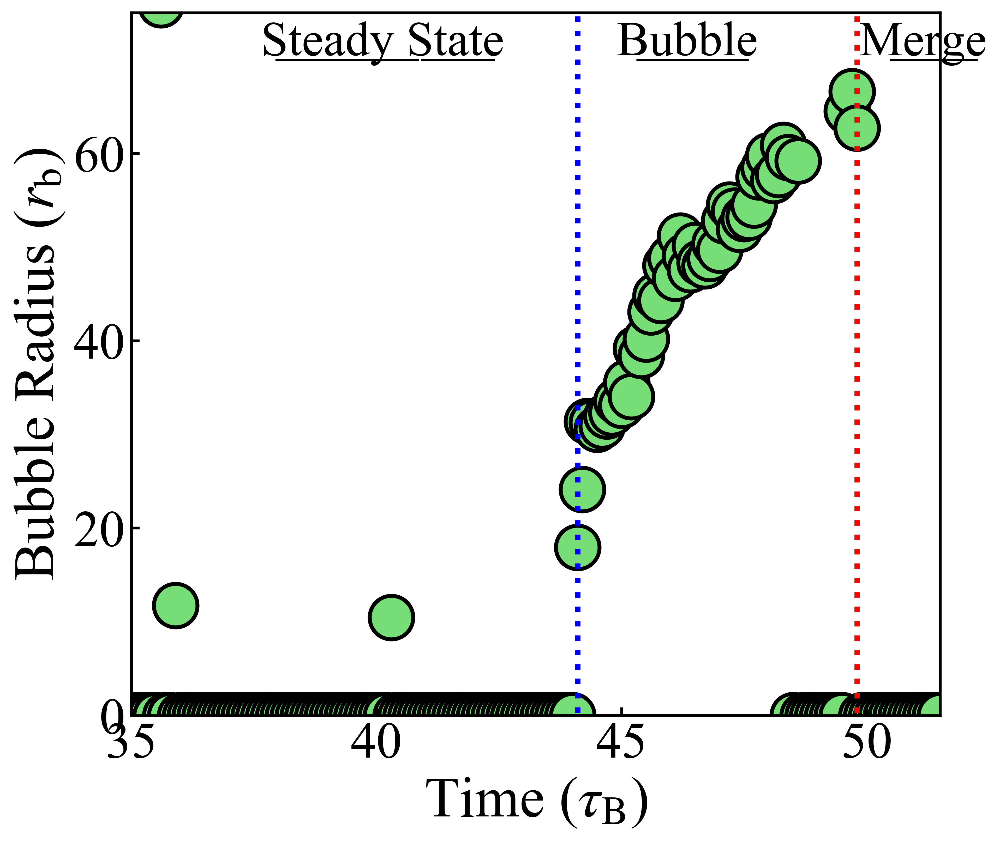

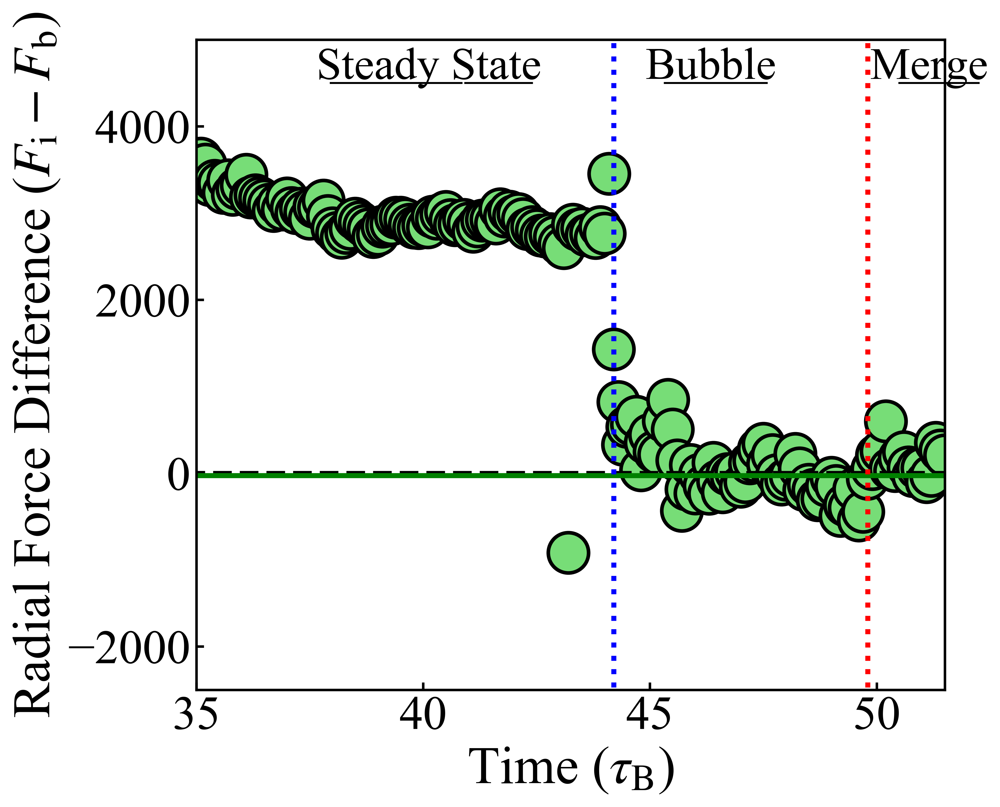

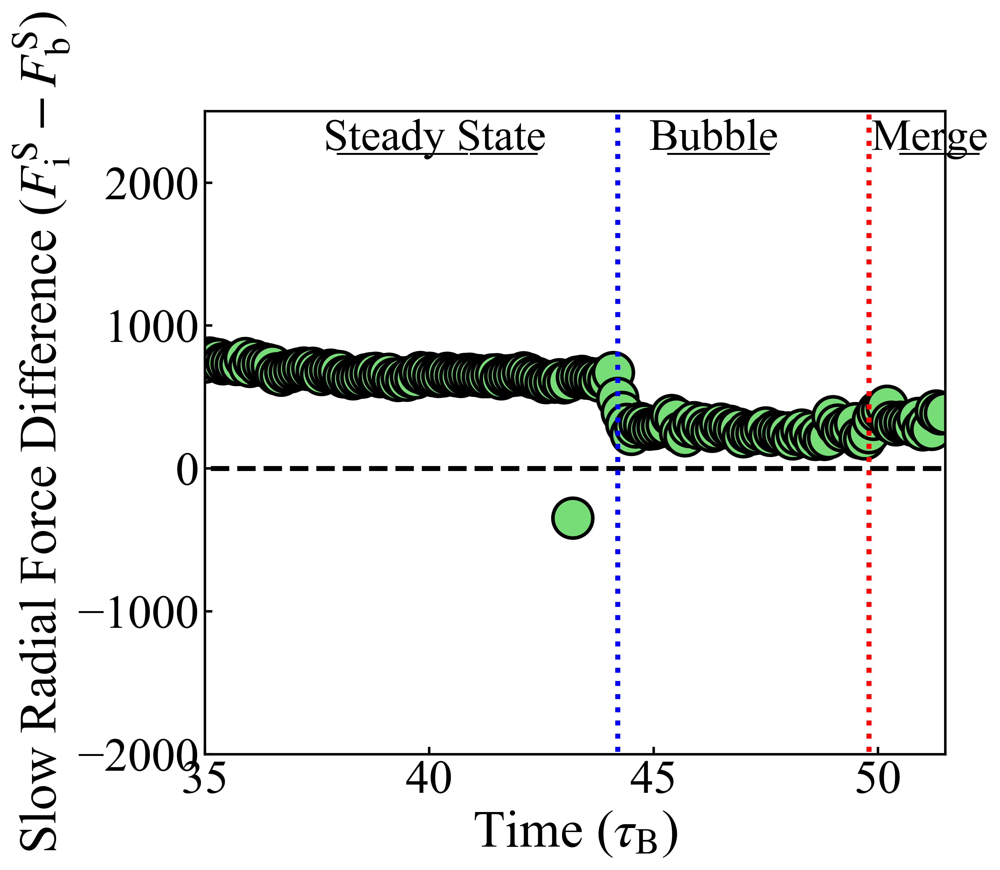

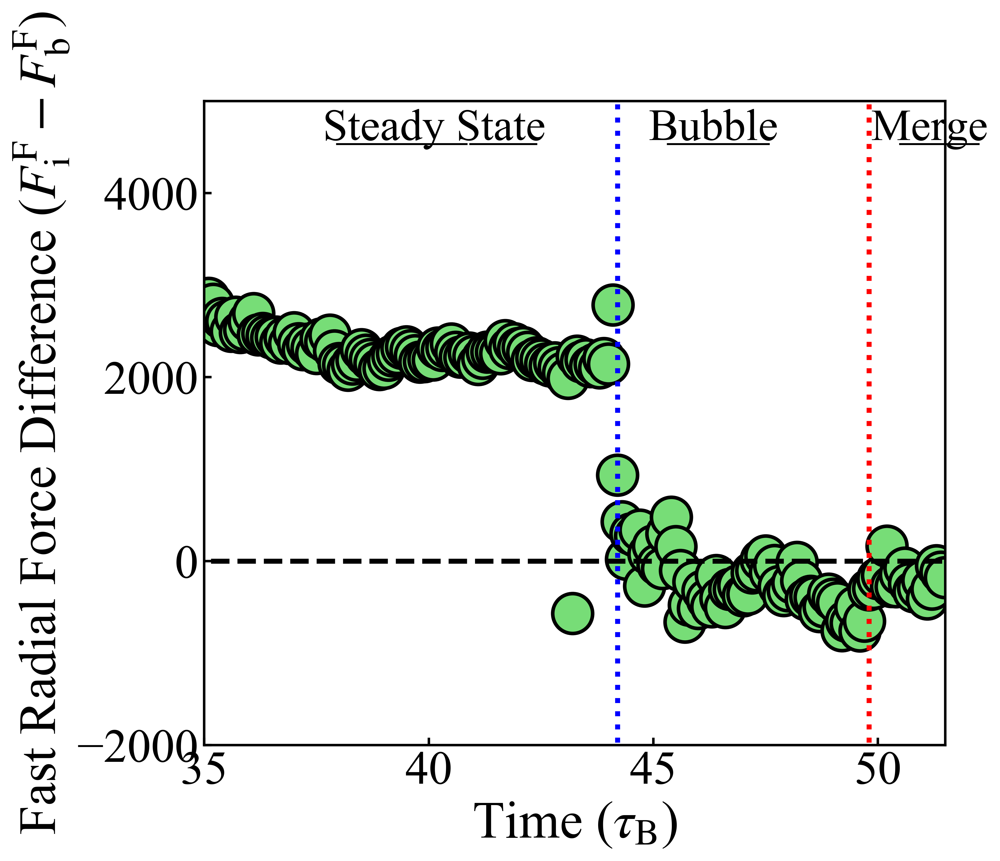

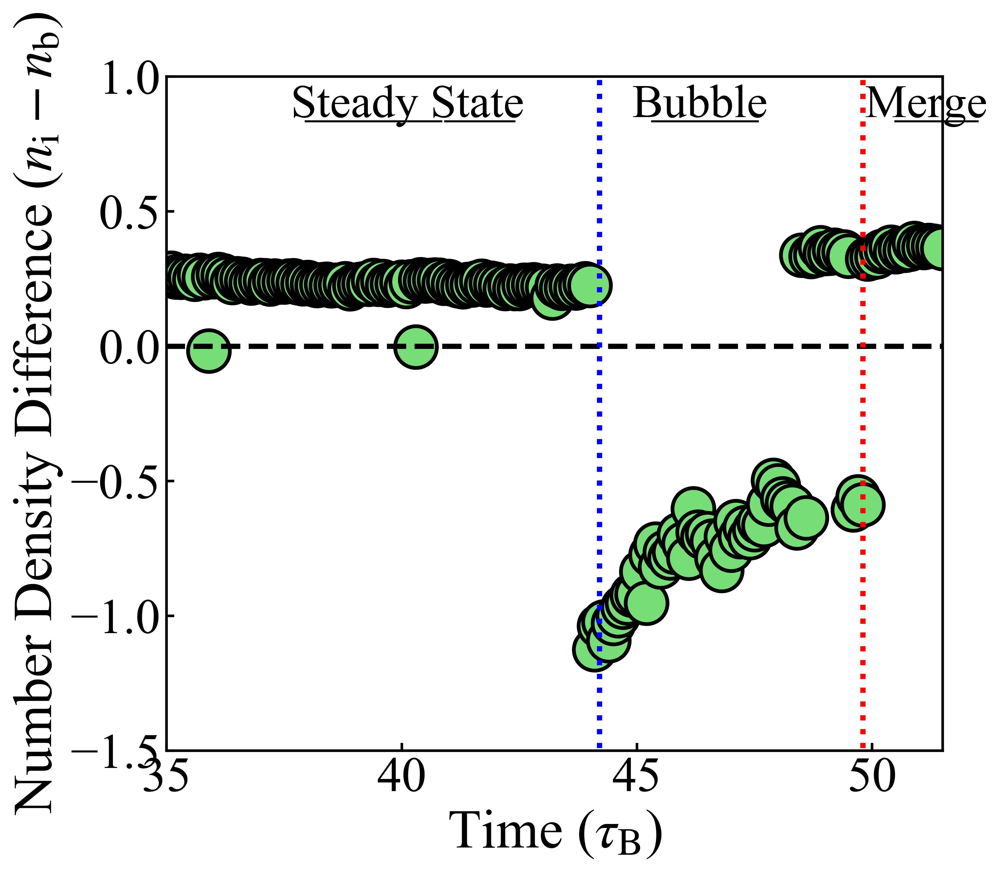

...

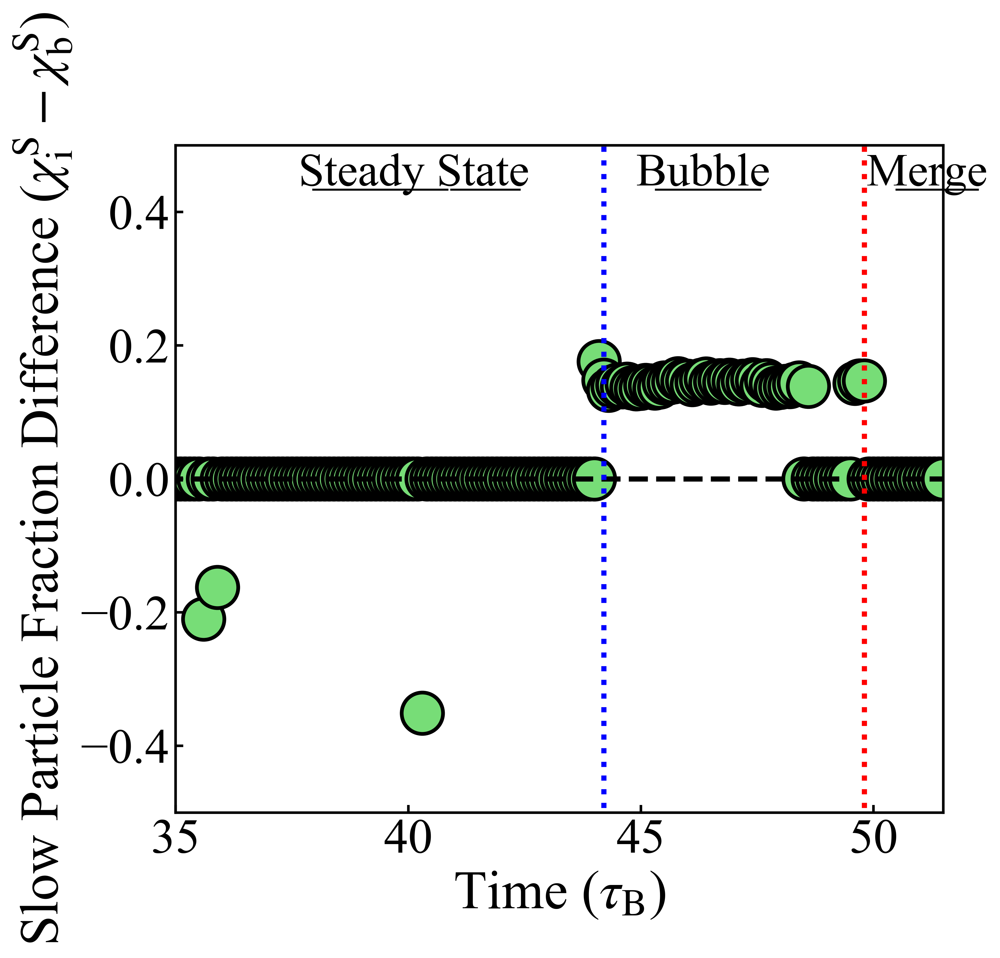

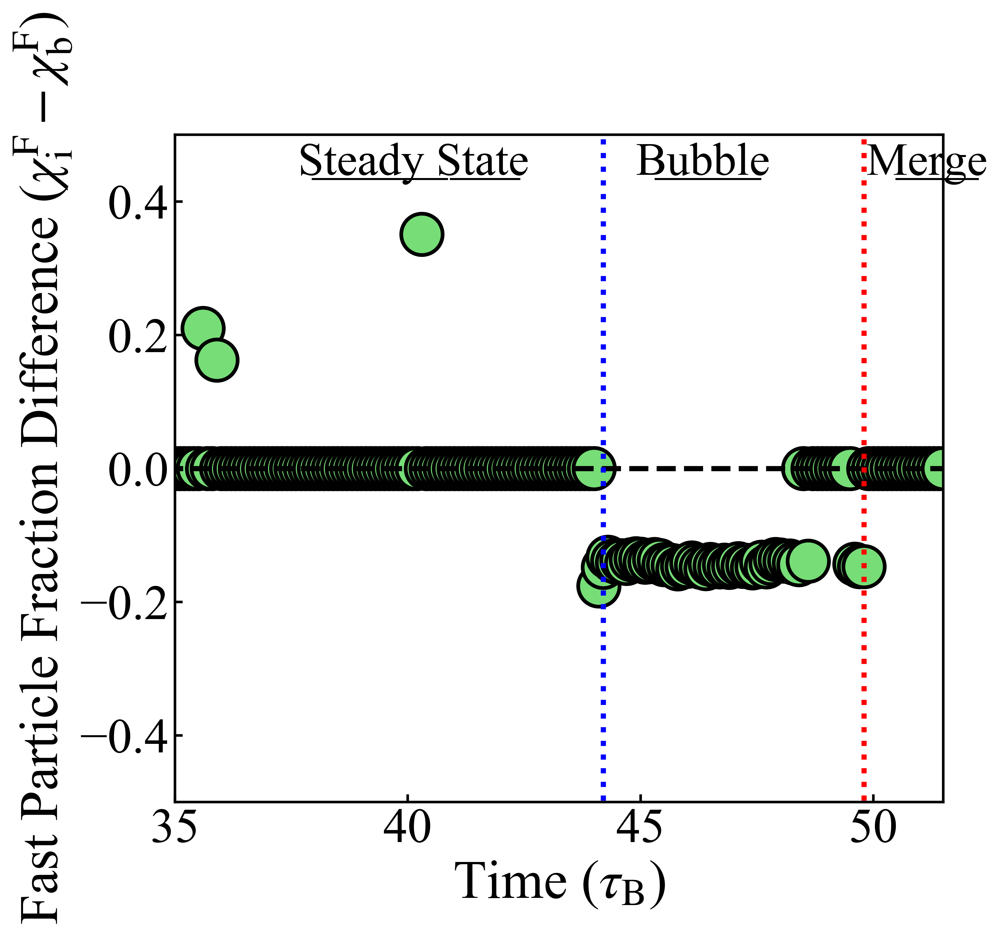

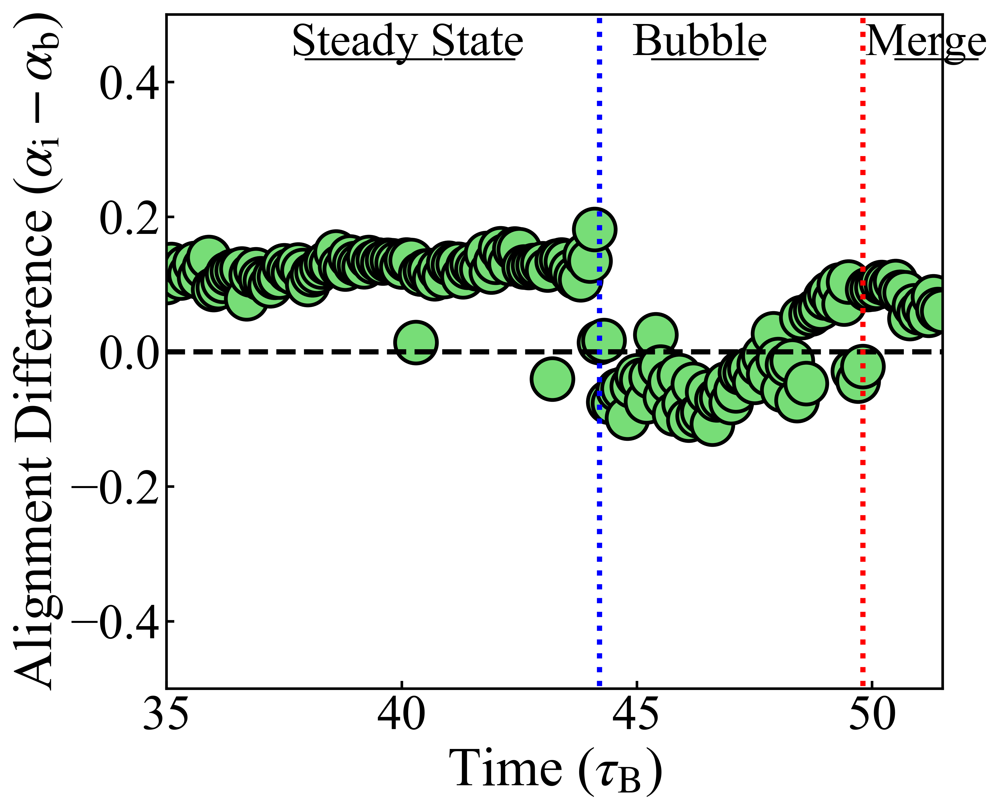

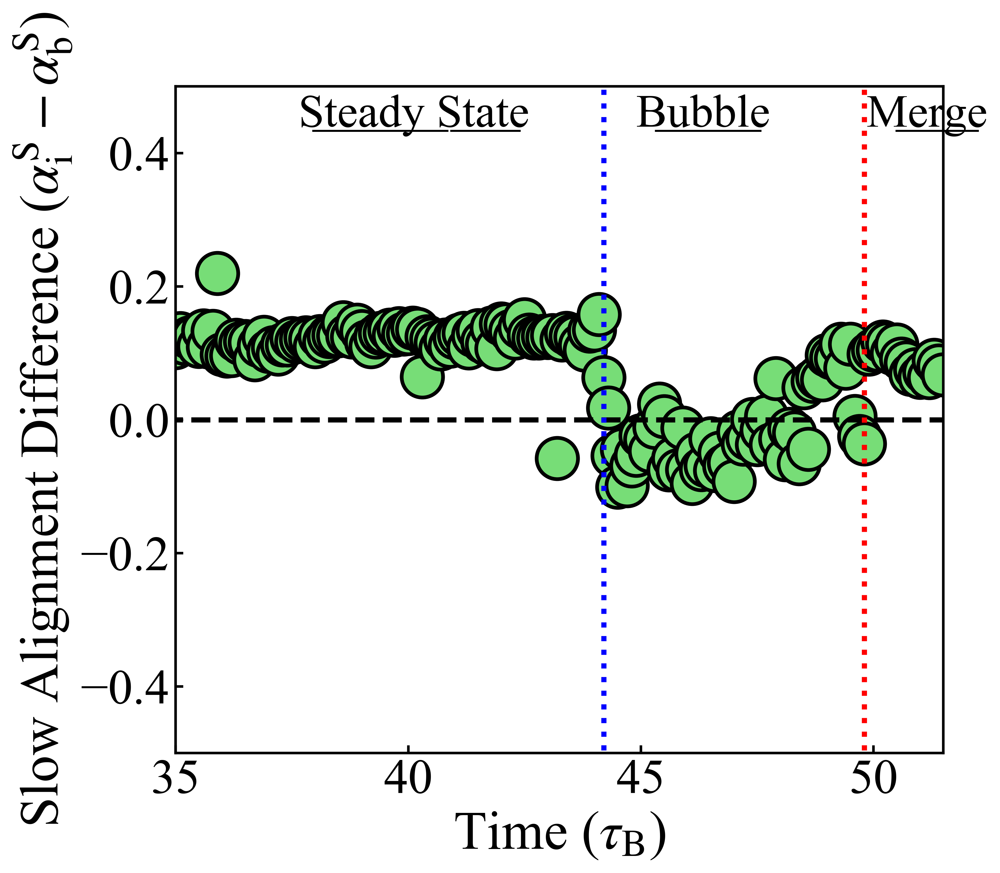

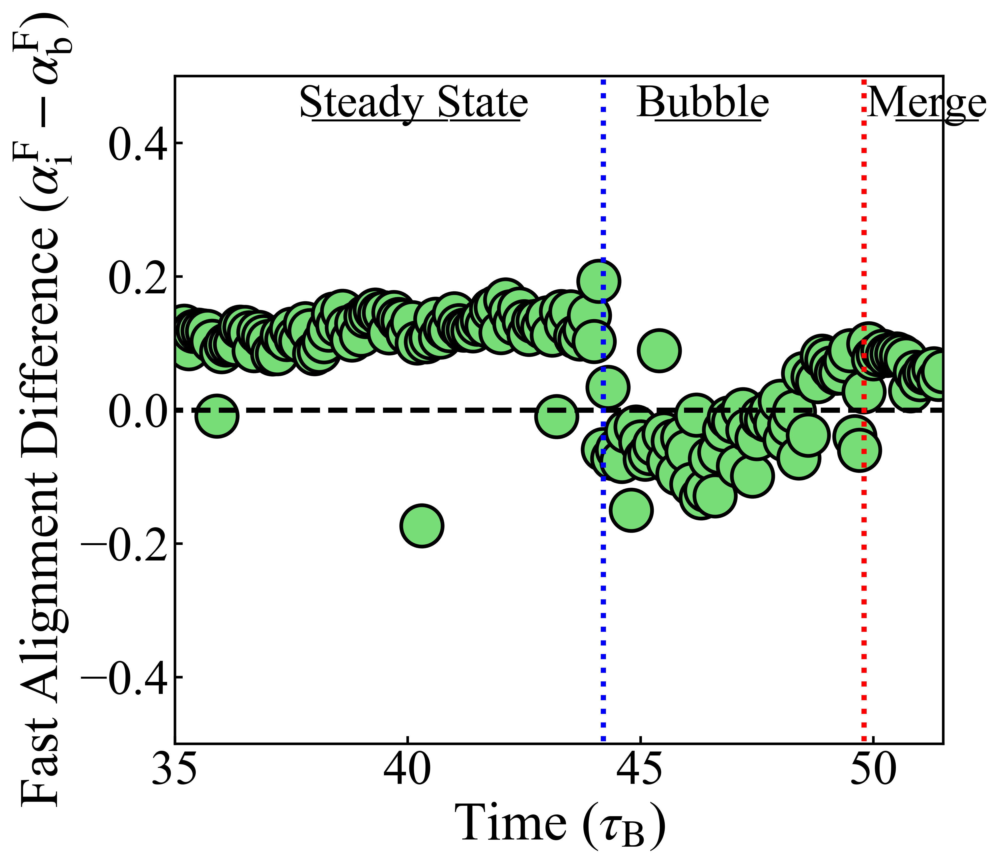

In [10]:
msz=15
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
green = ("#77dd77")
fsize=15

eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))



int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]


fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], (bub_area_arr[bub_time]/np.pi)**0.5, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

x_arr2 = np.array([44.1, 44.1])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)

x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([0, 75])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Bubble Radius ($r_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)



plt.show()

int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_tot_fa_arr[int_time]+bub_tot_fa_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)

int_time2 = np.where((int_time_arr>=45)& (int_time_arr<=49.8))[0]
bub_time2 = np.where((bub_time_arr>=45) & (bub_time_arr<=49.8))[0]
plt.plot(x_arr, [np.mean(int_tot_fa_arr[int_time2]+bub_tot_fa_arr[bub_time2]), np.mean(int_tot_fa_arr[int_time2]+bub_tot_fa_arr[bub_time2])], color='green', linewidth = 3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-2500, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Radial Force Difference ($F_\mathrm{i}-F_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()


int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_tot_faA_arr[int_time]+bub_tot_faA_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-2000, 2500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Radial Force Difference ($F_\mathrm{i}^\mathrm{S}-F_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()


int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_tot_faB_arr[int_time]+bub_tot_faB_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-2000, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Radial Force Difference ($F_\mathrm{i}^\mathrm{F}-F_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_num_dens_arr[int_time]-bub_num_dens_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-1.5, 1])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Number Density Difference ($n_\mathrm{i}-n_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_num_densA_arr[int_time]-bub_num_densA_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-1, 1])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Number Density Difference ($n_\mathrm{i}^\mathrm{S}-n_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_num_densB_arr[int_time]-bub_num_densB_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-1, 1])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Number Density Difference ($n_\mathrm{i}^\mathrm{F}-n_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

non_time = np.where((bub_num_dens_arr[bub_time]>0))[0]
non_time2 = np.where((bub_num_dens_arr[bub_time]==0))[0]
fig, ax1 = plt.subplots(figsize=(8,7))

plt.scatter(bub_time_arr[bub_time][non_time], int_num_densA_arr[int_time][non_time]/int_num_dens_arr[int_time][non_time]-bub_num_densA_arr[bub_time][non_time]/bub_num_dens_arr[bub_time][non_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(bub_time_arr[bub_time][non_time2], int_num_densA_arr[int_time][non_time2]/int_num_dens_arr[int_time][non_time2]-int_num_densA_arr[int_time][non_time2]/int_num_dens_arr[int_time][non_time2], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Particle Fraction Difference ($\chi_\mathrm{i}^\mathrm{S}-\chi_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time][non_time], int_num_densB_arr[int_time][non_time]/int_num_dens_arr[int_time][non_time]-bub_num_densB_arr[bub_time][non_time]/bub_num_dens_arr[bub_time][non_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(bub_time_arr[bub_time][non_time2], int_num_densB_arr[int_time][non_time2]/int_num_dens_arr[int_time][non_time2]-int_num_densB_arr[int_time][non_time2]/int_num_dens_arr[int_time][non_time2], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Particle Fraction Difference ($\chi_\mathrm{i}^\mathrm{F}-\chi_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_align_arr[int_time]+bub_align_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Alignment Difference ($\alpha_\mathrm{i}-\alpha_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_alignA_arr[int_time]+bub_alignA_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Alignment Difference ($\alpha_\mathrm{i}^\mathrm{S}-\alpha_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_alignB_arr[int_time]+bub_alignB_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Alignment Difference ($\alpha_\mathrm{i}^\mathrm{F}-\alpha_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()
